# PROJECT: How Twitter drives your Portfolio?
<br>
By: 
<br>
Venkata Pratheek Reddy Chavva
<br>
Sri Sai Kiran Reddy Gorla
<br>
Richa Reddy Edulakanti


# Introduction
Financial markets can be influenced and moved by many random factors. One such factor is Social media. Our big idea is to use data to find if social media could drive the financial market. We believed that Twitter is relatably authentic social media platform that generated such data which can be using with the data science techinques and find the relation between social media and financial markets. 
<br>
$\;\;\;\;\;\;$Initially our plan was to extract Twitter data using its native API. After working on this, we were hardbounded that the basic access level given by Twitter can only retreive data for the past one week which is not sufficient to conclude any results. Hence, we went ahead with a dataset from kaggle which had Twitter data for top 5 companies over 5 years(2015-2019).

Questions we are looking to answer are:
<br>
=> Does tweet volume on a company affect its trade volume?
<br>
=> Does tweet volume affect stock price of the company?
<br>
=> Does the sentiment of a company on twitter affect its stock price?


In [60]:
import matplotlib.pyplot as plt
import seaborn as sns; sns.set()
from matplotlib.colors import ListedColormap
from sklearn.metrics import confusion_matrix
import pandas as pd
import numpy as np
from sklearn import datasets, linear_model
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
from sklearn.metrics import classification_report
from sklearn import svm
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)


Initially importing the datasets

In [61]:
cpy_tweet = pd.read_csv('dataset/Company_Tweet.csv')
tweet = pd.read_csv('dataset/Tweet.csv')
company = pd.read_csv('dataset/Company.csv')


Exploring the datasets

In [62]:

company

,ticker_symbol,company_name
0,AAPL,apple
1,GOOG,Google Inc
2,GOOGL,Google Inc
3,AMZN,Amazon.com
4,TSLA,Tesla Inc
5,MSFT,Microsoft


In [63]:
tweet

,tweet_id,writer,post_date,body,comment_num,retweet_num,like_num
0,550441509175443456,VisualStockRSRC,1420070457,"lx21 made $10,008 on $AAPL -Check it out! htt...",0,0,1
1,550441672312512512,KeralaGuy77,1420070496,Insanity of today weirdo massive selling. $aap...,0,0,0
2,550441732014223360,DozenStocks,1420070510,S&P100 #Stocks Performance $HD $LOW $SBUX $TGT...,0,0,0
3,550442977802207232,ShowDreamCar,1420070807,$GM $TSLA: Volkswagen Pushes 2014 Record Recal...,0,0,1
4,550443807834402816,i_Know_First,1420071005,Swing Trading: Up To 8.91% Return In 14 Days h...,0,0,1
...,...,...,...,...,...,...,...
3717959,1212159765914079234,TEEELAZER,1577836383,That $SPY $SPX puuump in the last hour was the...,1,0,6
3717960,1212159838882533376,ShortingIsFun,1577836401,In 2020 I may start Tweeting out positive news...,0,0,1
3717961,1212160015332728833,Commuternyc,1577836443,Patiently Waiting for the no twitter sitter tw...,0,0,5
3717962,1212160410692046849,MoriaCrypto,1577836537,I don't discriminate. I own both $aapl and $ms...,1,0,1


In [64]:
tweet.isna().sum()

tweet_id           0
writer         47273
post_date          0
body               0
comment_num        0
retweet_num        0
like_num           0
dtype: int64

In [65]:
cpy_tweet

,tweet_id,ticker_symbol
0,550803612197457920,AAPL
1,550803610825928706,AAPL
2,550803225113157632,AAPL
3,550802957370159104,AAPL
4,550802855129382912,AAPL
...,...,...
4336440,1212158772015034369,TSLA
4336441,1212159099632267268,TSLA
4336442,1212159184931717120,TSLA
4336443,1212159838882533376,TSLA


Merging the company tweets and tweets dataframes based on tweet id

In [66]:
tweets = pd.merge(tweet,cpy_tweet,on='tweet_id',how='inner')
tweets.head()

,tweet_id,writer,post_date,body,comment_num,retweet_num,like_num,ticker_symbol
0,550441509175443456,VisualStockRSRC,1420070457,"lx21 made $10,008 on $AAPL -Check it out! htt...",0,0,1,AAPL
1,550441672312512512,KeralaGuy77,1420070496,Insanity of today weirdo massive selling. $aap...,0,0,0,AAPL
2,550441732014223360,DozenStocks,1420070510,S&P100 #Stocks Performance $HD $LOW $SBUX $TGT...,0,0,0,AMZN
3,550442977802207232,ShowDreamCar,1420070807,$GM $TSLA: Volkswagen Pushes 2014 Record Recal...,0,0,1,TSLA
4,550443807834402816,i_Know_First,1420071005,Swing Trading: Up To 8.91% Return In 14 Days h...,0,0,1,AAPL


In [67]:
tweets['post_date'] = pd.to_datetime(tweets['post_date'], unit='s')
tweets.tail()


,tweet_id,writer,post_date,body,comment_num,retweet_num,like_num,ticker_symbol
4336440,1212159838882533376,ShortingIsFun,2019-12-31 23:53:21,In 2020 I may start Tweeting out positive news...,0,0,1,TSLA
4336441,1212160015332728833,Commuternyc,2019-12-31 23:54:03,Patiently Waiting for the no twitter sitter tw...,0,0,5,TSLA
4336442,1212160410692046849,MoriaCrypto,2019-12-31 23:55:37,I don't discriminate. I own both $aapl and $ms...,1,0,1,AAPL
4336443,1212160410692046849,MoriaCrypto,2019-12-31 23:55:37,I don't discriminate. I own both $aapl and $ms...,1,0,1,MSFT
4336444,1212160477159206912,treabase,2019-12-31 23:55:53,"$AAPL #patent 10,522,475 Vertical interconnect...",0,0,0,AAPL


Creating a separate dataframe for each company using their ticker symbol

In [68]:
tweet_amazon = tweets[tweets['ticker_symbol']=='AMZN']
tweet_apple = tweets[tweets['ticker_symbol']=='AAPL']
tweet_tesla = tweets[tweets['ticker_symbol']=='TSLA']
tweet_microsoft = tweets[tweets['ticker_symbol']=='MSFT']
tweet_google = tweets[(tweets['ticker_symbol']=='GOOG') | (tweets['ticker_symbol']=='GOOGL')]


# Data Cleaning
Since the dataset is from kaggle, there were no null values except in the the author column. Since this column is not required for the analysis, we'll be dropping it.

Extracting tweets based on timeline. Initially, we tried to use 3 years of data but the sentimental analysis took a long time to run. Hence, after trying multiple time periods, we have decided to use the last 6 months in the dataset

In [69]:
def time_mask(df):
    mask = (df['post_date'] > '2019-7-1') & (df['post_date'] <= '2019-12-31')
    df = df.loc[mask]
    return df
    

tweet_amazon = time_mask(tweet_amazon)
tweet_apple = time_mask(tweet_apple)
tweet_google = time_mask(tweet_google)
tweet_microsoft = time_mask(tweet_microsoft)
tweet_tesla = time_mask(tweet_tesla)

Changing post_date column to date column

In [70]:
tweet_amazon.rename(columns={'post_date': 'Date'}, inplace=True)
tweet_apple.rename(columns={'post_date': 'Date'}, inplace=True)
tweet_google.rename(columns={'post_date': 'Date'}, inplace=True)
tweet_microsoft.rename(columns={'post_date': 'Date'}, inplace=True)
tweet_tesla.rename(columns={'post_date': 'Date'}, inplace=True)

tweet_amazon['Date'] = pd.to_datetime(tweet_amazon['Date']).dt.date
tweet_apple['Date'] = pd.to_datetime(tweet_apple['Date']).dt.date
tweet_google['Date'] = pd.to_datetime(tweet_google['Date']).dt.date
tweet_microsoft['Date'] = pd.to_datetime(tweet_microsoft['Date']).dt.date
tweet_tesla['Date'] = pd.to_datetime(tweet_tesla['Date']).dt.date


In [71]:
#tweet_amazon.to_csv('dataset/EDA_amazon_tweets.csv')
#tweet_apple.to_csv('dataset/EDA_tesla_tweets.csv')
#tweet_google.to_csv('dataset/EDA_microsoft_tweets.csv')
#tweet_microsoft.to_csv('dataset/EDA_google_tweets.csv')
#tweet_tesla.to_csv('dataset/EDA_apple_tweets.csv')

In [72]:
tweet_amazon.head(20)

,tweet_id,writer,Date,body,comment_num,retweet_num,like_num,ticker_symbol
3935144,1145483574717497344,muckdog,2019-07-01,Had an interesting conversation with friends y...,0,1,0,AMZN
3935153,1145485860021792768,EliteOptions2,2019-07-01,$NVDA - Trade Idea - July 5th 170C - bid/ask: ...,2,2,14,AMZN
3935162,1145487616004874241,EliteOptions2,2019-07-01,$BABA - Trade Idea - July 5th 172.50C - bid/as...,1,3,18,AMZN
3935169,1145488552710430720,EliteOptions2,2019-07-01,Two Day Risk-Free Trial Join us tonight (9PM E...,1,1,1,AMZN
3935178,1145489717045207041,ExactOptionPick,2019-07-01,ACTIVE TRADERS Try one of these FREE trading g...,0,0,0,AMZN
3935185,1145490210001752065,Trading_Analyst,2019-07-01,[WATCH] Thoughts On The Market To Help You Mak...,0,1,0,AMZN
3935192,1145492061405081601,BoogDmc,2019-07-01,$AMZN- position,0,1,0,AMZN
3935198,1145494084393586695,mikeo188,2019-07-01,"$ES $ES_F $SPX $3,000 or else the 4th of July ...",0,2,3,AMZN
3935206,1145496736556826624,luke_sosnowski,2019-07-01,Market traders give Revolution Swing from #TRI...,1,3,11,AMZN
3935216,1145501346835193856,DentonBlackwell,2019-07-01,$AMZN eat a dick shorts,0,1,1,AMZN


While exploring the tweets, we can find many tweets are by bot accounts. These tweets don't add any meaning to sentiment analysis. Below is a function to remove bot related tweets. We have selected bot phrases by researching online from multiple projects and combined the most common phrases.

In [73]:
def bot_t(text, bot):
    text = text.lower()
    for phrase in bot:
        if phrase in text:
            return True
    return False

bot_phrases = ['for immediate prints', 'sec alert', '1 minute', 
        '#options', 'organizations in our database'
        'by the market closing on the same day', 'technical alerts', 
        'new alert', 'chatroom', 'trade alert',
        'if you are familiar with print ', 
        'view odds for this', '15s. delayed', 'tradewithalerts','closing price of alert',
      'index','alert','delayed']

In [74]:
filtered_amazon_tweets_df = tweet_amazon.loc[tweet_amazon.body.apply(lambda text: not bot_t(text, bot_phrases))]
filtered_tesla_tweets_df = tweet_tesla.loc[tweet_tesla.body.apply(lambda text: not bot_t(text, bot_phrases))]
filtered_microsoft_tweets_df = tweet_microsoft.loc[tweet_microsoft.body.apply(lambda text: not bot_t(text, bot_phrases))]
filtered_google_tweets_df = tweet_google.loc[tweet_google.body.apply(lambda text: not bot_t(text, bot_phrases))]
filtered_apple_tweets_df = tweet_apple.loc[tweet_apple.body.apply(lambda text: not bot_t(text, bot_phrases))]

Since there are multiple tweets about same company on a given date, we'll be combining all tweets on same date by grouping and concating them.

In [75]:
filtered_amazon_tweets_df['body'] = filtered_amazon_tweets_df.groupby(['Date'])['body'].transform(lambda x : ' '.join(x))
filtered_tesla_tweets_df['body'] = filtered_tesla_tweets_df.groupby(['Date'])['body'].transform(lambda x : ' '.join(x))
filtered_microsoft_tweets_df['body'] = filtered_microsoft_tweets_df.groupby(['Date'])['body'].transform(lambda x : ' '.join(x))
filtered_google_tweets_df['body'] = filtered_google_tweets_df.groupby(['Date'])['body'].transform(lambda x : ' '.join(x))
filtered_apple_tweets_df['body'] = filtered_apple_tweets_df.groupby(['Date'])['body'].transform(lambda x : ' '.join(x))

/var/folders/st/kzrf9tws3l3173mvf544yxh40000gn/T/ipykernel_27191/2664549400.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_amazon_tweets_df['body'] = filtered_amazon_tweets_df.groupby(['Date'])['body'].transform(lambda x : ' '.join(x))
/var/folders/st/kzrf9tws3l3173mvf544yxh40000gn/T/ipykernel_27191/2664549400.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_tesla_tweets_df['body'] = filtered_tesla_tweets_df.groupby(['Date'])['body'].transform(lambda x : ' '.join(x))
/var/folders/s

In [76]:
filtered_apple_tweets_df = filtered_apple_tweets_df.drop_duplicates(subset='Date', keep="first")
filtered_tesla_tweets_df = filtered_tesla_tweets_df.drop_duplicates(subset='Date', keep="first")
filtered_microsoft_tweets_df = filtered_microsoft_tweets_df.drop_duplicates(subset='Date', keep="first")
filtered_google_tweets_df = filtered_google_tweets_df.drop_duplicates(subset='Date', keep="first")
filtered_amazon_tweets_df = filtered_amazon_tweets_df.drop_duplicates(subset='Date', keep="first")

There are lot of unwanted symbols in the tweets which will not be used in sentiment analysis. Hence, we will be removing these symbols.

In [77]:
import re
def remove_pattern(input_txt, pattern):
    r = re.findall(pattern, input_txt)
    for i in r:
        input_txt = re.sub(i, '', input_txt)   
    return input_txt    

filtered_apple_tweets_df['tidy_tweet'] = np.vectorize(remove_pattern)(filtered_apple_tweets_df['body'], "@[\w]*")
filtered_apple_tweets_df['tidy_tweet'] = filtered_apple_tweets_df['tidy_tweet'].str.replace("[^a-zA-Z#]", " ")
filtered_apple_tweets_df['tidy_tweet'] = filtered_apple_tweets_df['tidy_tweet'].apply(lambda x: ' '.join([w for w in x.split() if len(w)>3]))

filtered_tesla_tweets_df['tidy_tweet'] = np.vectorize(remove_pattern)(filtered_tesla_tweets_df['body'], "@[\w]*")
filtered_tesla_tweets_df['tidy_tweet'] = filtered_tesla_tweets_df['tidy_tweet'].str.replace("[^a-zA-Z#]", " ")
filtered_tesla_tweets_df['tidy_tweet'] = filtered_tesla_tweets_df['tidy_tweet'].apply(lambda x: ' '.join([w for w in x.split() if len(w)>3]))

filtered_microsoft_tweets_df['tidy_tweet'] = np.vectorize(remove_pattern)(filtered_microsoft_tweets_df['body'], "@[\w]*")
filtered_microsoft_tweets_df['tidy_tweet'] = filtered_microsoft_tweets_df['tidy_tweet'].str.replace("[^a-zA-Z#]", " ")
filtered_microsoft_tweets_df['tidy_tweet'] = filtered_microsoft_tweets_df['tidy_tweet'].apply(lambda x: ' '.join([w for w in x.split() if len(w)>3]))

filtered_google_tweets_df['tidy_tweet'] = np.vectorize(remove_pattern)(filtered_google_tweets_df['body'], "@[\w]*")
filtered_google_tweets_df['tidy_tweet'] = filtered_google_tweets_df['tidy_tweet'].str.replace("[^a-zA-Z#]", " ")
filtered_google_tweets_df['tidy_tweet'] = filtered_google_tweets_df['tidy_tweet'].apply(lambda x: ' '.join([w for w in x.split() if len(w)>3]))

filtered_amazon_tweets_df['tidy_tweet'] = np.vectorize(remove_pattern)(filtered_amazon_tweets_df['body'], "@[\w]*")
filtered_amazon_tweets_df['tidy_tweet'] = filtered_amazon_tweets_df['tidy_tweet'].str.replace("[^a-zA-Z#]", " ")
filtered_amazon_tweets_df['tidy_tweet'] = filtered_amazon_tweets_df['tidy_tweet'].apply(lambda x: ' '.join([w for w in x.split() if len(w)>3]))

/var/folders/st/kzrf9tws3l3173mvf544yxh40000gn/T/ipykernel_27191/1822152301.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_apple_tweets_df['tidy_tweet'] = np.vectorize(remove_pattern)(filtered_apple_tweets_df['body'], "@[\w]*")
/var/folders/st/kzrf9tws3l3173mvf544yxh40000gn/T/ipykernel_27191/1822152301.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_apple_tweets_df['tidy_tweet'] = filtered_apple_tweets_df['tidy_tweet'].str.replace("[^a-zA-Z#]", " ")
/var/folders/st/kzrf9tws3l3173m

Saving the cleaned dataset into csv files for EDA

In [78]:
#filtered_amazon_tweets_df.to_csv('dataset/filtered_amazon_tweets.csv')
#filtered_tesla_tweets_df.to_csv('dataset/filtered_tesla_tweets.csv')
#filtered_microsoft_tweets_df.to_csv('dataset/filtered_microsoft_tweets.csv')
#filtered_google_tweets_df.to_csv('dataset/filtered_google_tweets.csv')
#filtered_apple_tweets_df.to_csv('dataset/filtered_apple_tweets.csv')

Combining all filtered tweets into one dataframe and saving it into csv file

In [79]:
filtered_tweets_df = pd.concat([filtered_amazon_tweets_df,filtered_tesla_tweets_df,filtered_microsoft_tweets_df,
                                filtered_google_tweets_df,filtered_apple_tweets_df],axis=0)
#filtered_tweets_df.to_csv('dataset/filtered_tweets.csv')

In [429]:
filtered_tweets_df = filtered_tweets_df.drop('tweet_id', axis=1)
filtered_tweets_df = filtered_tweets_df.drop('writer', axis=1)

In [430]:
filtered_tweets_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 915 entries, 3935144 to 4330579
Data columns (total 7 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   Date           915 non-null    object
 1   body           915 non-null    object
 2   comment_num    915 non-null    int64 
 3   retweet_num    915 non-null    int64 
 4   like_num       915 non-null    int64 
 5   ticker_symbol  915 non-null    object
 6   tidy_tweet     915 non-null    object
dtypes: int64(3), object(4)
memory usage: 57.2+ KB


In [80]:
import pandas_datareader as web
import datetime as dt

start = dt.datetime(2019,7,1)
end = dt.datetime(2019,12,31)

amzn_stock = web.DataReader('AMZN', 'yahoo', start, end)
amzn_stock = amzn_stock.reset_index()
tesla_stock = web.DataReader('TSLA', 'yahoo', start, end)
tesla_stock = tesla_stock.reset_index()
google_stock = web.DataReader('GOOGL', 'yahoo', start, end)
google_stock = google_stock.reset_index()
microsoft_stock = web.DataReader('MSFT', 'yahoo', start, end)
microsoft_stock = microsoft_stock.reset_index()
apple_stock = web.DataReader('AAPL', 'yahoo', start, end)
apple_stock = apple_stock.reset_index()
amzn_stock.head()

,Date,High,Low,Open,Close,Volume,Adj Close
0,2019-07-01,96.490997,95.733002,96.149002,96.109497,63842000,96.109497
1,2019-07-02,96.739502,95.331497,95.969002,96.715500,52918000,96.715500
2,2019-07-03,97.079498,96.525002,96.794502,96.949997,33806000,96.949997
3,2019-07-05,97.294998,96.264999,96.430000,97.145500,52568000,97.145500
4,2019-07-08,97.800003,96.412498,96.706001,97.615997,57668000,97.615997


Converting datetime column to time on stock price dataframe

In [81]:
amzn_stock['Date'] = pd.to_datetime(amzn_stock['Date']).dt.date
tesla_stock['Date'] = pd.to_datetime(tesla_stock['Date']).dt.date
google_stock['Date'] = pd.to_datetime(google_stock['Date']).dt.date
microsoft_stock['Date'] = pd.to_datetime(microsoft_stock['Date']).dt.date
apple_stock['Date'] = pd.to_datetime(apple_stock['Date']).dt.date

We have performed three steps of data cleaning on the tweet dataset which are dropping the columns, removing the bot tweets and removing the unwanted symbols from tweets. Below is the data set after cleaning the data. The change in the data set after cleaning it is huge as we combined all the tweets in a day into one row. This was done as we will be computing the sentiment score for all the tweets on a day and using to find the relation between the stock price and twitter data. But for EDA, we will be using the dataset without combing the tweets.

In [432]:
filtered_tweets_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 915 entries, 3935144 to 4330579
Data columns (total 7 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   Date           915 non-null    object
 1   body           915 non-null    object
 2   comment_num    915 non-null    int64 
 3   retweet_num    915 non-null    int64 
 4   like_num       915 non-null    int64 
 5   ticker_symbol  915 non-null    object
 6   tidy_tweet     915 non-null    object
dtypes: int64(3), object(4)
memory usage: 57.2+ KB


# Sentiment Analysis

Function to perform sentiment analysis on the dataframes. We have selected Vader sentiment analysis after referring to this article https://neptune.ai/blog/sentiment-analysis-python-textblob-vs-vader-vs-flair

Compared to other libraries, vader runs quicker and gave highest accuracy. Hence, this was suitable for the size of our dataset.

In [ ]:
from vaderSentiment.vaderSentiment import SentimentIntensityAnalyzer

def sentiment_analysis(df):
    analyzer = SentimentIntensityAnalyzer()
    df['compound'] = [analyzer.polarity_scores(x)['compound'] for x in df['tidy_tweet']]
    df['neg'] = [analyzer.polarity_scores(x)['neg'] for x in df['tidy_tweet']]
    df['neu'] = [analyzer.polarity_scores(x)['neu'] for x in df['tidy_tweet']]
    df['pos'] = [analyzer.polarity_scores(x)['pos'] for x in df['tidy_tweet']]

In [ ]:
sentiment_analysis(filtered_tesla_tweets_df)
sentiment_analysis(filtered_amazon_tweets_df)
sentiment_analysis(filtered_microsoft_tweets_df)
sentiment_analysis(filtered_google_tweets_df)
sentiment_analysis(filtered_apple_tweets_df)

Adding prices columns for all the company tweets dataframes based on date

In [ ]:
def prices_to_tweets(stock,tweets):
    indx=0
    for i in range (0,len(tweets)):
        for j in range (0,len(stock)):
            get_tweet_date=tweets.Date.iloc[i]
            get_stock_date=stock.Date.iloc[j]
            if(str(get_stock_date)==str(get_tweet_date)):
                tweets['Prices'].iloc[i] = float(stock.Close[j])

In [ ]:
filtered_amazon_tweets_df['Prices'] = ''
filtered_apple_tweets_df['Prices'] = ''
filtered_google_tweets_df['Prices'] = ''
filtered_microsoft_tweets_df['Prices'] = ''
filtered_tesla_tweets_df['Prices'] = ''

In [ ]:
prices_to_tweets(amzn_stock,filtered_amazon_tweets_df)
prices_to_tweets(apple_stock,filtered_apple_tweets_df)
prices_to_tweets(google_stock,filtered_google_tweets_df)
prices_to_tweets(microsoft_stock,filtered_microsoft_tweets_df)
prices_to_tweets(tesla_stock,filtered_tesla_tweets_df)

In [435]:
filtered_google_tweets_df.head()

,Unnamed: 0,tweet_id,writer,Date,body,comment_num,retweet_num,like_num,ticker_symbol,tidy_tweet,compound,neg,neu,pos,Prices
0,3935142,1145483293372166145,TalkMarkets,2019-07-01,What Trade Earned Us 60% In June? And Which St...,0,0,0,GOOGL,What Trade Earned June Which Stocks Watch NUGT...,1.0000,0.033,0.805,0.162,55.000000
1,3937500,1145844928422895617,Wise_Owl_Trader,2019-07-02,A wise owl free-idea; I gave this one out to m...,0,0,2,GOOG,wise free idea gave this subscribers last week...,0.9999,0.027,0.836,0.137,55.630001
2,3940687,1146212523571478528,SeekingAlpha,2019-07-03,$GOOG $GOOGL - Now Is The Right Time To Buy Al...,0,0,4,GOOG,GOOG GOOGL Right Time Alphabet GOOG GOOGL Righ...,0.9999,0.035,0.826,0.140,56.149502
3,3943547,1146574687973072896,boardtownblast,2019-07-04,https://boardtownblast.com/patch-android-july-...,0,5,1,GOOGL,https boardtownblast patch android july update...,0.9998,0.035,0.800,0.165,61.822047
4,3944697,1146935375941840896,sonycomeback,2019-07-05,Get ready for the #Olympics #Tokyo2020 $SNE #S...,0,1,0,GOOG,ready #Olympics #Tokyo #Sony will closer AAPL ...,0.9999,0.043,0.809,0.149,56.633499


After prices are added, some rows have blank values due to holidays, etc. We will be filling this by using mean of previous and next rows.

In [ ]:
def fill_prices(df):
    mean=float(0)
    sum=float(0)
    count=float(0)
    for i in range(0,len(df)):
        if(df.Prices.iloc[i]!=""):
            sum=sum+float(df.Prices.iloc[i])
            count=count+1
    mean=float(sum/count)
    for i in range(0,len(df)):
        if(df.Prices.iloc[i]==""):
            df.Prices.iloc[i]=float(mean)

In [ ]:
fill_prices(filtered_tesla_tweets_df)
fill_prices(filtered_amazon_tweets_df)
fill_prices(filtered_microsoft_tweets_df)
fill_prices(filtered_google_tweets_df)
fill_prices(filtered_apple_tweets_df)

# DATA
As the dataset size is huge, we were not able to push it to our GitHub repo, but we have added it to our Google Drive.
<br>
Here is the link:https://drive.google.com/drive/folders/1NBvJo6E8rbF8XEfW5BbKKnqvFR1ENbYl

# Exploratory data analysis

1) First we are analysing the tweets to see if they are biased on sentiment scores. This is done by computing the count of postive, negative and neutral tweets for each company.

The emotion of the text is examined using sentiment analysis which identifis if a text is positive or negative sentiment. The composite score is calculated by adding the positive, negative, and neutral scores. It is then standardized between -1 (the most extreme negative) and +1. (most extreme positive). The text's positivity increases when the Compound score gets closer to +1.

In [6]:
import pandas as pd
import numpy as np
amzn_tweet = pd.read_csv('dataset/EDA_amazon_tweets.csv')
msft_tweet = pd.read_csv('dataset/EDA_microsoft_tweets.csv')
tesla_tweet = pd.read_csv('dataset/EDA_tesla_tweets.csv')
ggl_tweet = pd.read_csv('dataset/EDA_google_tweets.csv')
apl_tweet = pd.read_csv('dataset/EDA_apple_tweets.csv')
#merging all tweets
tweets= pd.concat([amzn_tweet,msft_tweet,tesla_tweet,ggl_tweet,apl_tweet],axis=0)
amzn_stock = pd.read_csv('dataset/amzn_stock.csv')
apple_stock = pd.read_csv('dataset/apple_stock.csv')
google_stock = pd.read_csv('dataset/google_stock.csv')
microsoft_stock = pd.read_csv('dataset/microsoft_stock.csv')
tesla_stock = pd.read_csv('dataset/tesla_stock.csv')
senti_amzn_tweet=pd.read_csv('dataset/Sentiment_amazon_tweets2.csv')
senti_apple_tweet=pd.read_csv('dataset/Sentiment_apple_tweets2.csv')
senti_google_tweet=pd.read_csv('dataset/Sentiment_google_tweets2.csv')
senti_microsoft_tweet=pd.read_csv('dataset/Sentiment_microsoft_tweets2.csv')
senti_tesla_tweet=pd.read_csv('dataset/Sentiment_tesla_tweets2.csv')
senti_tweets=pd.concat([senti_amzn_tweet,senti_apple_tweet,senti_google_tweet,senti_microsoft_tweet,senti_tesla_tweet],axis=0)
amzn_tweet1 = pd.read_csv('dataset/filtered_amazon_tweets.csv')
msft_tweet1 = pd.read_csv('dataset/filtered_microsoft_tweets.csv')
tesla_tweet1 = pd.read_csv('dataset/filtered_tesla_tweets.csv')
ggl_tweet1 = pd.read_csv('dataset/filtered_google_tweets.csv')
apl_tweet1 = pd.read_csv('dataset/filtered_apple_tweets.csv')
filtered_tweets=pd.concat([amzn_tweet1,msft_tweet1,tesla_tweet1,ggl_tweet1,apl_tweet1],axis=0)



In [126]:
from vaderSentiment.vaderSentiment import SentimentIntensityAnalyzer
vaderSentimentAnalyzer = SentimentIntensityAnalyzer()
def getVaderScore(tweet):    
    vs = vaderSentimentAnalyzer.polarity_scores(tweet)
    score = vs['compound']
    return score

def getVaderSentiment(score):    
    if (score >= 0.05): 
        return "Positive"
    
    elif (score < 0.05 and score > -0.05):
        return "Neutral"
    
    elif (score <= -0.05):    
        return "Negative"
    
    return score


Vader score and vader sentiment of amazon tweets




In [128]:
amzn_tweet['vader_score'] = amzn_tweet['body'].apply(lambda tweet: getVaderScore(tweet))
amzn_tweet['vader_sentiment'] = amzn_tweet['vader_score'].apply(lambda score: getVaderSentiment(score))
amzn_tweet.head()


,Unnamed: 0,tweet_id,writer,Date,body,comment_num,retweet_num,like_num,ticker_symbol,vader_score,vader_sentiment
0,3935144,1145483574717497344,muckdog,2019-07-01,Had an interesting conversation with friends y...,0,1,0,AMZN,0.7579,Positive
1,3935153,1145485860021792768,EliteOptions2,2019-07-01,$NVDA - Trade Idea - July 5th 170C - bid/ask: ...,2,2,14,AMZN,0.0000,Neutral
2,3935162,1145487616004874241,EliteOptions2,2019-07-01,$BABA - Trade Idea - July 5th 172.50C - bid/as...,1,3,18,AMZN,-0.2023,Negative
3,3935169,1145488552710430720,EliteOptions2,2019-07-01,Two Day Risk-Free Trial Join us tonight (9PM E...,1,1,1,AMZN,0.2960,Positive
4,3935178,1145489717045207041,ExactOptionPick,2019-07-01,ACTIVE TRADERS Try one of these FREE trading g...,0,0,0,AMZN,0.8159,Positive


Calculating the total number of positive ,negative and neutral tweets in amazon tweets

In [133]:
temp = amzn_tweet.groupby('vader_sentiment').count()['body'].reset_index().sort_values(by='body',ascending=False)
temp.style.background_gradient(cmap='PiYG')


,vader_sentiment,body
2,Positive,33011
1,Neutral,21233
0,Negative,11474


Vander score and vandersentiment of tesla tweets

In [134]:
tesla_tweet['vader_score'] = tesla_tweet['body'].apply(lambda tweet: getVaderScore(tweet))
tesla_tweet['vader_sentiment'] = tesla_tweet['vader_score'].apply(lambda score: getVaderSentiment(score))
tesla_tweet.head()


,Unnamed: 0,tweet_id,writer,Date,body,comment_num,retweet_num,like_num,ticker_symbol,vader_score,vader_sentiment
0,3935140,1145483140892385280,pennystocksw,2019-07-01,$AABB all eyes on it for that $0.02 break next...,0,8,8,AAPL,0.0000,Neutral
1,3935146,1145484092814909446,MelissaDiederi5,2019-07-01,Join @RobinhoodApp and we'll both get a stock ...,0,0,0,AAPL,0.8519,Positive
2,3935150,1145485860021792768,EliteOptions2,2019-07-01,$NVDA - Trade Idea - July 5th 170C - bid/ask: ...,2,2,14,AAPL,0.0000,Neutral
3,3935157,1145487464674598913,MrMiguelli,2019-07-01,All $BA and $AAPL. We’ll see how long this pum...,0,1,2,AAPL,0.0000,Neutral
4,3935159,1145487616004874241,EliteOptions2,2019-07-01,$BABA - Trade Idea - July 5th 172.50C - bid/as...,1,3,18,AAPL,-0.2023,Negative


In [138]:
temp = tesla_tweet.groupby('vader_sentiment').count()['body'].reset_index().sort_values(by='body',ascending=False)
temp.style.background_gradient(cmap='coolwarm')



,vader_sentiment,body
2,Positive,37904
1,Neutral,35935
0,Negative,16344


Vander score and vandersentiment of microsoft tweets

In [140]:
msft_tweet['vader_score'] = msft_tweet['body'].apply(lambda tweet: getVaderScore(tweet))
msft_tweet['vader_sentiment'] = msft_tweet['vader_score'].apply(lambda score: getVaderSentiment(score))
msft_tweet.head()


,Unnamed: 0,tweet_id,writer,Date,body,comment_num,retweet_num,like_num,ticker_symbol,vader_score,vader_sentiment
0,3935142,1145483293372166145,TalkMarkets,2019-07-01,What Trade Earned Us 60% In June? And Which St...,0,0,0,GOOGL,0.0000,Neutral
1,3935151,1145485860021792768,EliteOptions2,2019-07-01,$NVDA - Trade Idea - July 5th 170C - bid/ask: ...,2,2,14,GOOG,0.0000,Neutral
2,3935152,1145485860021792768,EliteOptions2,2019-07-01,$NVDA - Trade Idea - July 5th 170C - bid/ask: ...,2,2,14,GOOGL,0.0000,Neutral
3,3935160,1145487616004874241,EliteOptions2,2019-07-01,$BABA - Trade Idea - July 5th 172.50C - bid/as...,1,3,18,GOOG,-0.2023,Negative
4,3935161,1145487616004874241,EliteOptions2,2019-07-01,$BABA - Trade Idea - July 5th 172.50C - bid/as...,1,3,18,GOOGL,-0.2023,Negative


Calculating the total number of positive ,negative and neutral tweets in microsoft tweets

In [141]:
temp = msft_tweet.groupby('vader_sentiment').count()['body'].reset_index().sort_values(by='body',ascending=False)
temp.style.background_gradient(cmap='PiYG')



,vader_sentiment,body
2,Positive,20734
1,Neutral,19449
0,Negative,6724


Vander score and vandersentiment of apple tweets

In [142]:
apl_tweet['vader_score'] = apl_tweet['body'].apply(lambda tweet: getVaderScore(tweet))
apl_tweet['vader_sentiment'] = apl_tweet['vader_score'].apply(lambda score: getVaderSentiment(score))
apl_tweet.head()


,Unnamed: 0,tweet_id,writer,Date,body,comment_num,retweet_num,like_num,ticker_symbol,vader_score,vader_sentiment
0,3935139,1145482335019646977,MelaynaLokosky,2019-07-01,If a $TSLA #Tesla #ElonMusk loving astroturfin...,0,0,0,TSLA,0.25,Positive
1,3935141,1145483140892385280,pennystocksw,2019-07-01,$AABB all eyes on it for that $0.02 break next...,0,8,8,TSLA,0.00,Neutral
2,3935145,1145483819933425664,markbspiegel,2019-07-01,Hey quick reminder: Q3 $TSLA sales start even ...,6,0,29,TSLA,0.00,Neutral
3,3935147,1145484202558853120,PortfolioBuzz,2019-07-01,Tickers trending on TWTR in last 1 hour $Block...,0,0,0,TSLA,0.00,Neutral
4,3935148,1145484323572912129,Dreamestorical,2019-07-01,50 MA has acted as resistance for $TSLA in the...,0,0,0,TSLA,0.00,Neutral


Calculating the total number of positive ,negative and neutral tweets in apple tweets

In [143]:
temp = apl_tweet.groupby('vader_sentiment').count()['body'].reset_index().sort_values(by='body',ascending=False)
temp.style.background_gradient(cmap='PiYG')



,vader_sentiment,body
2,Positive,71700
1,Neutral,49356
0,Negative,41773


Vander score and vandersentiment of google tweets

In [144]:
ggl_tweet['vader_score'] = ggl_tweet['body'].apply(lambda tweet: getVaderScore(tweet))
ggl_tweet['vader_sentiment'] = ggl_tweet['vader_score'].apply(lambda score: getVaderSentiment(score))
ggl_tweet.head()


,Unnamed: 0,tweet_id,writer,Date,body,comment_num,retweet_num,like_num,ticker_symbol,vader_score,vader_sentiment
0,3935143,1145483386326323202,SergDJB,2019-07-01,$SPY $FB $QQQ $mu $QCOM $BABA $DIS $BAC $NVCN ...,0,1,6,MSFT,0.0000,Neutral
1,3935173,1145488752573218816,MrDPAQ,2019-07-01,Your thoughts....$MSFT,1,1,0,MSFT,0.0000,Neutral
2,3935174,1145489154178002944,AmericanBanking,2019-07-01,Zacks: Brokerages Anticipate Microsoft Co. $MS...,0,0,0,MSFT,0.0000,Neutral
3,3935201,1145495770185027585,TalkMarkets,2019-07-01,How To Find Undervalued Stocks W/ Strong Funda...,1,0,0,MSFT,0.7804,Positive
4,3935210,1145497513295843328,Gr8ful4Crypto,2019-07-01,$MSFT $JNJ,0,1,0,MSFT,0.0000,Neutral


Calculating the total number of positive ,negative and neutral tweets in google tweets

In [145]:
temp = ggl_tweet.groupby('vader_sentiment').count()['body'].reset_index().sort_values(by='body',ascending=False)
temp.style.background_gradient(cmap='PiYG')


,vader_sentiment,body
2,Positive,14630
1,Neutral,13443
0,Negative,4930


<AxesSubplot: xlabel='vader_sentiment', ylabel='count'>

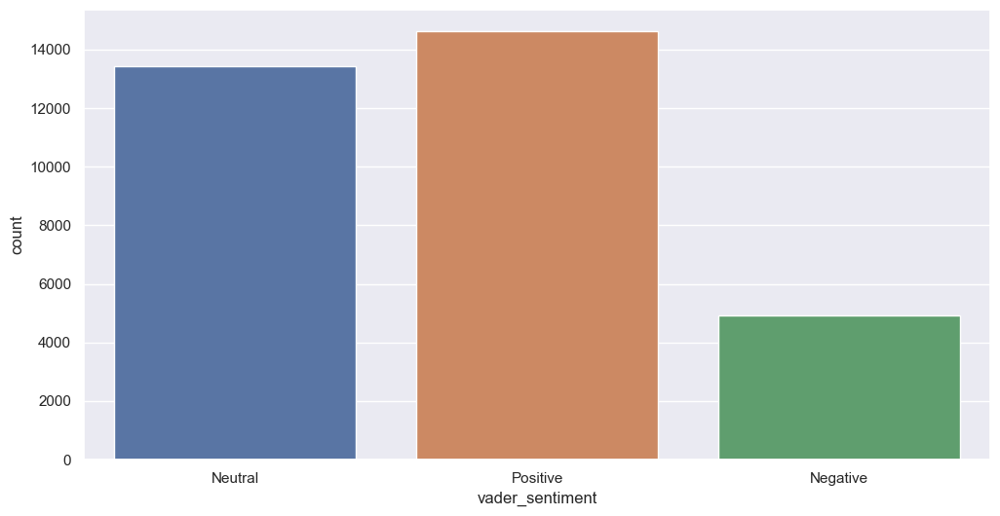

In [180]:
import seaborn as sns
import matplotlib.pyplot as plt
plt.figure(figsize=(12,6))
sns.countplot(x='vader_sentiment',data=ggl_tweet)


<AxesSubplot: xlabel='vader_sentiment', ylabel='count'>

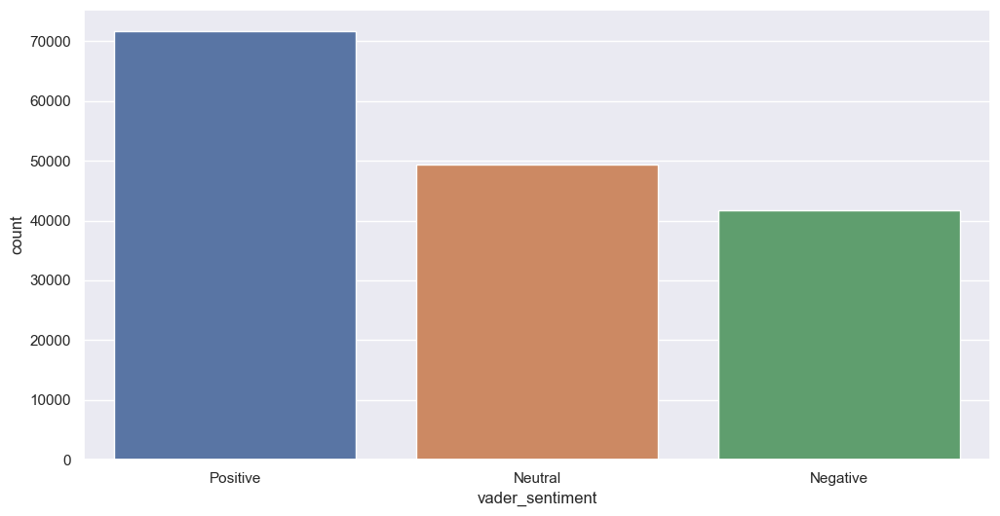

In [182]:
import seaborn as sns
plt.figure(figsize=(12,6))
sns.countplot(x='vader_sentiment',data=apl_tweet)



<AxesSubplot: xlabel='vader_sentiment', ylabel='count'>

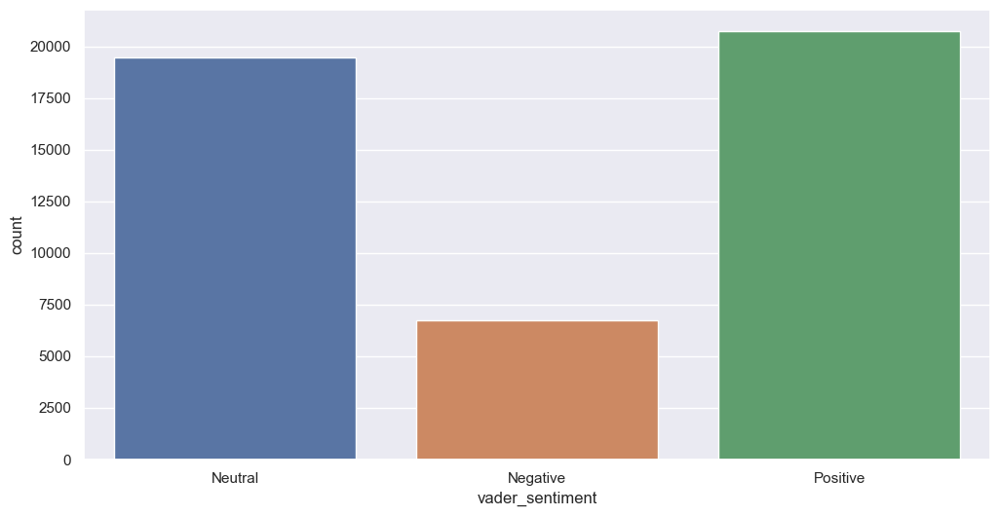

In [183]:

plt.figure(figsize=(12,6))
sns.countplot(x='vader_sentiment',data=msft_tweet)


<AxesSubplot: xlabel='vader_sentiment', ylabel='count'>

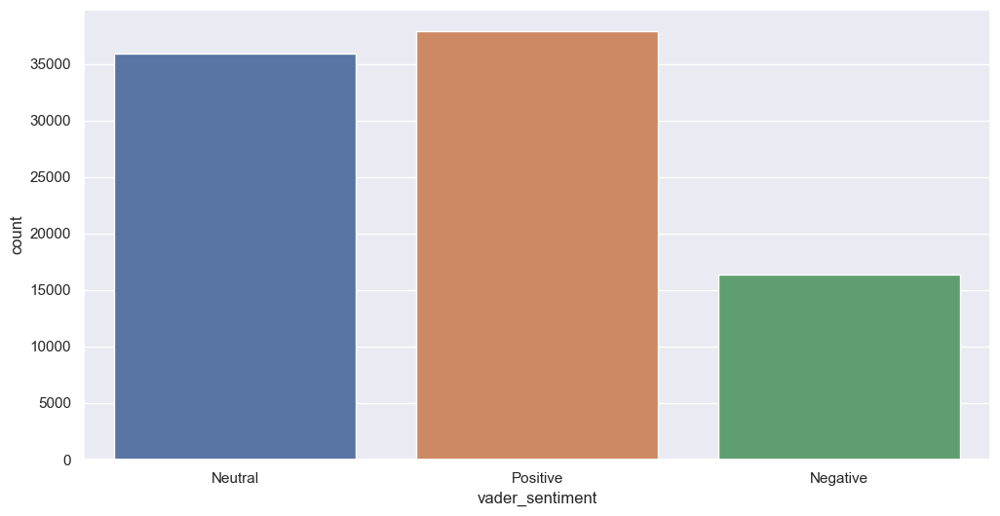

In [184]:

plt.figure(figsize=(12,6))
sns.countplot(x='vader_sentiment',data=tesla_tweet)


<AxesSubplot: xlabel='vader_sentiment', ylabel='count'>

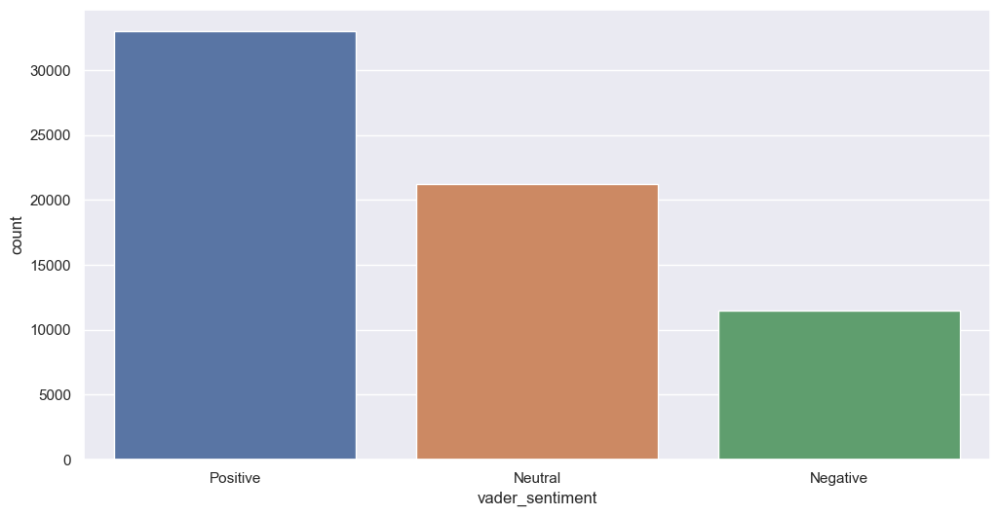

In [185]:

plt.figure(figsize=(12,6))
sns.countplot(x='vader_sentiment',data=amzn_tweet)



When we group the sentiment score of each company based on sentiment score, we can observe that the ranking for all the companies is same: Positive>Neutral>Negative. We can conclude that there are comparitively less negative tweets compared to postive and neutral

In [187]:
from plotly import graph_objs as go
fig = go.Figure(go.Funnelarea(
    text =temp.vader_sentiment,
    values = temp.body,
    title = {"position": "top center", "text": "Funnel-Chart of Sentiment Distribution"}
    ))
fig.show()


2) In the second visualization, we are analysing the number of retweets for a tweet based on companies.

In [147]:
print(tweets['retweet_num'].describe())

count    398640.000000
mean          1.000203
std           6.722249
min           0.000000
25%           0.000000
50%           0.000000
75%           1.000000
max         819.000000
Name: retweet_num, dtype: float64


Creating a separate column for day date year

In [148]:
tweets['day'] = pd.DatetimeIndex(tweets['Date']).day
tweets['month'] = pd.DatetimeIndex(tweets['Date']).month
tweets['year'] = pd.DatetimeIndex(tweets['Date']).year

In [149]:
tweets_day = tweets.groupby(['day'])['retweet_num'].sum()

In [150]:
tweets_day

day
1     11525
2     14657
3     12857
4     11290
5     11237
6     10973
7     10837
8     12155
9     12135
10    11133
11    11724
12    12512
13    12945
14    10781
15    10946
16    12372
17    11605
18    14133
19    13857
20    14425
21     9772
22    13384
23    19947
24    16948
25    18242
26    16575
27    13474
28    12098
29    11359
30    17853
31     4970
Name: retweet_num, dtype: int64

 Plots for number of retweets per day and month

Text(0.5, 1.0, 'The number of retweets per day')

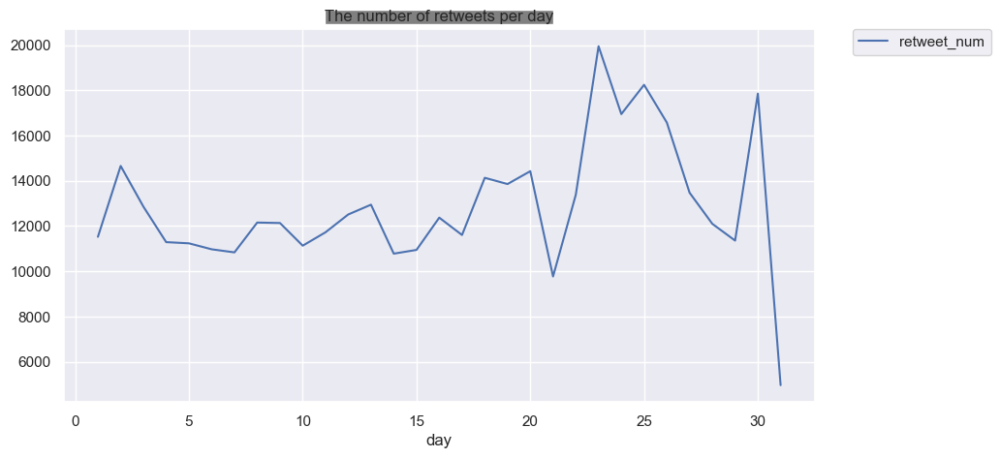

In [151]:
import matplotlib.pyplot as plt
import seaborn as sns
tweets_day.transpose().plot(kind='line',figsize=(10, 5))
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
plt.title('The number of retweets per day', bbox={'facecolor':'0.5', 'pad':0})

In [152]:
tweets_month = tweets.groupby(['month'])['retweet_num'].sum()

Text(0.5, 1.0, 'The number of retweets -month')

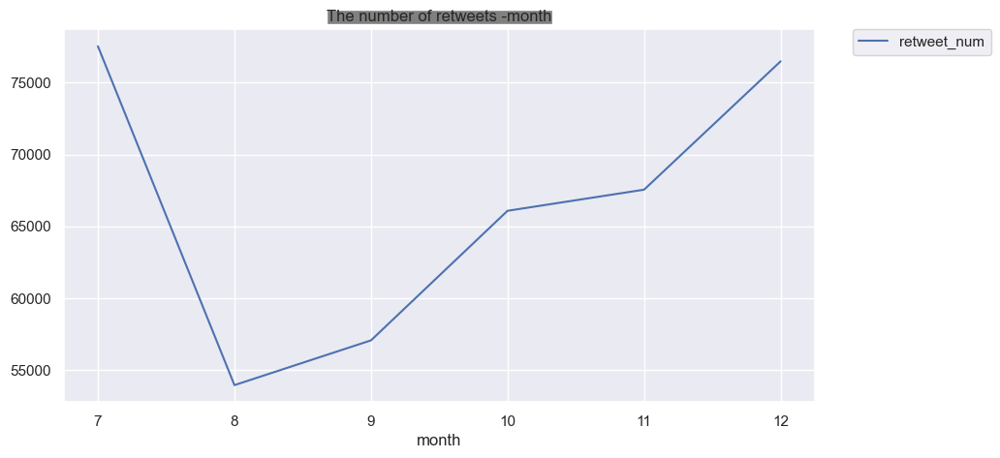

In [153]:
import matplotlib.pyplot as plt
import seaborn as sns
tweets_month.transpose().plot(kind='line',figsize=(10, 5))
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
plt.title('The number of retweets -month', bbox={'facecolor':'0.5', 'pad':0})

Creating a separate column for day date year for all tweets

In [154]:
amzn_tweet['day'] = pd.DatetimeIndex(amzn_tweet['Date']).day
amzn_tweet['month'] = pd.DatetimeIndex(amzn_tweet['Date']).month
tesla_tweet['day'] = pd.DatetimeIndex(tesla_tweet['Date']).day
tesla_tweet['month'] = pd.DatetimeIndex(tesla_tweet['Date']).month
msft_tweet['day'] = pd.DatetimeIndex(msft_tweet['Date']).day
msft_tweet['month'] = pd.DatetimeIndex(msft_tweet['Date']).month
ggl_tweet['day'] = pd.DatetimeIndex(ggl_tweet['Date']).day
ggl_tweet['month'] = pd.DatetimeIndex(ggl_tweet['Date']).month
apl_tweet['day'] = pd.DatetimeIndex(apl_tweet['Date']).day
apl_tweet['month'] = pd.DatetimeIndex(apl_tweet['Date']).month



Grouping the tweets by day, date, retweet number

In [155]:
amzntweet_day = amzn_tweet.groupby(['day'])['retweet_num'].sum()
amzntweet_date = amzn_tweet.groupby(['Date'])['retweet_num'].sum()
teslatweet_day = tesla_tweet.groupby(['day'])['retweet_num'].sum()
teslatweet_date = tesla_tweet.groupby(['Date'])['retweet_num'].sum()
msfttweet_day = msft_tweet.groupby(['day'])['retweet_num'].sum()
msfttweet_date = msft_tweet.groupby(['Date'])['retweet_num'].sum()
ggltweet_day = ggl_tweet.groupby(['day'])['retweet_num'].sum()
ggltweet_date = ggl_tweet.groupby(['Date'])['retweet_num'].sum()
apltweet_day = apl_tweet.groupby(['day'])['retweet_num'].sum()
apltweet_date = apl_tweet.groupby(['Date'])['retweet_num'].sum()


In [157]:
amzntlikes_day = amzn_tweet.groupby(['day'])['like_num'].sum()
teslalikes_day = tesla_tweet.groupby(['day'])['like_num'].sum()
msftlikes_day = msft_tweet.groupby(['day'])['like_num'].sum()
ggllikes_day = ggl_tweet.groupby(['day'])['like_num'].sum()
apllikes_day = apl_tweet.groupby(['day'])['like_num'].sum()


Plotting the number of retweets for each company.

Text(0.5, 1.0, 'The number of amazon retweets ')

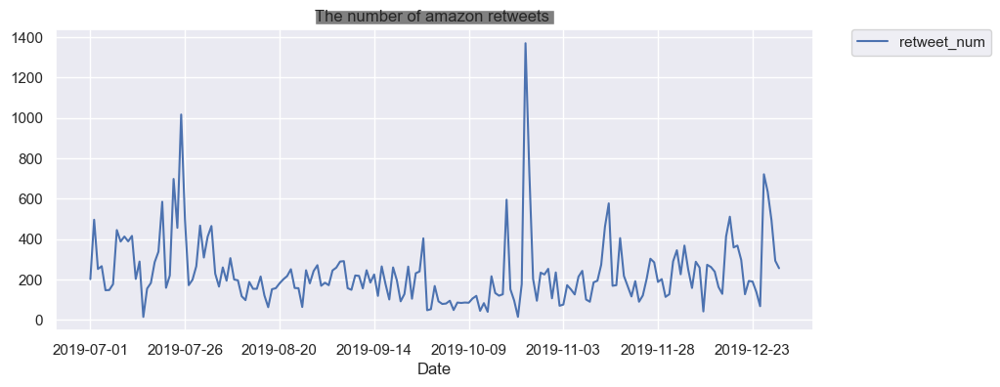

In [159]:
amzntweet_date.transpose().plot(kind='line',figsize=(10, 4))
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
plt.title('The number of amazon retweets ', bbox={'facecolor':'0.5', 'pad':0})

Text(0.5, 1.0, 'The number of tesla retweets')

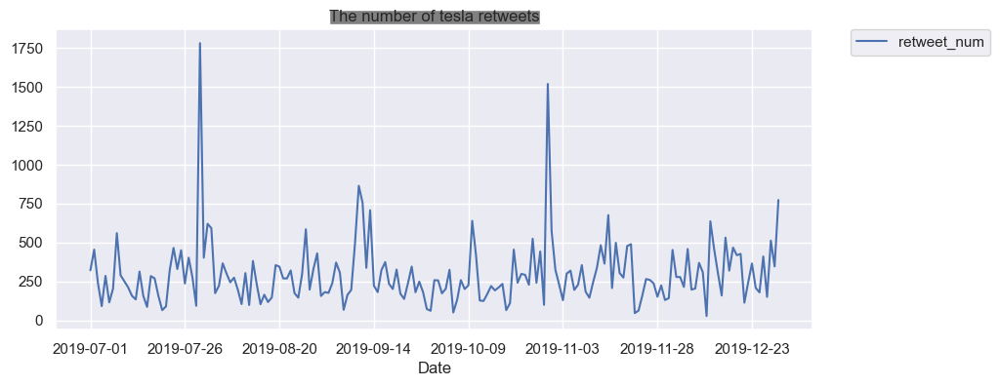

In [160]:
teslatweet_date.transpose().plot(kind='line',figsize=(10, 4))
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
plt.title('The number of tesla retweets', bbox={'facecolor':'0.5', 'pad':0})

Text(0.5, 1.0, 'The number of microsoft retweets')

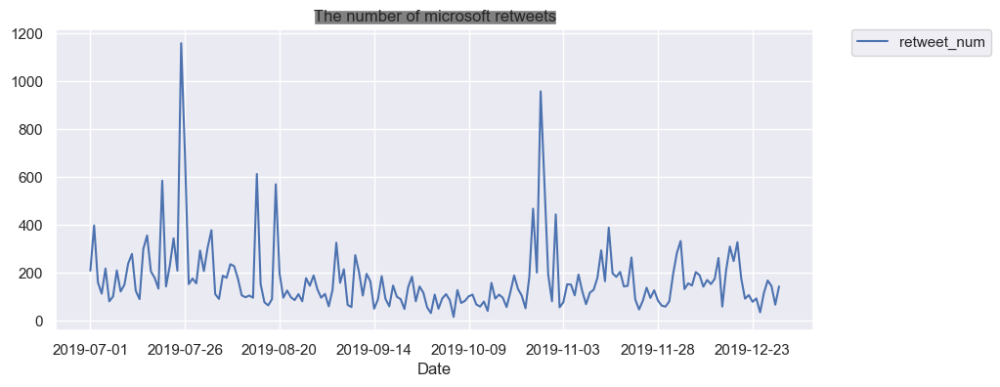

In [161]:
msfttweet_date.transpose().plot(kind='line',figsize=(10, 4))
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
plt.title('The number of microsoft retweets', bbox={'facecolor':'0.5', 'pad':0})

Text(0.5, 1.0, 'The number of google retweets')

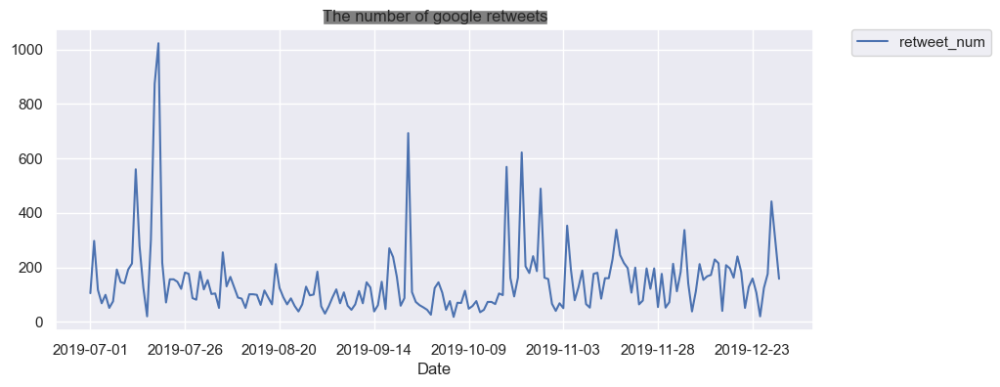

In [162]:
ggltweet_date.transpose().plot(kind='line',figsize=(10, 4))
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
plt.title('The number of Google retweets', bbox={'facecolor':'0.5', 'pad':0})

Text(0.5, 1.0, 'The number of apple retweets')

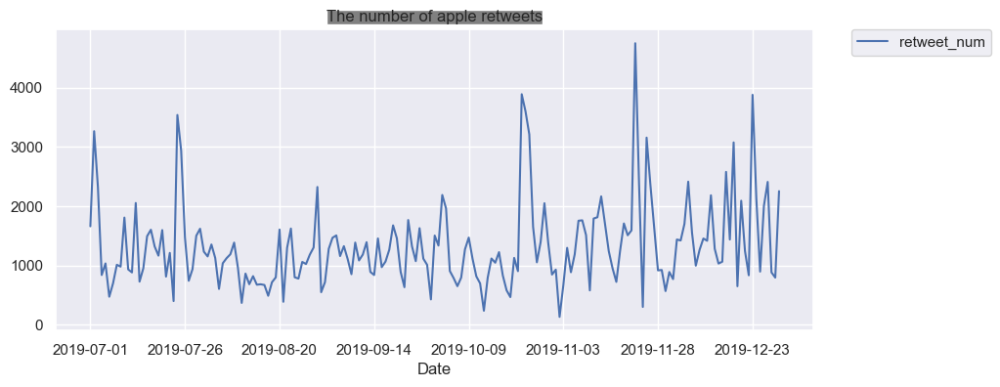

In [163]:
apltweet_date.transpose().plot(kind='line',figsize=(10, 4))
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
plt.title('The number of Apple retweets', bbox={'facecolor':'0.5', 'pad':0})

We can concluded anything based on above plots. Hence, Plotting the number of retweets by combining retweet count on a day on all months

Text(0.5, 1.0, 'The number of amazon retweets per day')

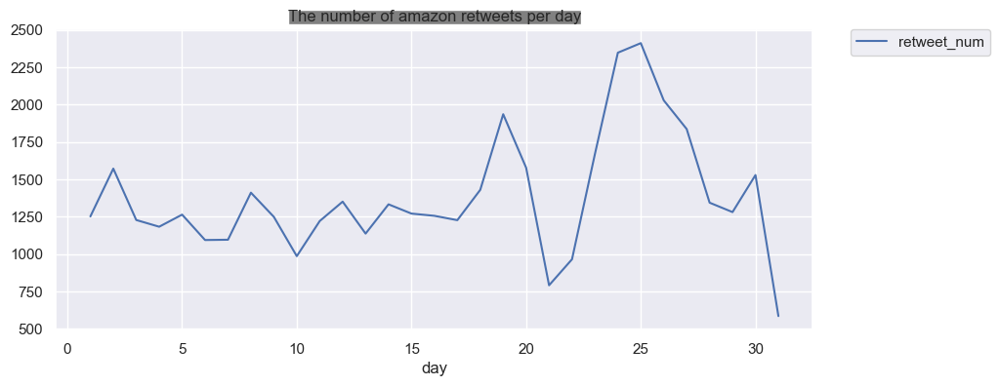

In [164]:

amzntweet_day.transpose().plot(kind='line',figsize=(10, 4))
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
plt.title('The number of amazon retweets per day', bbox={'facecolor':'0.5', 'pad':0})

Text(0.5, 1.0, 'The number of amazon retweets per day')

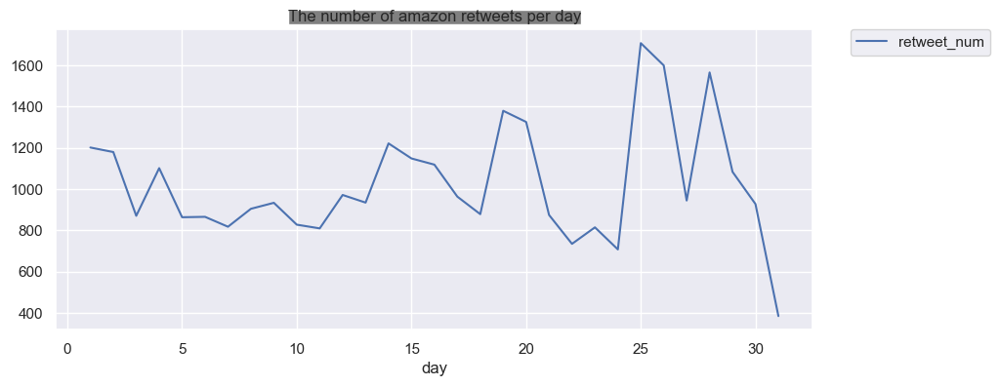

In [165]:
msfttweet_day.transpose().plot(kind='line',figsize=(10, 4))
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
plt.title('The number of Microsoft retweets per day', bbox={'facecolor':'0.5', 'pad':0})

Text(0.5, 1.0, 'The number of Google retweets per day')

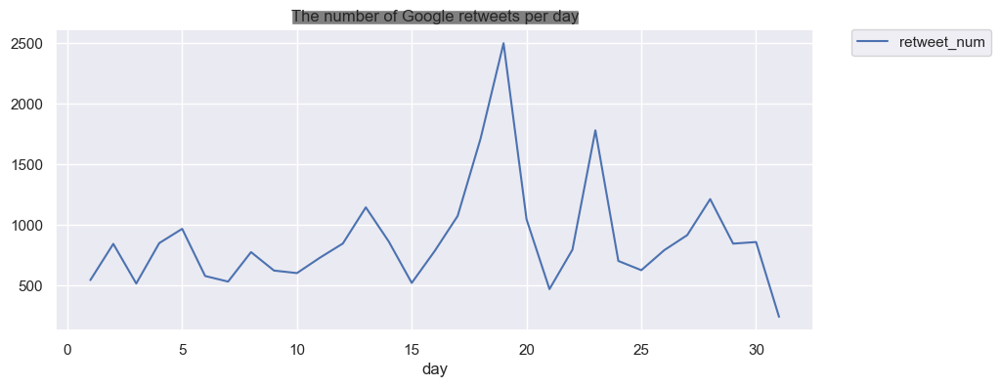

In [167]:
ggltweet_day.transpose().plot(kind='line',figsize=(10, 4))
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
plt.title('The number of Google retweets per day', bbox={'facecolor':'0.5', 'pad':0})

Text(0.5, 1.0, 'The number of Apple retweets per day')

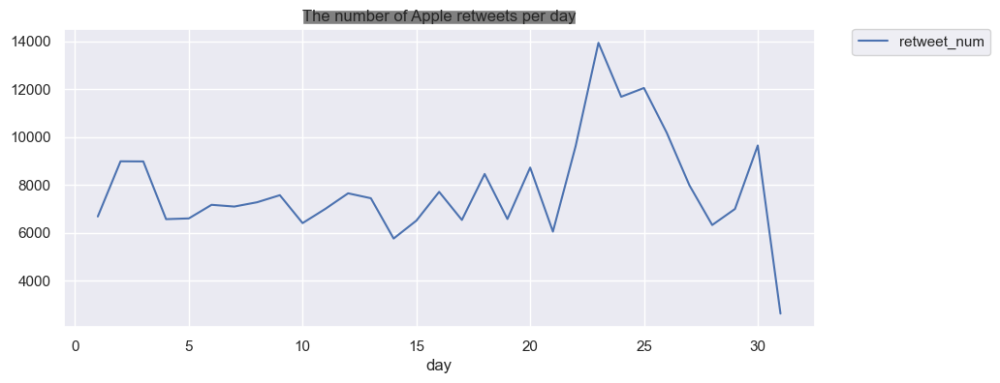

In [168]:
apltweet_day.transpose().plot(kind='line',figsize=(10, 4))
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
plt.title('The number of Apple retweets per day', bbox={'facecolor':'0.5', 'pad':0})

Text(0.5, 1.0, 'The number of Tesla retweets per day')

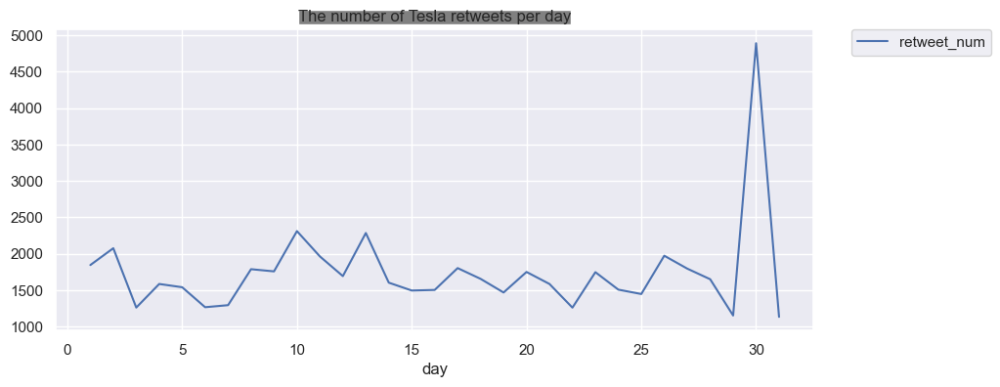

In [169]:
teslatweet_day.transpose().plot(kind='line',figsize=(10, 4))
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
plt.title('The number of Tesla retweets per day', bbox={'facecolor':'0.5', 'pad':0})

Here we can observe that retweet count is increasing at the end of each month.

Now we will try plotting the number of likes for tweets per day of every month

Text(0.5, 1.0, 'The number of Amazon likes per day')

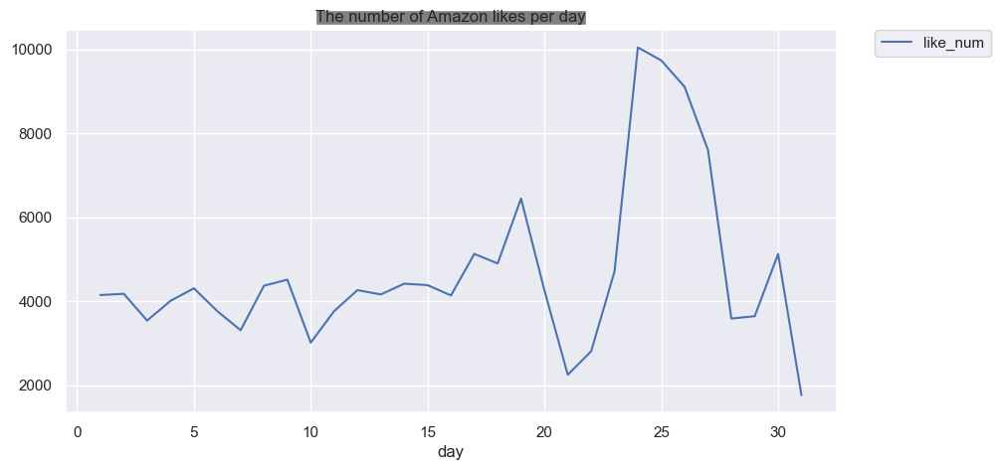

In [176]:

amzntlikes_day.transpose().plot(kind='line',figsize=(10,5))
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
plt.title('The number of Amazon likes per day', bbox={'facecolor':'0.5', 'pad':0})

Text(0.5, 1.0, 'The number of Tesla likes per day')

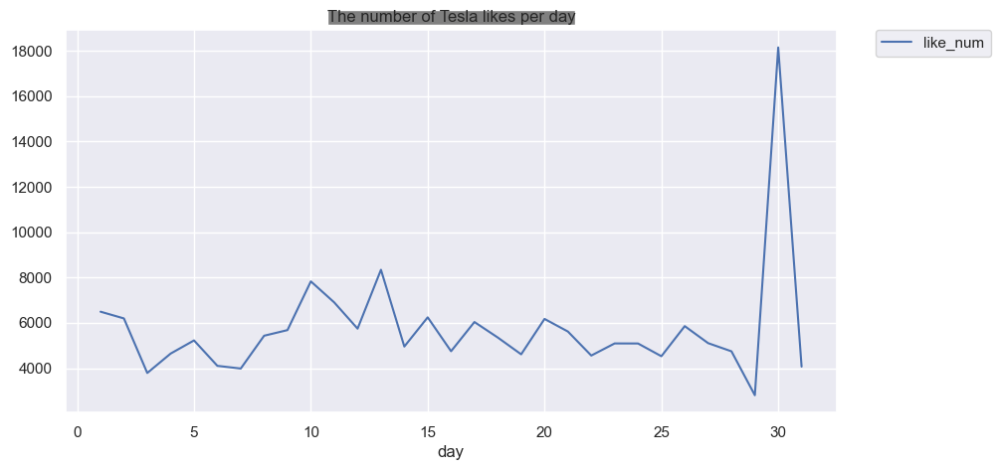

In [174]:
teslalikes_day.transpose().plot(kind='line',figsize=(10,5))
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
plt.title('The number of Tesla likes per day', bbox={'facecolor':'0.5', 'pad':0})

Text(0.5, 1.0, 'The number of Microsoft likes per day')

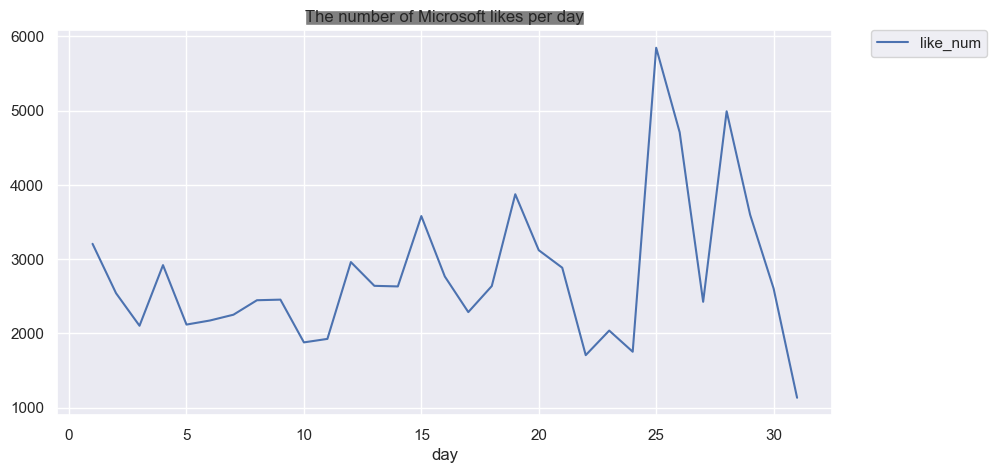

In [175]:
msftlikes_day.transpose().plot(kind='line',figsize=(10,5))
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
plt.title('The number of Microsoft likes per day', bbox={'facecolor':'0.5', 'pad':0})

Text(0.5, 1.0, 'The number of amazon likes per day')

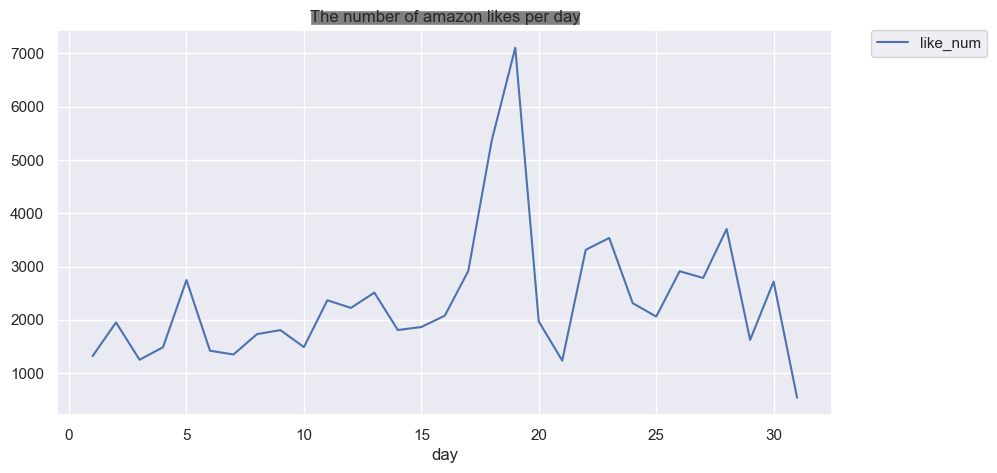

In [173]:
ggllikes_day.transpose().plot(kind='line',figsize=(10,5))
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
plt.title('The number of amazon likes per day', bbox={'facecolor':'0.5', 'pad':0})

Text(0.5, 1.0, 'The number of Apple likes per day')

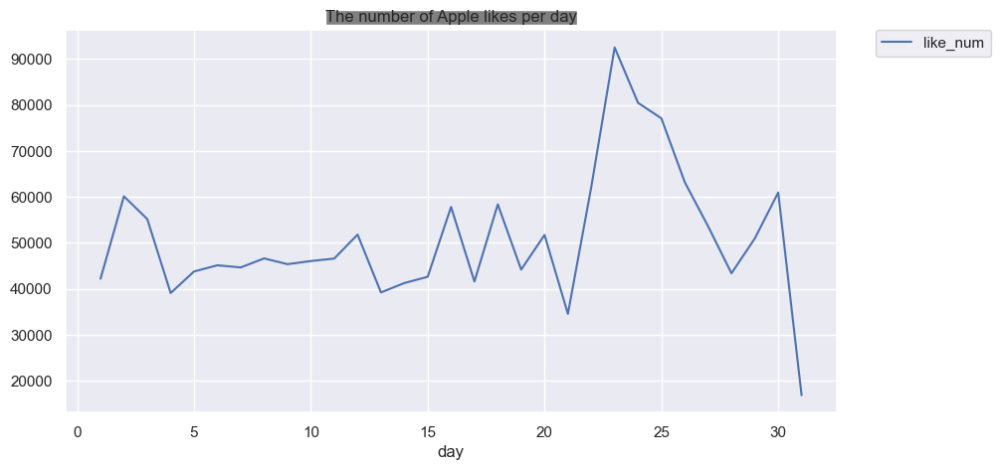

In [177]:
apllikes_day.transpose().plot(kind='line',figsize=(10,5))
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
plt.title('The number of Apple likes per day', bbox={'facecolor':'0.5', 'pad':0})

Number of likes are also increasing at the end of the month. As likes are related on the retweet count, we can see they are correlated.

3) Now we will see the frequency of tweets with the lenght of the tweet for each company

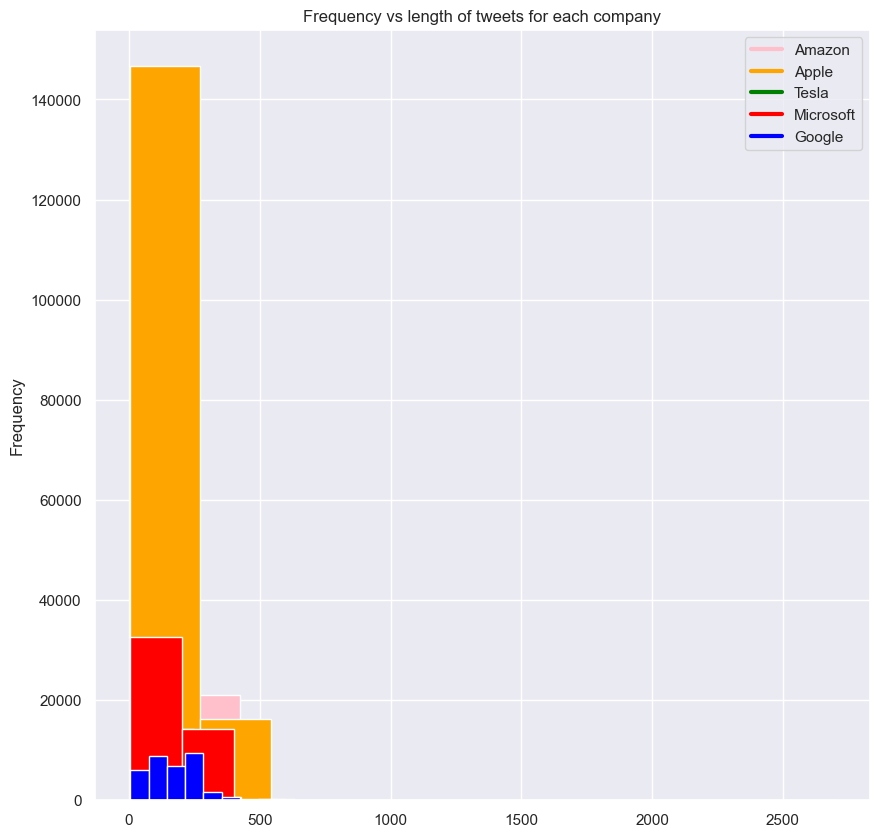

In [195]:
from matplotlib.lines import Line2D

length_amzn = amzn_tweet['body'].str.len().plot.hist(color = 'pink', figsize = (10, 10))
length_apple = apl_tweet['body'].str.len().plot.hist(color = 'orange', figsize = (10, 10))
length_tesla = tesla_tweet['body'].str.len().plot.hist(color = 'green', figsize = (10, 10))
length_microsoft = msft_tweet['body'].str.len().plot.hist(color = 'red', figsize = (10, 10))
length_google = ggl_tweet['body'].str.len().plot.hist(color = 'blue', figsize = (10, 10))
plt.title('Frequency vs length of tweets for each company')
colors = ['pink', 'orange', 'green','red','blue']
lines = [Line2D([0], [0], color=c, linewidth=3, linestyle='-') for c in colors]
labels = ['Amazon', 'Apple', 'Tesla','Microsoft','Google']
plt.legend(lines, labels,loc="upper right")

     

From the above plot, it is clear that the frequency of apple tweets is more and remaining companies have similar lengths and frequencies.

4) Below we are tokenizing the words in the tweets and counting their frequency. We'll plot the most commonly used words.

frequency of common words for amazon tweets

Text(0.5, 1.0, 'Common words in Amazon tweets')

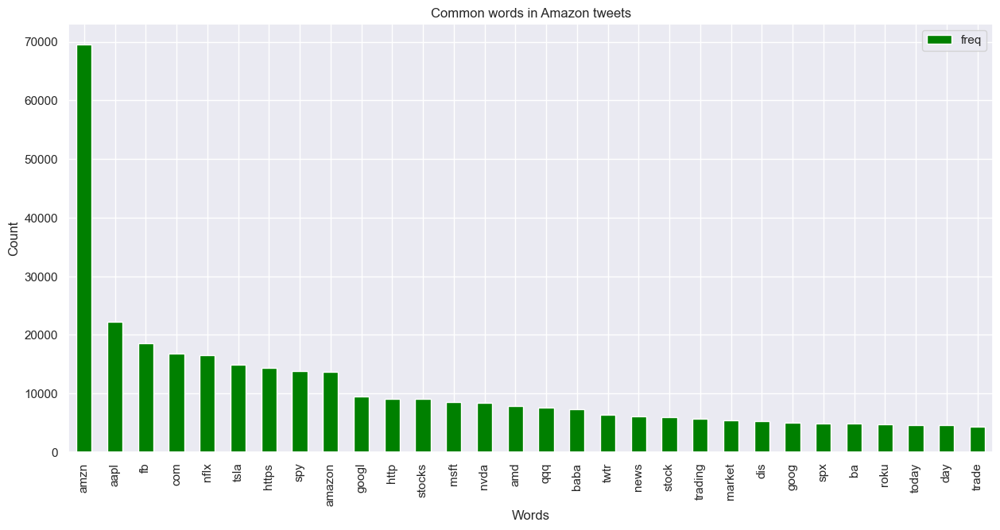

In [210]:
from sklearn.feature_extraction.text import CountVectorizer


cv = CountVectorizer(stop_words = 'english')
w = cv.fit_transform(amzn_tweet.body)

s_w = w.sum(axis=0)

w_f = [(word, s_w[0, i]) for word, i in cv.vocabulary_.items()]
w_f = sorted(w_f, key = lambda x: x[1], reverse = True)

frequency = pd.DataFrame(w_f, columns=['w', 'freq'])

frequency.head(30).plot(x='w', y='freq', kind='bar', figsize=(15, 7), color = 'green')
plt.xlabel('Words')
plt.ylabel('Count')
plt.title("Common words in Amazon tweets")


     

frequency of common words for google tweets

Text(0.5, 1.0, 'Common words in Google tweets')

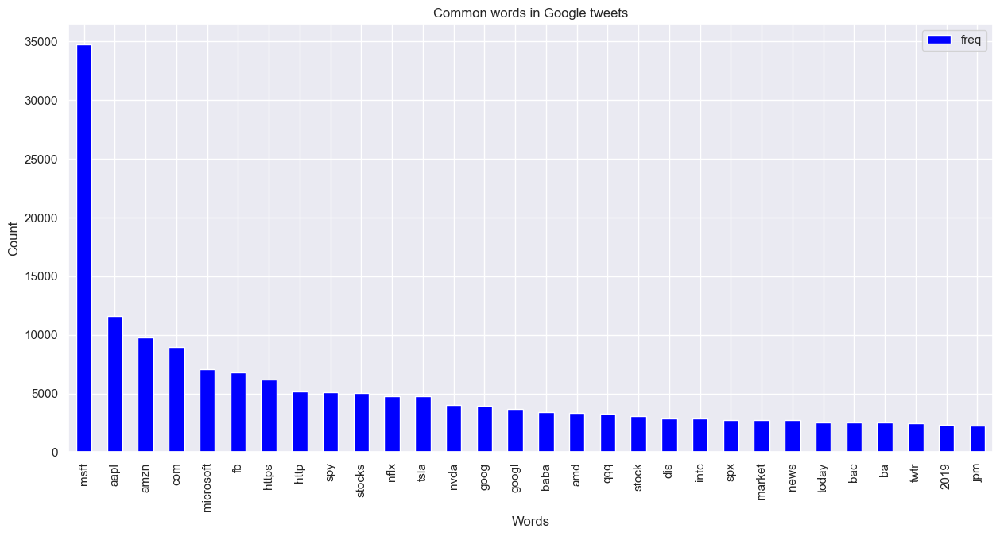

In [209]:
from sklearn.feature_extraction.text import CountVectorizer


cv = CountVectorizer(stop_words = 'english')
w = cv.fit_transform(ggl_tweet.body)

s_w = w.sum(axis=0)

w_f = [(word, s_w[0, i]) for word, i in cv.vocabulary_.items()]
w_f = sorted(w_f, key = lambda x: x[1], reverse = True)

frequency = pd.DataFrame(w_f, columns=['w', 'freq'])

frequency.head(30).plot(x='w', y='freq', kind='bar', figsize=(15, 7), color = 'blue')
plt.xlabel('Words')
plt.ylabel('Count')
plt.title("Common words in Google tweets")


frequency of common words for tesla tweets

Text(0.5, 1.0, 'Common words in Tesla')

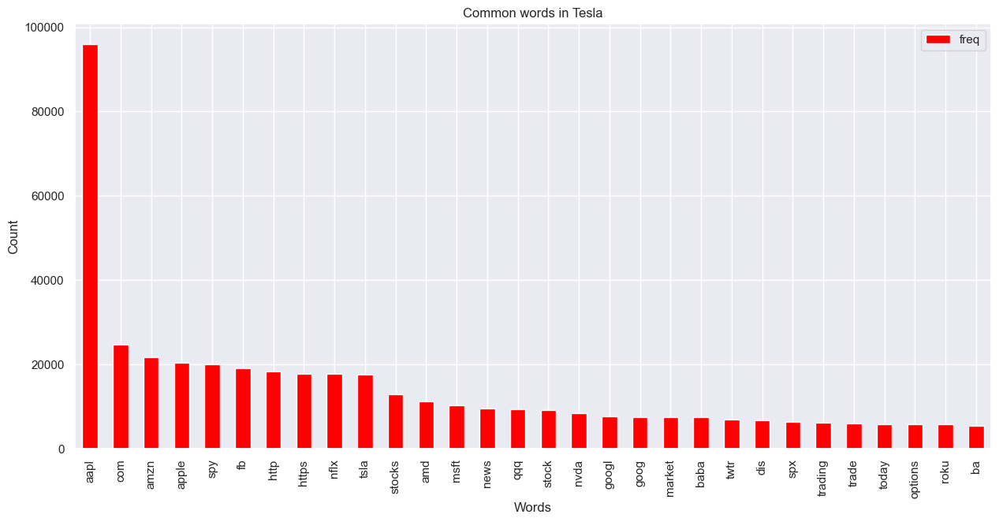

In [208]:
from sklearn.feature_extraction.text import CountVectorizer


cv = CountVectorizer(stop_words = 'english')
w = cv.fit_transform(tesla_tweet.body)

s_w = w.sum(axis=0)

w_f = [(word, s_w[0, i]) for word, i in cv.vocabulary_.items()]
w_f = sorted(w_f, key = lambda x: x[1], reverse = True)

frequency = pd.DataFrame(w_f, columns=['w', 'freq'])

frequency.head(30).plot(x='w', y='freq', kind='bar', figsize=(15, 7), color = 'red')
plt.xlabel('Words')
plt.ylabel('Count')
plt.title("Common words in Tesla")



frequency of common words for apple tweets

Text(0.5, 1.0, 'Common words in Apple Tweets')

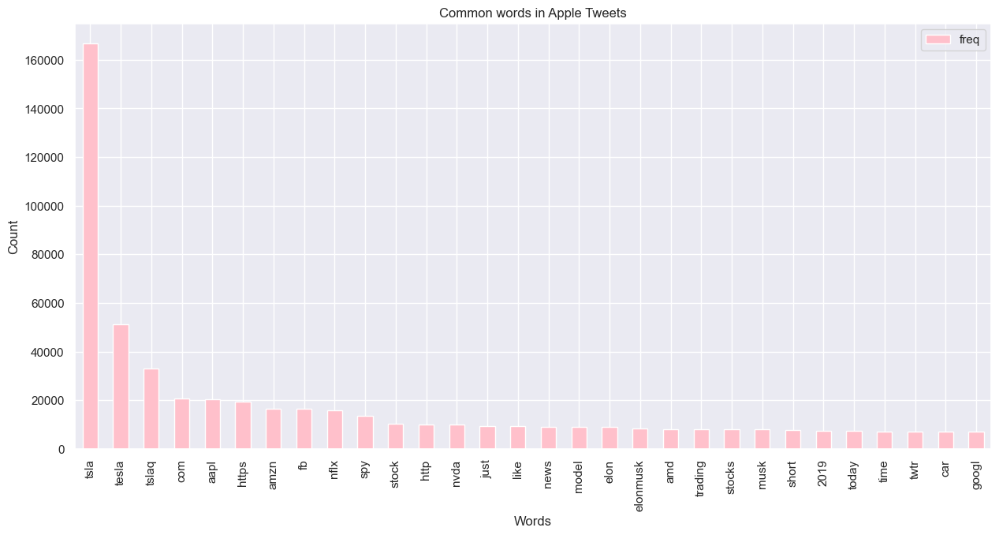

In [211]:
from sklearn.feature_extraction.text import CountVectorizer


cv = CountVectorizer(stop_words = 'english')
w = cv.fit_transform(apl_tweet.body)

s_w = w.sum(axis=0)

w_f = [(word, s_w[0, i]) for word, i in cv.vocabulary_.items()]
w_f = sorted(w_f, key = lambda x: x[1], reverse = True)

frequency = pd.DataFrame(w_f, columns=['w', 'freq'])

frequency.head(30).plot(x='w', y='freq', kind='bar', figsize=(15, 7), color = 'pink')
plt.xlabel('Words')
plt.ylabel('Count')
plt.title("Common words in Apple Tweets")


frequency of common words for microsoft tweets

Text(0.5, 1.0, 'Common words in Microsoft tweets')

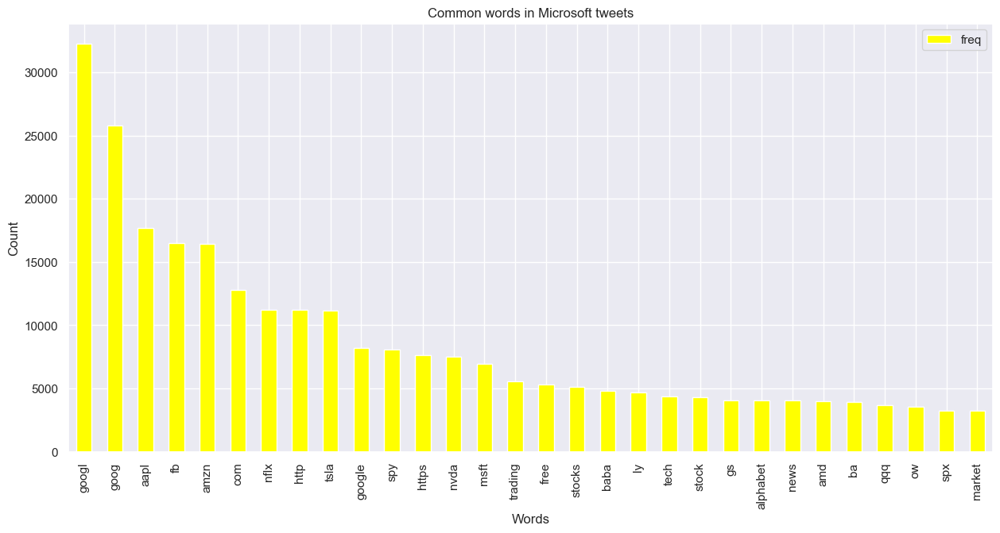

In [212]:
from sklearn.feature_extraction.text import CountVectorizer


cv = CountVectorizer(stop_words = 'english')
w = cv.fit_transform(msft_tweet.body)
s_w = w.sum(axis=0)

w_f = [(word, s_w[0, i]) for word, i in cv.vocabulary_.items()]
w_f = sorted(w_f, key = lambda x: x[1], reverse = True)

frequency = pd.DataFrame(w_f, columns=['w', 'freq'])

frequency.head(30).plot(x='w', y='freq', kind='bar', figsize=(15, 7), color = 'yellow')
plt.xlabel('Words')
plt.ylabel('Count')
plt.title("Common words in Microsoft tweets")


Count of commom words in All tweets

In [8]:
from collections import Counter
tweets['t_l'] = tweets['body'].apply(lambda x:str(x).split())
top = Counter([item for sublist in tweets['t_l'] for item in sublist])
t = pd.DataFrame(top.most_common(30))
t.columns = ['COMMON_WORDS','COUNT']
t.style.background_gradient(cmap='Purples')

,COMMON_WORDS,COUNT
0,the,184651
1,to,157603
2,$TSLA,130879
3,$AAPL,113045
4,a,110418
5,and,101528
6,of,96457
7,for,94843
8,$AMZN,94469
9,in,92581


In [9]:
import plotly.express as px
fig = px.bar(t, x="COUNT", y="COMMON_WORDS", title='COMMON WORDS', orientation='h', 
             width=800, height=800,color='COMMON_WORDS')
fig.show()


With the above plot and frequency count, we cannot analyse any sentiment as most common words are Nouns or Prepositions
Below we are plotting word cloud for the same.

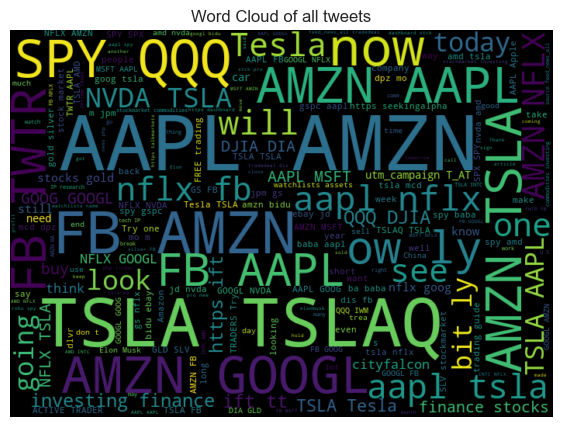

In [223]:
from wordcloud import WordCloud 
a_w = ' '.join([body for body in tweets.body])
wordcloud = WordCloud(width=700, height=500, random_state=50, max_font_size=100).generate(a_w)
plt.figure(figsize=(7, 7))
plt.imshow(wordcloud, interpolation="bilinear")
plt.title('Word Cloud of all tweets')
plt.axis('off')
plt.show()


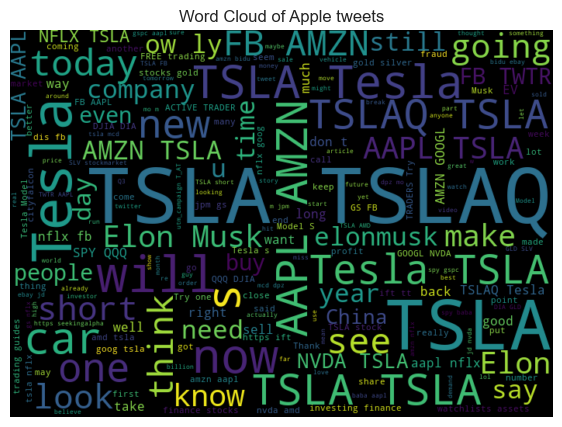

In [224]:
from wordcloud import WordCloud 
a_w = ' '.join([body for body in apl_tweet.body])
wordcloud = WordCloud(width=700, height=500, random_state=50, max_font_size=100).generate(a_w)

plt.figure(figsize=(7, 7))
plt.imshow(wordcloud, interpolation="bilinear")
plt.title('Word Cloud of Apple tweets')
plt.axis('off')
plt.show()


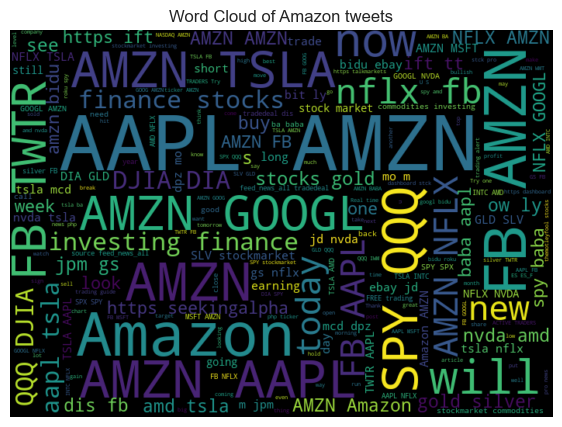

In [225]:
a_w = ' '.join([body for body in amzn_tweet.body])
wordcloud = WordCloud(width=700, height=500, random_state=50, max_font_size=100).generate(a_w)

plt.figure(figsize=(7, 7))
plt.imshow(wordcloud, interpolation="bilinear")
plt.title('Word Cloud of Amazon tweets')
plt.axis('off')
plt.show()


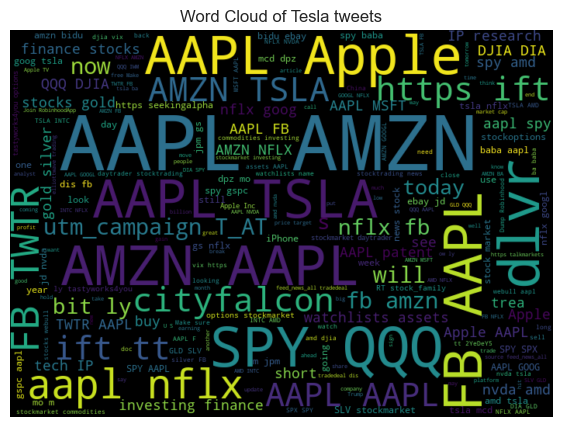

In [226]:
a_w = ' '.join([body for body in tesla_tweet.body])
wordcloud = WordCloud(width=700, height=500, random_state=50, max_font_size=100).generate(a_w)

plt.figure(figsize=(7, 7))
plt.imshow(wordcloud, interpolation="bilinear")
plt.title('Word Cloud of Tesla tweets')
plt.axis('off')
plt.show()


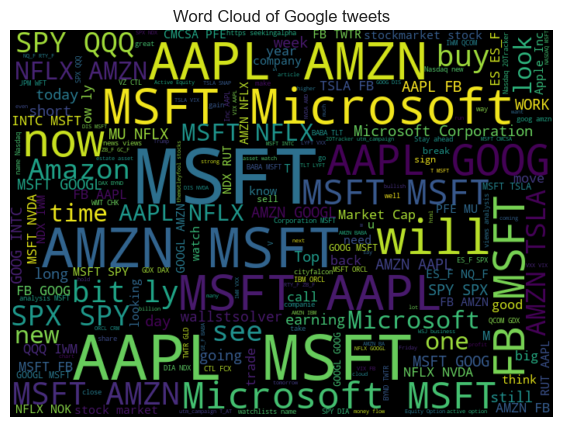

In [227]:
a_w = ' '.join([body for body in ggl_tweet.body])
wordcloud = WordCloud(width=700, height=500, random_state=50, max_font_size=100).generate(a_w)

plt.figure(figsize=(7, 7))
plt.imshow(wordcloud, interpolation="bilinear")
plt.title('Word Cloud of Google tweets')
plt.axis('off')
plt.show()


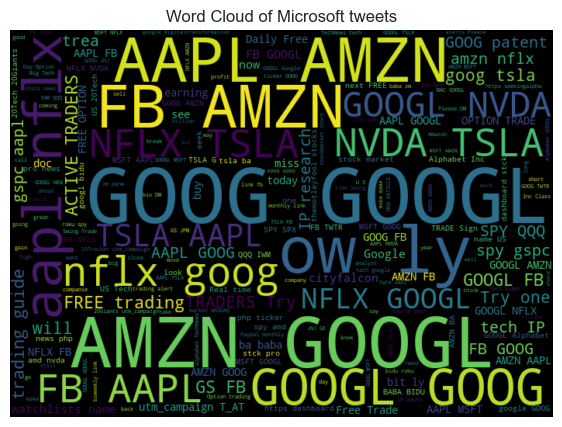

In [228]:
a_w = ' '.join([body for body in msft_tweet.body])
wordcloud = WordCloud(width=700, height=500, random_state=50, max_font_size=100).generate(a_w)

plt.figure(figsize=(7, 7))
plt.imshow(wordcloud, interpolation="bilinear")
plt.title('Word Cloud of Microsoft tweets')
plt.axis('off')
plt.show()



5) Below we are plotting heatmaps for correlation between all the columns

In [232]:
tickers = ['AMZN', 'GOOG,GOOGL', 'MSFT', 'TSLA', 'AAPL']
stocks = pd.concat([amzn_stock,google_stock,microsoft_stock,tesla_stock,apple_stock], axis=1, keys=tickers)




In [233]:
stocks.columns.names = [' Ticker','Stock Info']
stocks.head()

Ticker          AMZN                                                          \
Stock Info Unnamed: 0        Date       High        Low       Open      Close   
0                   0  2019-07-01  96.490997  95.733002  96.149002  96.109497   
1                   1  2019-07-02  96.739502  95.331497  95.969002  96.715500   
2                   2  2019-07-03  97.079498  96.525002  96.794502  96.949997   
3                   3  2019-07-05  97.294998  96.264999  96.430000  97.145500   
4                   4  2019-07-08  97.800003  96.412498  96.706001  97.615997   

 Ticker                         GOOG,GOOGL              ...       TSLA  \
Stock Info    Volume  Adj Close Unnamed: 0        Date  ...     Volume   
0           63842000  96.109497          0  2019-07-01  ...  123201000   
1           52918000  96.715500          1  2019-07-02  ...  138885000   
2           33806000  96.949997          2  2019-07-03  ...  213016500   
3           52568000  97.145500          3  2019-07-05  ...  105985500   
4           57668000  97.615997          4  2019-07-08  ...   88207500   

 Ticker                     AAPL                                               \
Stock Info  Adj Close Unnamed: 0        Date       High        Low       Open   
0           15.144667          0  2019-07-01  51.122501  50.162498  50.792500   
1           14.970000          1  2019-07-02  50.782501  50.340000  50.352501   
2           15.660000          2  2019-07-03  51.110001  50.672501  50.820000   
3           15.540000          3  2019-07-05  51.270000  50.724998  50.837502   
4           15.356000          4  2019-07-08  50.349998  49.602501  50.202499   

 Ticker                                        
Stock Info      Close       Volume  Adj Close  
0           50.387501  109012000.0  49.029461  
1           50.682499   67740800.0  49.316505  
2           51.102501   45448000.0  49.725197  
3           51.057499   69062000.0  49.681393  
4           50.005001  101354400.0  48.657265  

[5 rows x 40 columns]

<AxesSubplot: title={'center': 'Pearson Correlation Matrix'}, xlabel=' Ticker-Stock Info', ylabel=' Ticker-Stock Info'>

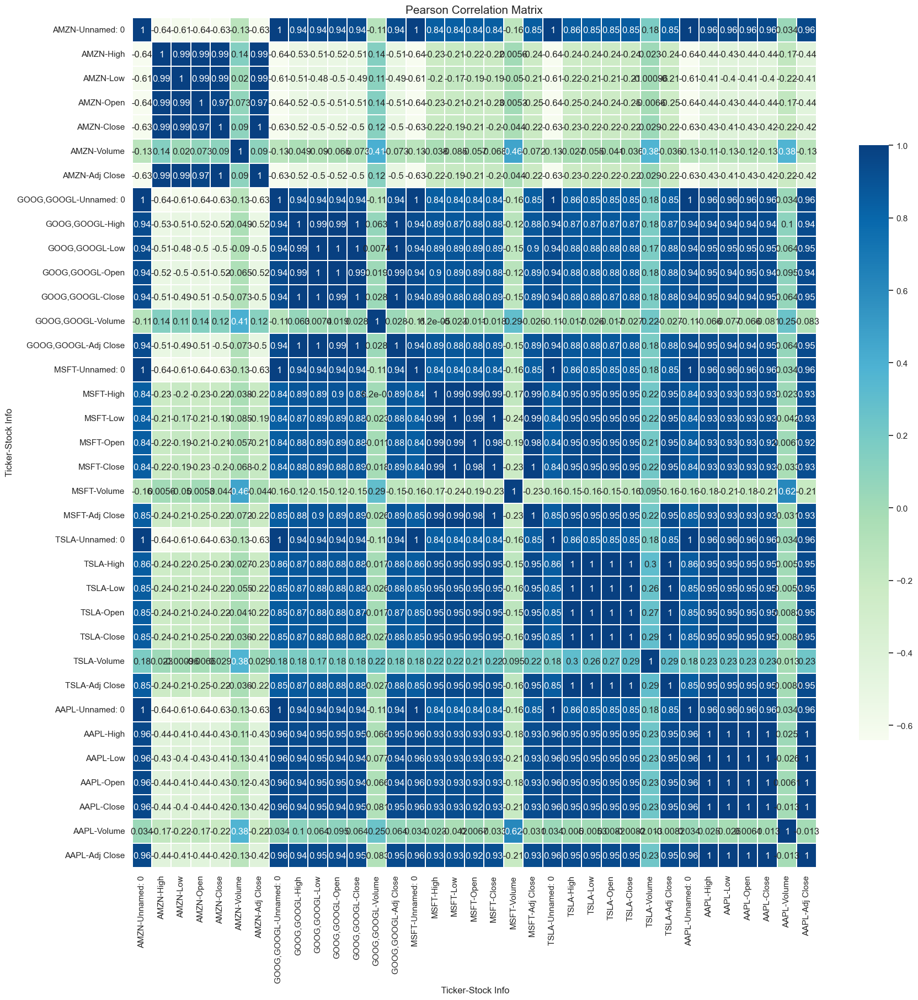

In [234]:
plt.figure(figsize=(20,20))
plt.title('Pearson Correlation Matrix',fontsize=15)
sns.heatmap(stocks.corr(), annot=True, cmap='GnBu',
            linewidths=0.25, linecolor='w', cbar_kws={"shrink": .7})


6) Correlation between stock volume vs tweet volume on a given day: To find out whether the quantity of tweets has an impact on the volume traded of the specific company we used spearman correlation because it does not assume that the dataset is normally distributed.

In [5]:
import pandas as pd
import matplotlib.pyplot as plt
tesla_stock = pd.read_csv('dataset/tesla_stock.csv')
tesla_tweet = pd.read_csv('dataset/EDA_tesla_tweets.csv')

In [8]:
from scipy import stats as stat

def tweet_v_imp(tweets,stocks,title):
    tweet_s1 = tweets.groupby('Date').size().shift(-1).dropna() 
    s_d = stocks['Volume'].dropna()
    corr, pval = stat.spearmanr(tweet_s1.reindex(s_d.index), s_d,nan_policy='omit')
    t_v = tweets.groupby('Date').size().rolling(30).mean().dropna()
    s_d = stocks['Volume'].rolling(30).mean().dropna()
    f = plt.figure(figsize=(12,8))
    a1 = f.add_subplot()
    a2 = f.add_subplot()
    a2 = a1.twinx()
    a1.plot(t_v.index,t_v,color='green',label='Tweet Volume')
    a2.plot(s_d.index,s_d,color='red',label='Trade Volume')
    a2.set_title(title+" \n Spearman correlation of tweet volume VS stock volume: corr={0:.5f} pval={1:.5f}".format(corr,pval))
    
    l, lb = a1.get_legend_handles_labels()
    l2, lb2 = a2.get_legend_handles_labels()
    a2.legend(l + l2, lb + lb2, loc=0)
    plt.show()

/var/folders/xl/bkp1f6b120x9rzphm4m9hb4h0000gn/T/ipykernel_1315/3427085415.py:11: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  a2 = f.add_subplot()


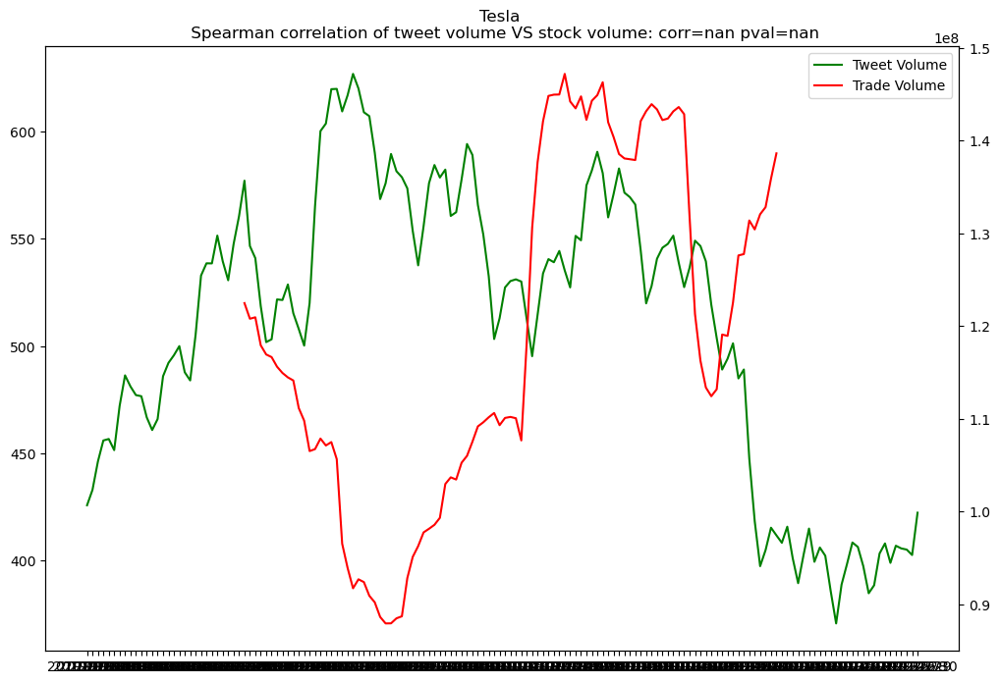

In [9]:
tweet_v_imp(tesla_tweet,tesla_stock,"Tesla")  

/var/folders/xl/bkp1f6b120x9rzphm4m9hb4h0000gn/T/ipykernel_1315/3427085415.py:11: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  a2 = f.add_subplot()


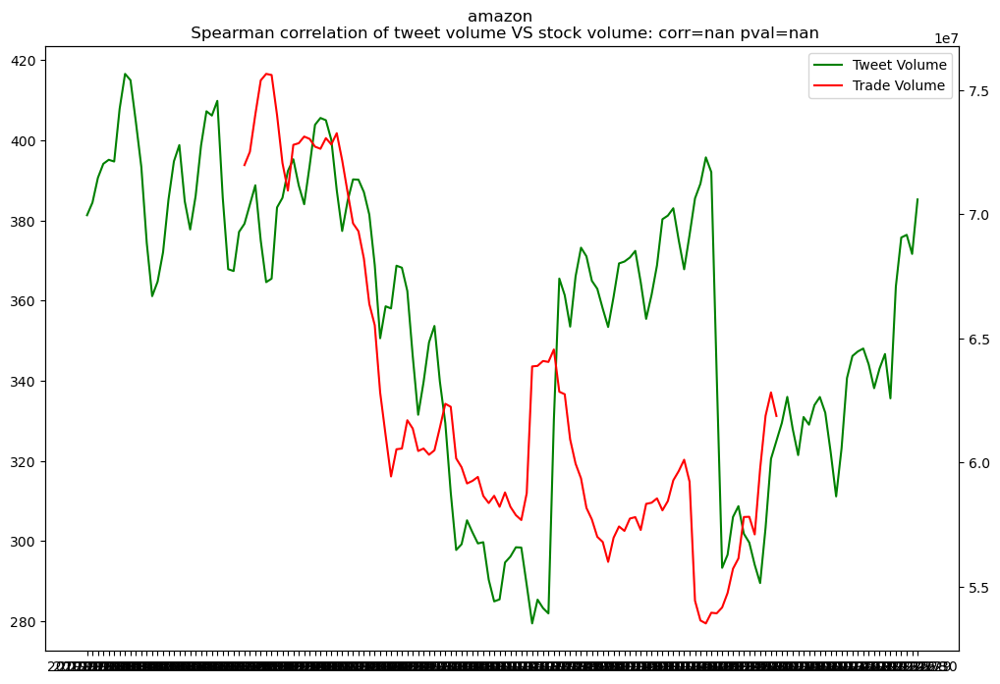

In [12]:
tweet_v_imp(amzn_tweet,amzn_stock,"amazon")  

/var/folders/xl/bkp1f6b120x9rzphm4m9hb4h0000gn/T/ipykernel_1315/3427085415.py:11: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  a2 = f.add_subplot()


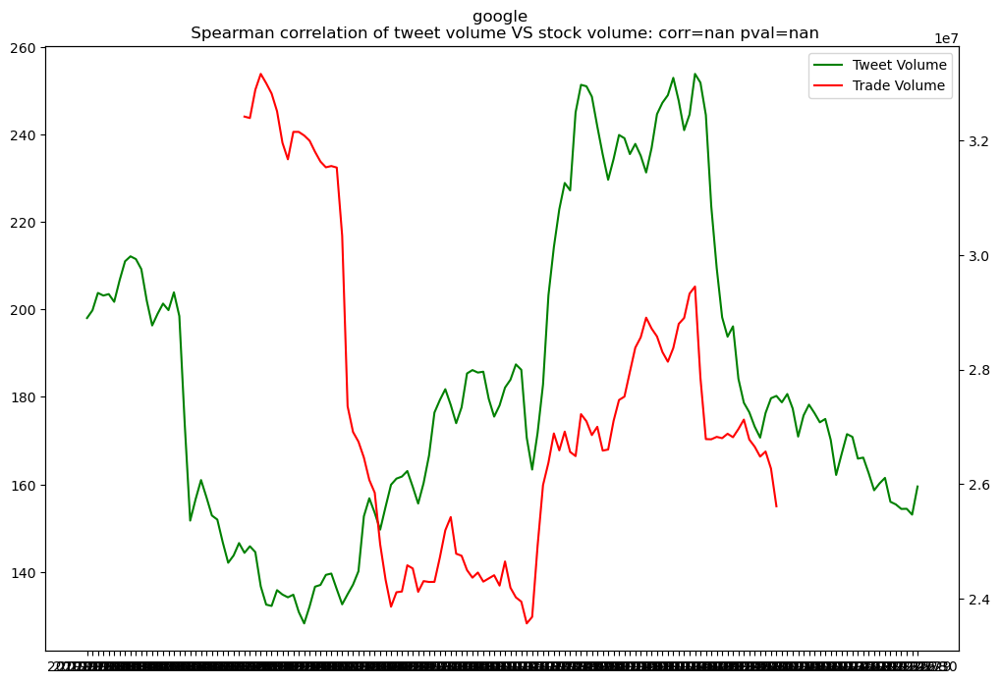

In [15]:
tweet_v_imp(ggl_tweet,google_stock,"google")  


/var/folders/xl/bkp1f6b120x9rzphm4m9hb4h0000gn/T/ipykernel_1315/3427085415.py:11: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  a2 = f.add_subplot()


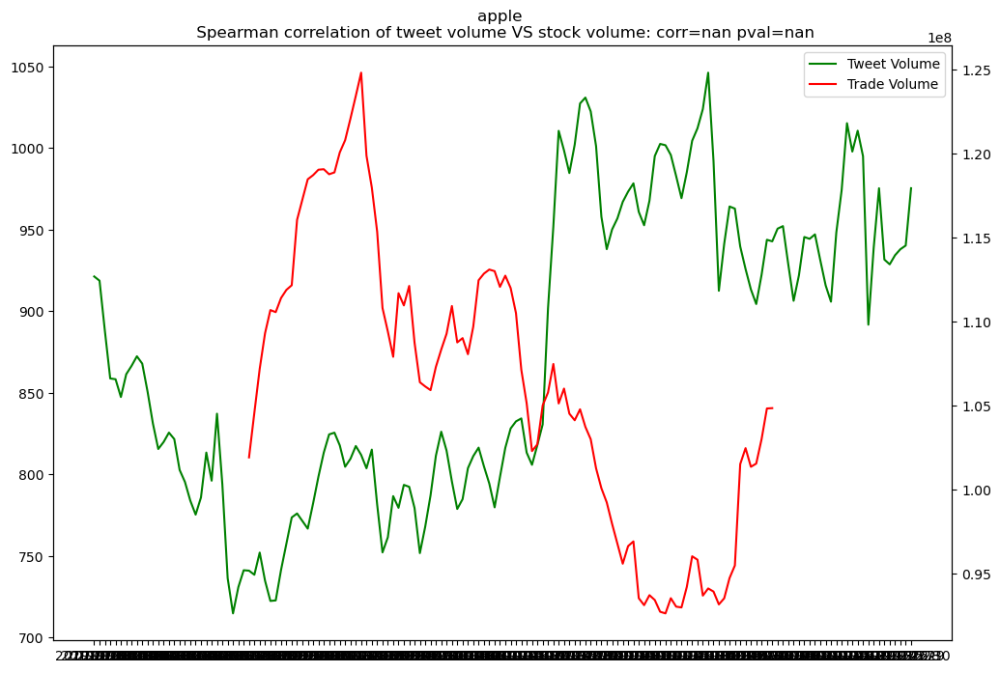

In [18]:
tweet_v_imp(apl_tweet,apple_stock,"apple")  

/var/folders/xl/bkp1f6b120x9rzphm4m9hb4h0000gn/T/ipykernel_1315/3427085415.py:11: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  a2 = f.add_subplot()


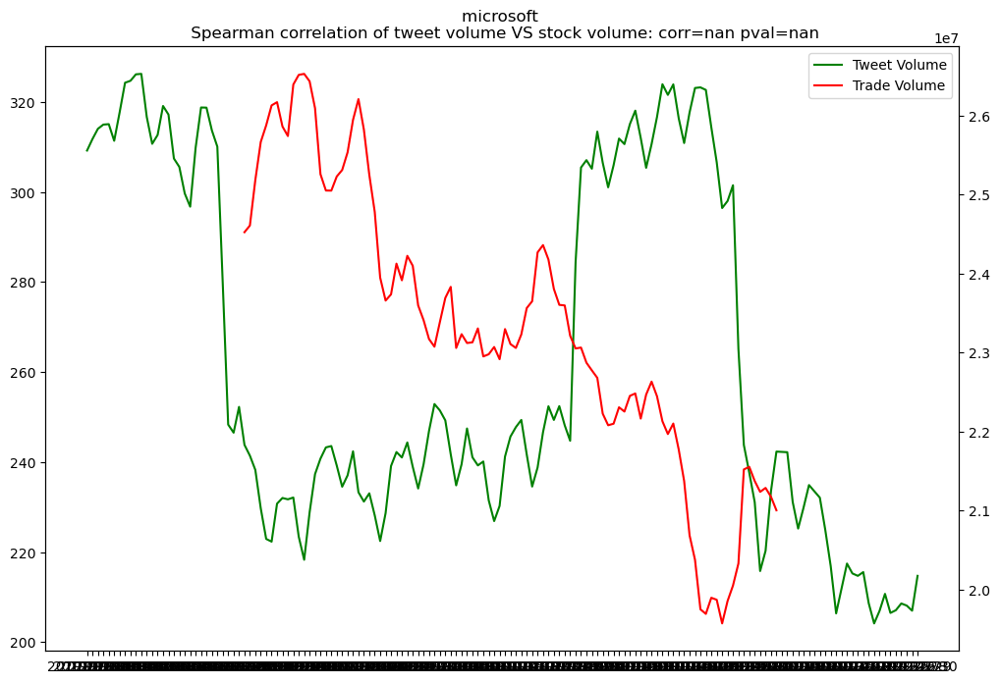

In [21]:
tweet_v_imp(msft_tweet,microsoft_stock,"microsoft")  



From the above plots the hypotheses is null, which implies there is no association between the number of tweets and the volume of stocks.So this is the reason we are not using them in prediction

7)Below we compute correlation between Sentiment score and stock prices.

In [241]:
senti_tweets = senti_tweets.loc[:, ~senti_tweets.columns.str.contains('^Unnamed')]
senti_tweets.corr()


,tweet_id,comment_num,retweet_num,like_num,compound,neg,neu,pos,Prices
tweet_id,1.000000,0.021192,0.025393,0.020464,0.002255,-0.010461,0.044747,-0.060039,0.054666
comment_num,0.021192,1.000000,0.586073,0.722103,0.007050,0.082808,-0.057008,-0.004123,-0.040156
retweet_num,0.025393,0.586073,1.000000,0.782720,0.007618,0.065124,-0.044445,-0.004322,-0.034078
like_num,0.020464,0.722103,0.782720,1.000000,0.005139,0.151537,-0.126029,0.027194,-0.098209
compound,0.002255,0.007050,0.007618,0.005139,1.000000,0.055544,-0.158769,0.188174,-0.259259
neg,-0.010461,0.082808,0.065124,0.151537,0.055544,1.000000,-0.776900,0.104378,-0.643341
neu,0.044747,-0.057008,-0.044445,-0.126029,-0.158769,-0.776900,1.000000,-0.707031,0.551838
pos,-0.060039,-0.004123,-0.004322,0.027194,0.188174,0.104378,-0.707031,1.000000,-0.148723
Prices,0.054666,-0.040156,-0.034078,-0.098209,-0.259259,-0.643341,0.551838,-0.148723,1.000000


<AxesSubplot: >

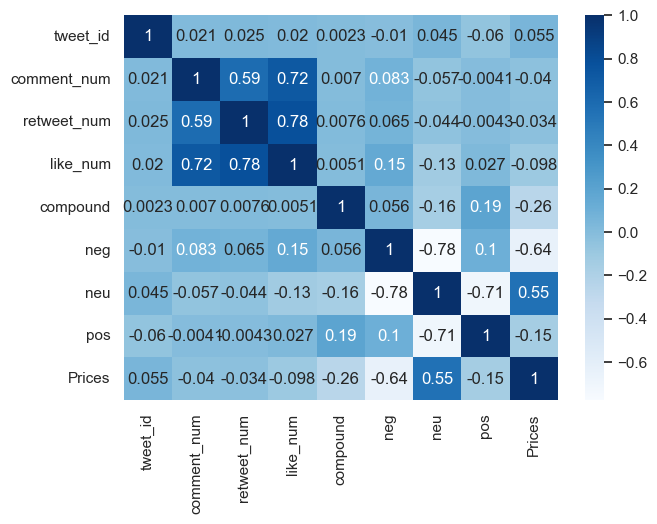

In [242]:
plt.figure(figsize=(7,5))
sns.heatmap(senti_tweets.corr(),cmap='Blues',annot=True)


<AxesSubplot: >

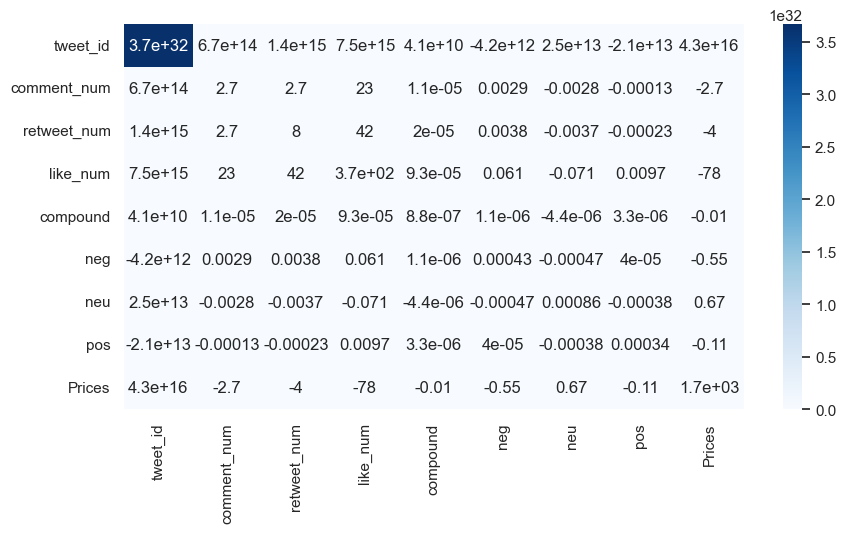

In [243]:
plt.figure(figsize=(10,5))
sns.heatmap(senti_tweets.cov(),cmap='Blues',annot=True)


This analysis has a modest negative effect, but the correlation diagram shown above does not allow us to draw any conclusions.

8) Below we analyse the stock market data and find insights.

when we try to keenly observe the amazon stock data we can observe that the standard deviation of the stock is almost 4 and the mean,max and min of Adjacent Close and Open is the average of mean of High and Low.

In [258]:
amzn_stock.describe()

,Unnamed: 0,High,Low,Open,Close,Volume,Adj Close
count,128.000000,128.000000,128.000000,128.000000,128.000000,1.280000e+02,128.000000
mean,63.500000,91.238039,89.907613,90.662309,90.617902,6.323112e+07,90.617902
std,37.094474,3.954108,3.910021,3.932296,3.957037,2.268687e+07,3.957037
min,0.000000,86.250000,84.252998,84.877502,85.275497,1.762600e+07,85.275497
25%,31.750000,88.608252,87.269377,88.051752,88.061623,5.006850e+07,88.061623
50%,63.500000,89.918751,88.856251,89.571003,89.382751,5.783400e+07,89.382751
75%,95.250000,92.049376,90.757250,91.411877,91.586748,7.076700e+07,91.586748
max,127.000000,101.790001,100.193497,101.280998,101.049500,1.925280e+08,101.049500


In the Apple Stock we can observe that the standard deviation of the stock is almost 4 and the mean,max and min of Adjacent Close and Open is the average of mean of High and Low.

In [259]:
apple_stock.describe()

,Unnamed: 0,High,Low,Open,Close,Volume,Adj Close
count,128.000000,128.000000,128.000000,128.000000,128.000000,1.280000e+02,128.000000
mean,63.500000,58.710859,57.776172,58.206914,58.306191,1.047292e+08,56.966426
std,37.094474,6.990016,6.979905,6.961190,7.064238,4.034368e+07,7.021087
min,0.000000,49.517502,48.145000,48.852501,48.334999,4.544800e+07,47.032280
25%,31.750000,52.325002,51.678124,52.064375,52.064374,7.672980e+07,50.661133
50%,63.500000,56.042500,55.144999,55.633749,55.834999,9.650020e+07,54.536558
75%,95.250000,65.721876,65.117498,65.271252,65.456249,1.216229e+08,64.126015
max,127.000000,73.492500,72.379997,72.779999,73.412498,2.771256e+08,71.920570


In the Google Stock we can observe that the standard deviation of the stock is almost 3.5 and the mean,max and min of Adjacent Close and Open is the average of mean of High and Low.

In [260]:
google_stock.describe()

,Unnamed: 0,High,Low,Open,Close,Volume,Adj Close
count,128.000000,128.000000,128.000000,128.000000,128.000000,1.280000e+02,128.000000
mean,63.500000,62.286242,61.405695,61.809906,61.862262,2.742192e+07,61.862262
std,37.094474,3.473300,3.540934,3.509180,3.489669,1.187991e+07,3.489669
min,0.000000,55.429501,54.766499,55.051998,55.000000,1.280200e+07,55.000000
25%,31.750000,59.870876,58.645001,59.235624,59.160748,2.080400e+07,59.160748
50%,63.500000,62.018251,61.087000,61.375000,61.537750,2.540100e+07,61.537750
75%,95.250000,65.375626,64.554998,64.841877,64.873873,3.018500e+07,64.873873
max,127.000000,68.352501,67.650002,68.199997,68.123497,1.212160e+08,68.123497


In the Microsoft Stock we can observe that the standard deviation of the stock is almost 7 and the max and min of Adjacent Close and Open is the average of mean of High and Low.We can also see that the Adjacent close is not near Close and they have a significant amount of difference.

In [261]:
microsoft_stock.describe()

,Unnamed: 0,High,Low,Open,Close,Volume,Adj Close
count,128.000000,128.000000,128.000000,128.000000,128.000000,1.280000e+02,128.000000
mean,63.500000,143.110781,141.130078,142.287344,142.209375,2.291645e+07,137.788017
std,37.094474,6.691844,7.022202,6.760411,6.921072,7.266982e+06,6.960029
min,0.000000,133.929993,130.779999,133.300003,132.210007,8.989200e+06,127.671219
25%,31.750000,138.342506,136.267502,137.177502,137.210003,1.780732e+07,132.841473
50%,63.500000,140.324997,138.224998,139.625000,139.120003,2.142130e+07,134.771988
75%,95.250000,147.780006,146.372498,146.810005,147.497498,2.543070e+07,142.908195
max,127.000000,159.550003,158.220001,159.449997,158.960007,5.347750e+07,154.538132


In the Tesla Stock we can observe that the standard deviation of the stock is almost 4 and the mean,max and min of Adjacent Close and Open is almost as High.

In [262]:
tesla_stock.describe()

,Unnamed: 0,High,Low,Open,Close,Volume,Adj Close
count,128.000000,128.000000,128.000000,128.000000,128.000000,1.280000e+02,128.000000
mean,63.500000,18.921917,18.355068,18.611859,18.673776,1.244222e+08,18.673776
std,37.094474,4.068557,3.968324,3.993330,4.040021,6.606942e+07,4.040021
min,0.000000,14.334667,14.066667,14.240000,14.093333,3.698400e+07,14.093333
25%,31.750000,15.714167,15.228667,15.436334,15.556000,8.101012e+07,15.556000
50%,63.500000,16.819333,16.324333,16.495000,16.499666,1.081882e+08,16.499666
75%,95.250000,22.504000,21.906667,22.178167,22.202167,1.402084e+08,22.202167
max,127.000000,29.020666,28.423332,29.000000,28.729334,4.500915e+08,28.729334


Line graph of Adjacent Close with respect to Date for all Stocks

In this plot we can clearly see that the Amazon Stock had a huge dip during early august i.e, from a price of 100 to 90 and in the consequent months it was consistently around and wasn't successful enough to bounce from that price.

Text(0.5, 1.0, 'AMAZON DATE VS ADJ CLOSE')

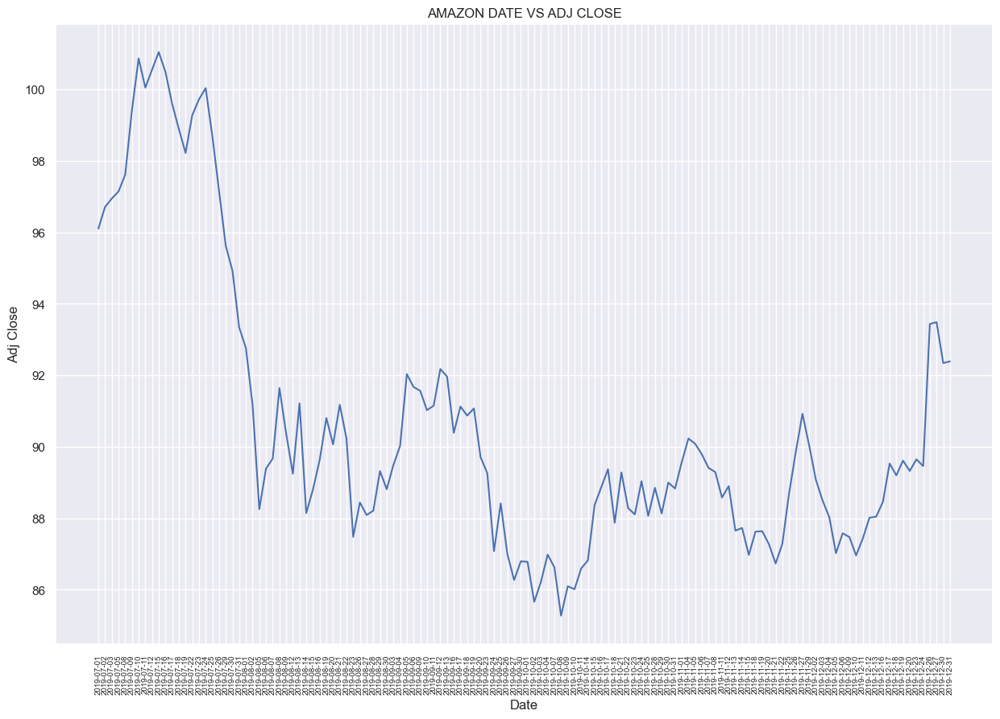

In [272]:
plt.figure(figsize=(15,10))
df=amzn_stock
plt.plot(amzn_stock['Date'],amzn_stock['Adj Close'])
plt.xticks(fontsize=7, rotation=90)
plt.xlabel('Date')
plt.ylabel('Adj Close')
plt.title('AMAZON DATE VS ADJ CLOSE')


In the below plot of Apple Stock we can observe that the stock price has grown rapidly with a positive slope.

Text(0.5, 1.0, 'APPLE DATE VS ADJ CLOSE')

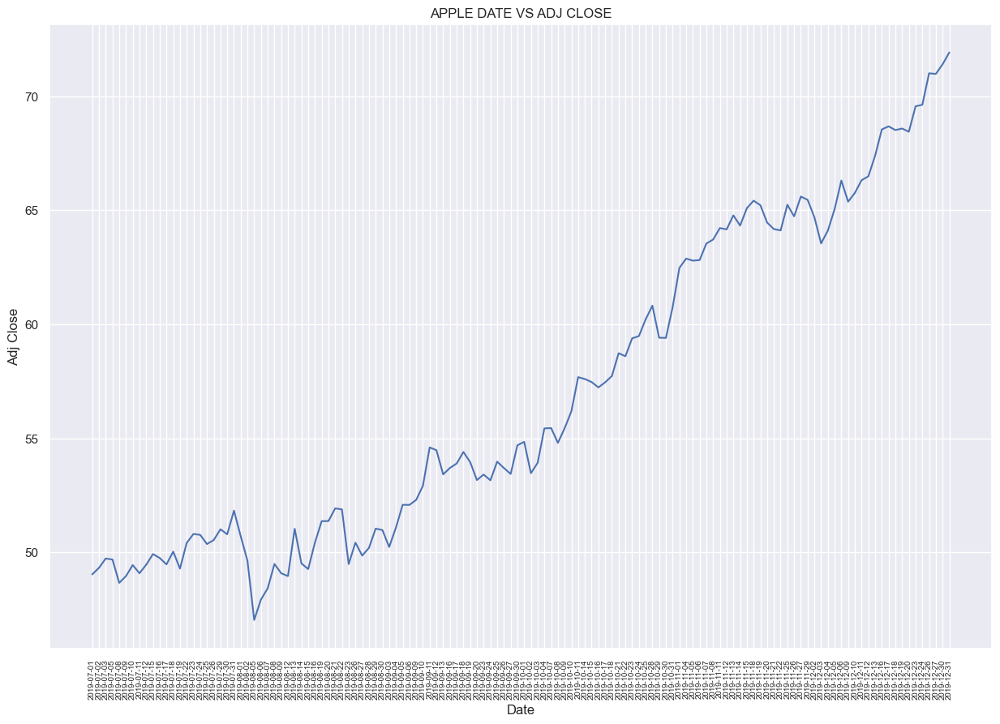

In [273]:
plt.figure(figsize=(15,10))
df=apple_stock
plt.plot(apple_stock['Date'],apple_stock['Adj Close'])
plt.xticks(fontsize=7, rotation=90)
plt.xlabel('Date')
plt.ylabel('Adj Close')
plt.title('APPLE DATE VS ADJ CLOSE')


Similar to Apple the Google Stock price has grown in the months except for a huge spike in early august.

Text(0.5, 1.0, 'GOOGLE DATE VS ADJ CLOSE')

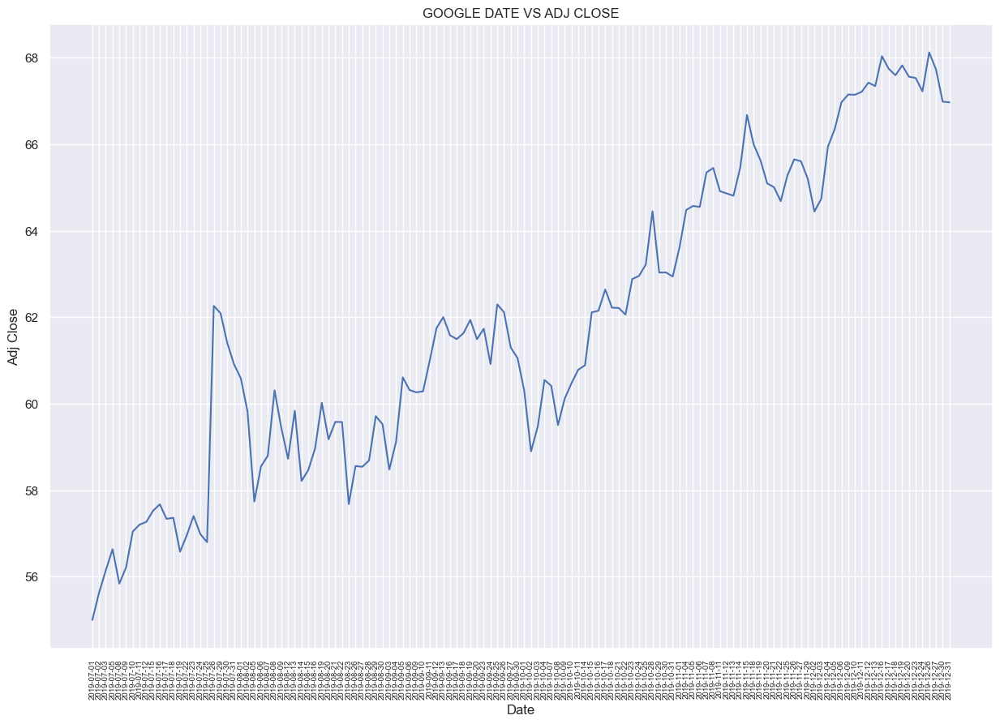

In [274]:
plt.figure(figsize=(15,10))
df=google_stock
plt.plot(google_stock['Date'],google_stock['Adj Close'])
plt.xticks(fontsize=7, rotation=90)
plt.xlabel('Date')
plt.ylabel('Adj Close')
plt.title('GOOGLE DATE VS ADJ CLOSE')


Unlike the above plots the moving average of Microsoft Stock was around 135 till the mid october and from then there was a gradual increase.

Text(0.5, 1.0, 'MICROSOFT DATE VS ADJ CLOSE')

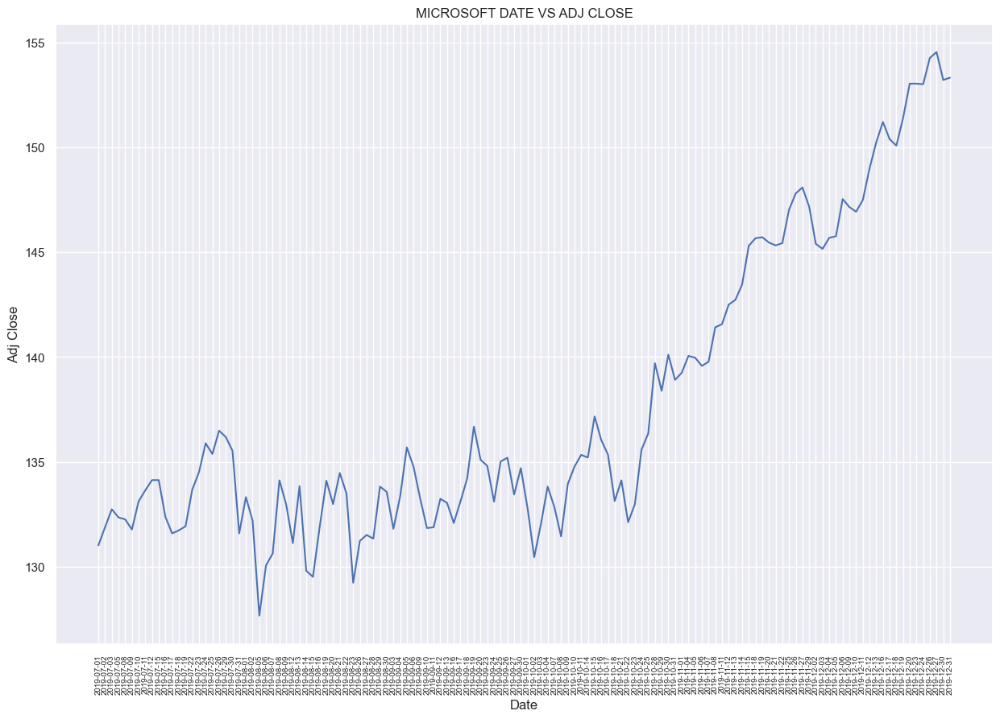

In [276]:
plt.figure(figsize=(15,10))
df=microsoft_stock
plt.plot(microsoft_stock['Date'],microsoft_stock['Adj Close'])
plt.xticks(fontsize=7, rotation=90)
plt.xlabel('Date')
plt.ylabel('Adj Close')
plt.title('MICROSOFT DATE VS ADJ CLOSE')



The plot of Tesla Stock is similar to Microsoft Stock.

Text(0.5, 1.0, 'TESLA DATE VS ADJ CLOSE')

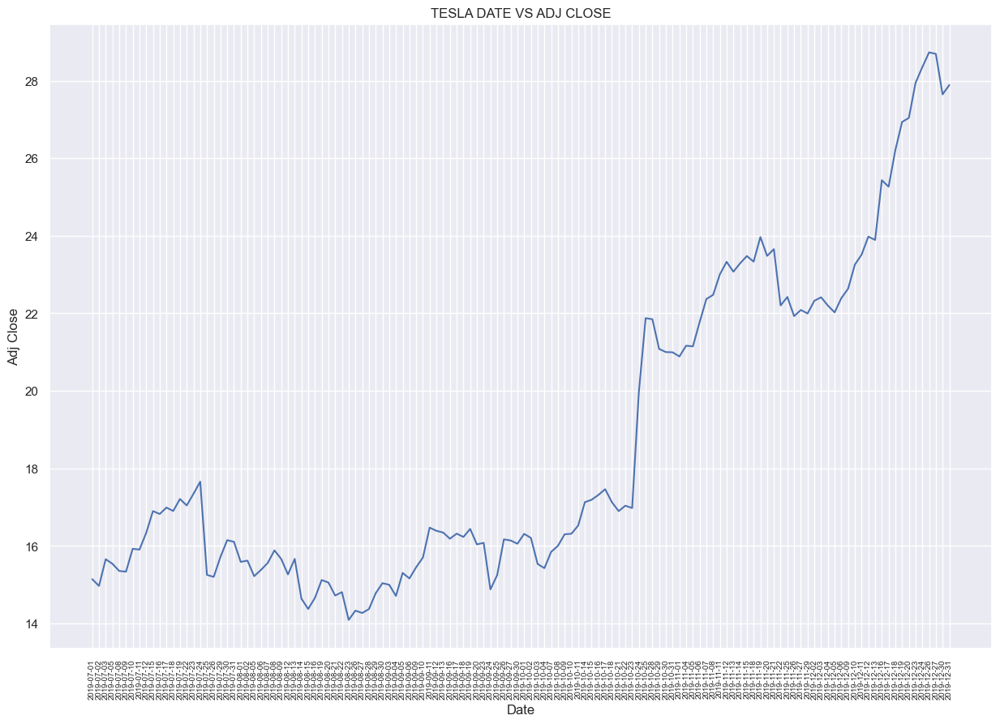

In [279]:
plt.figure(figsize=(15,10))
df=tesla_stock
plt.plot(tesla_stock['Date'],tesla_stock['Adj Close'])
plt.xticks(fontsize=7, rotation=90)
plt.xlabel('Date')
plt.ylabel('Adj Close')
plt.title('TESLA DATE VS ADJ CLOSE')



Line graph of Volume with respect to Date for all Stocks

Apple and Google have their maximum volume at early august whereas Amazon and Tesla has its maximum volume at early october and Microsoft during mid December.All the stocks excluding Microsoft has very low peaks in between and Microsoft has the highest volume of stocks traded between the period.

Text(0.5, 1.0, 'AMAZON DATE VS Volume')

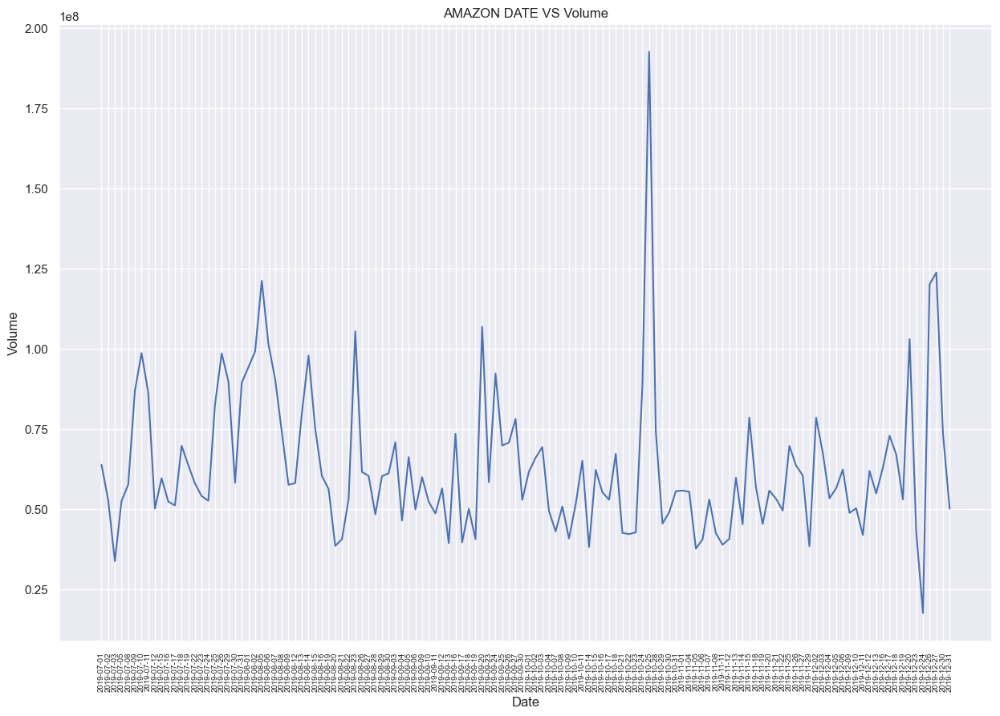

In [280]:
plt.figure(figsize=(15,10))
df=amzn_stock
plt.plot(amzn_stock['Date'],amzn_stock['Volume'])
plt.xticks(fontsize=7, rotation=90)
plt.xlabel('Date')
plt.ylabel('Volume')
plt.title('AMAZON DATE VS Volume')


Text(0.5, 1.0, 'APPLE DATE VS Volume')

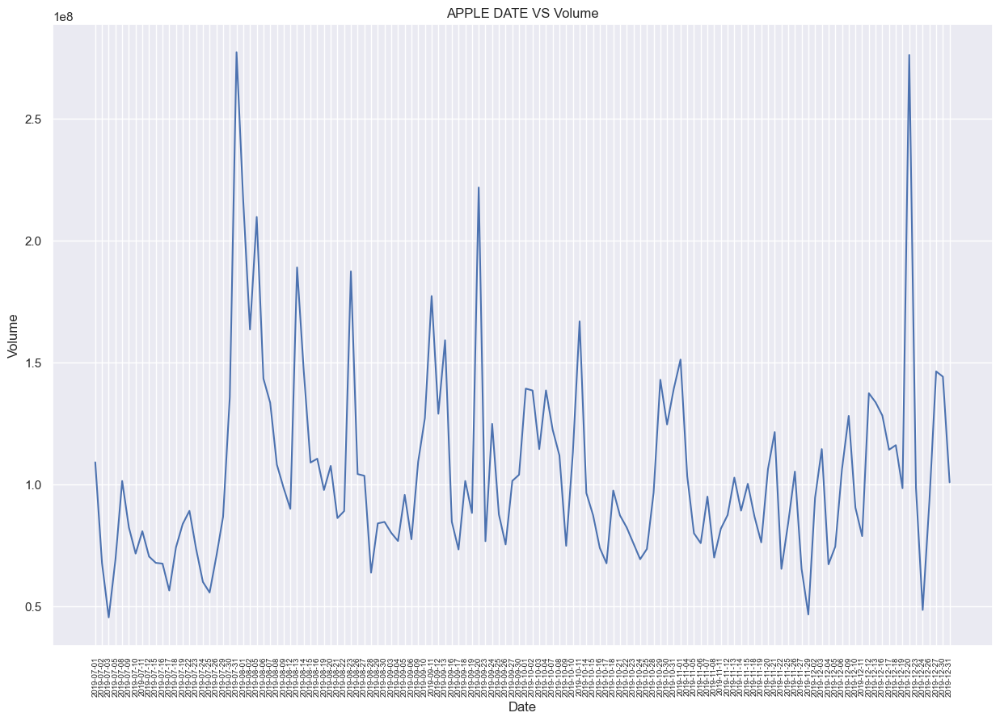

In [281]:
plt.figure(figsize=(15,10))
plt.plot(apple_stock['Date'],apple_stock['Volume'])
plt.xticks(fontsize=7, rotation=90)
plt.xlabel('Date')
plt.ylabel('Volume')
plt.title('APPLE DATE VS Volume')


Text(0.5, 1.0, 'GOOGLE DATE VS Volume')

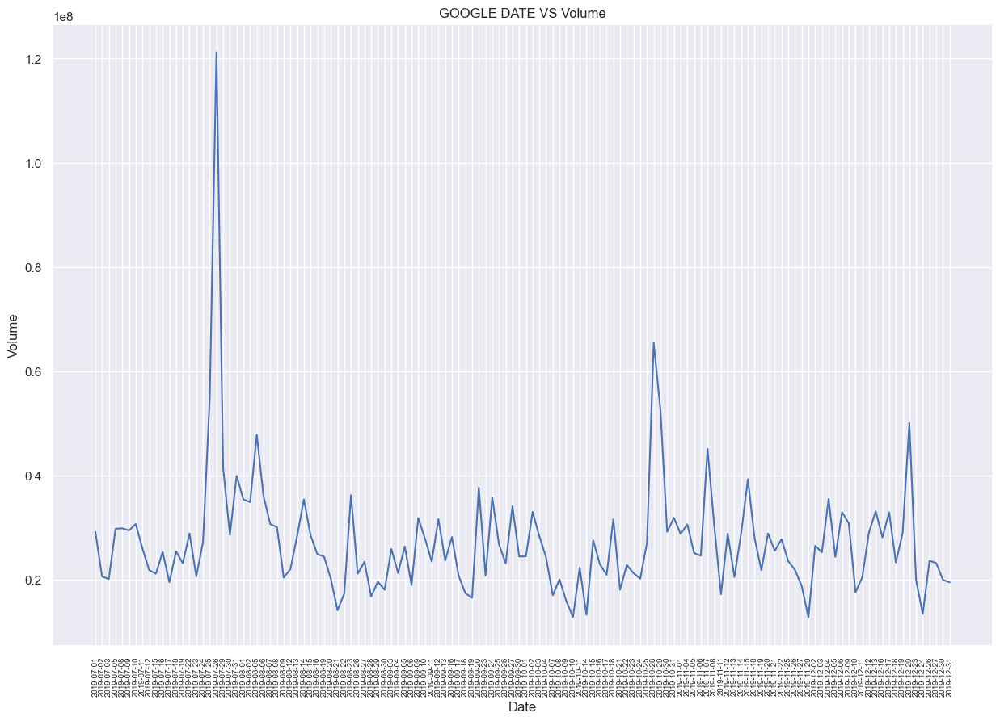

In [282]:
plt.figure(figsize=(15,10))
plt.plot(google_stock['Date'],google_stock['Volume'])
plt.xticks(fontsize=7, rotation=90)
plt.xlabel('Date')
plt.ylabel('Volume')
plt.title('GOOGLE DATE VS Volume')


Text(0.5, 1.0, 'MICROSOFT DATE VS Volume')

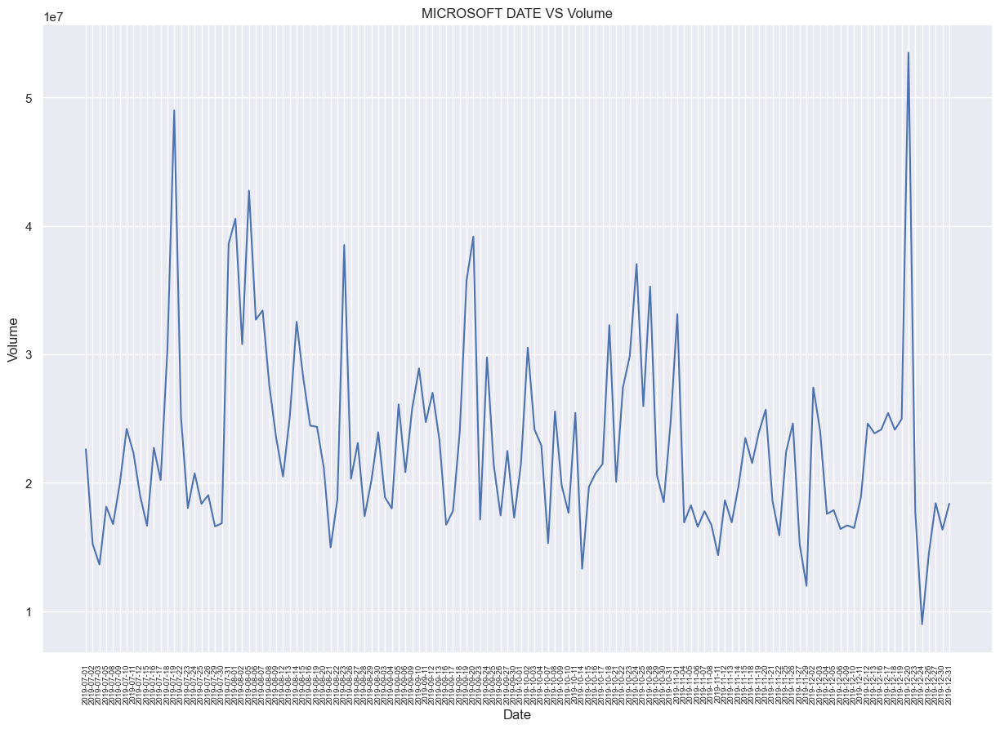

In [283]:
plt.figure(figsize=(15,10))
plt.plot(microsoft_stock['Date'],microsoft_stock['Volume'])
plt.xticks(fontsize=7, rotation=90)
plt.xlabel('Date')
plt.ylabel('Volume')
plt.title('MICROSOFT DATE VS Volume')



Text(0.5, 1.0, 'TESLA DATE VS Volume')

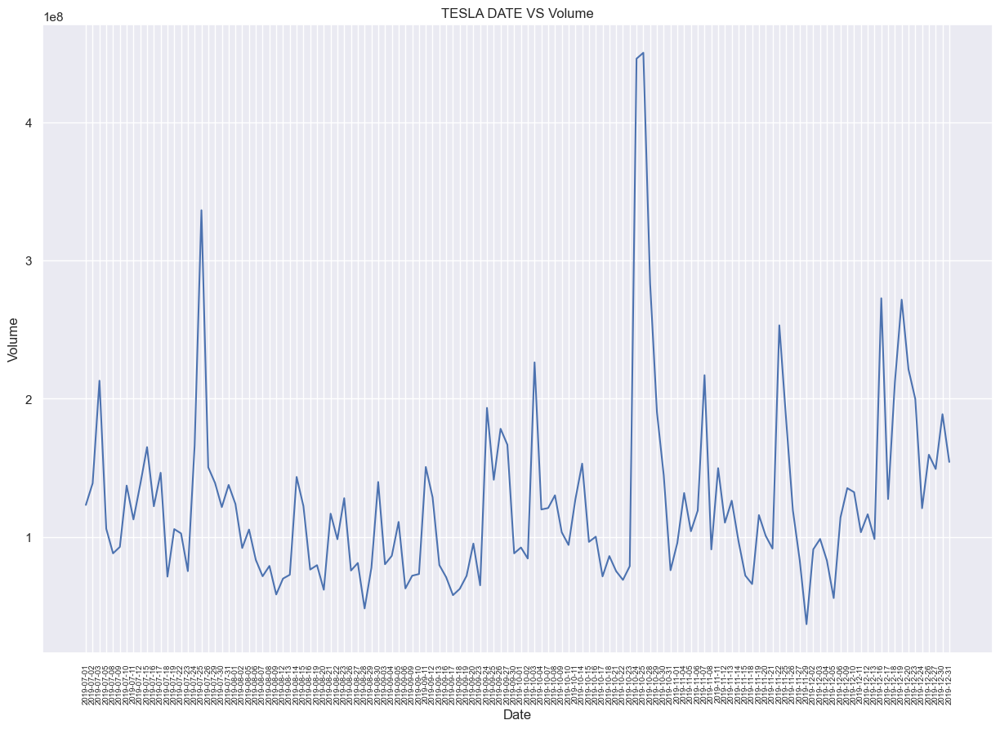

In [284]:
plt.figure(figsize=(15,10))
plt.plot(tesla_stock['Date'],tesla_stock['Volume'])
plt.xticks(fontsize=7, rotation=90)
plt.xlabel('Date')
plt.ylabel('Volume')
plt.title('TESLA DATE VS Volume')


ScatterPlot of Adj Close with respect to Volume for all Stocks.

Excluding google all the stocks have their maximum volume traded on their lower prices so this tells that even if the tweets impact the price at their high price people are less likely to trade in that.

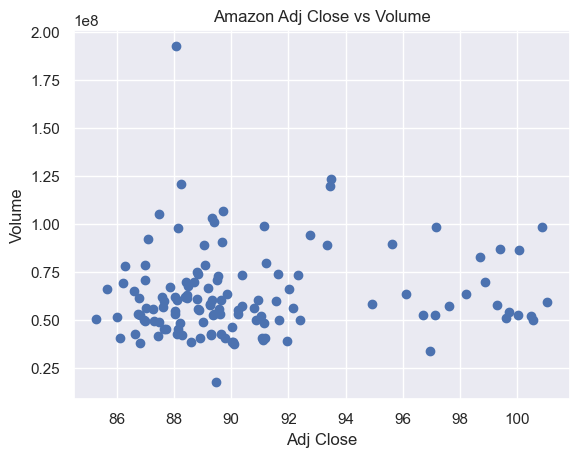

In [285]:
plt.scatter(amzn_stock['Adj Close'],amzn_stock['Volume'])
plt.title("Amazon Adj Close vs Volume")
plt.xlabel('Adj Close')
plt.ylabel('Volume')
plt.show()


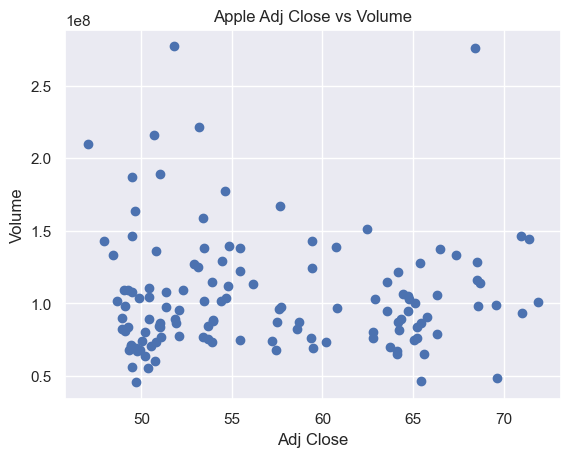

In [286]:
plt.scatter(apple_stock['Adj Close'],apple_stock['Volume'])
plt.title("Apple Adj Close vs Volume")
plt.xlabel('Adj Close')
plt.ylabel('Volume')
plt.show()


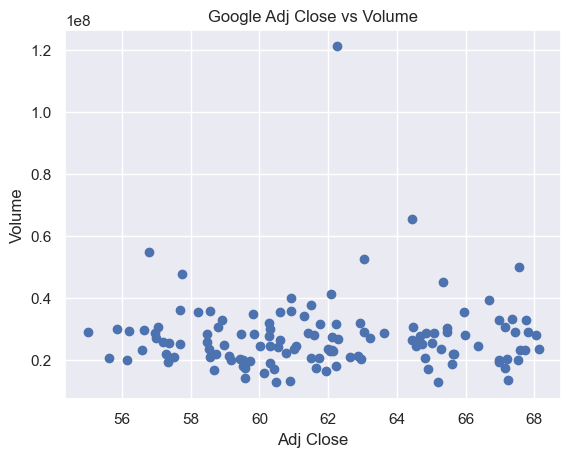

In [287]:
plt.scatter(google_stock['Adj Close'],google_stock['Volume'])
plt.title("Google Adj Close vs Volume")
plt.xlabel('Adj Close')
plt.ylabel('Volume')
plt.show()


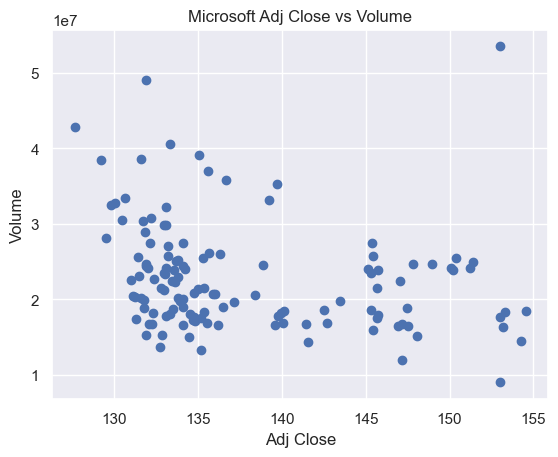

In [288]:
plt.scatter(microsoft_stock['Adj Close'],microsoft_stock['Volume'])
plt.title("Microsoft Adj Close vs Volume")
plt.xlabel('Adj Close')
plt.ylabel('Volume')
plt.show()

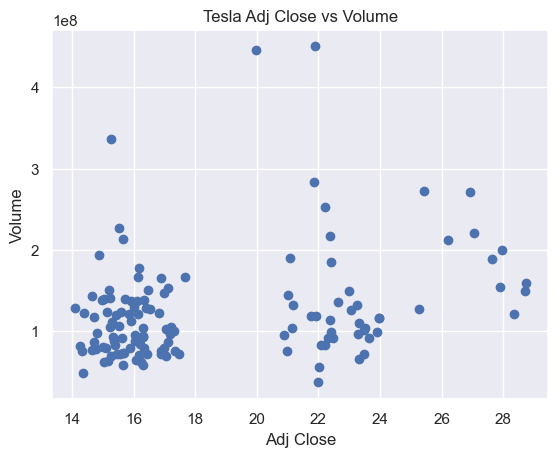

In [289]:
plt.scatter(tesla_stock['Adj Close'],tesla_stock['Volume'])
plt.title("Tesla Adj Close vs Volume")
plt.xlabel('Adj Close')
plt.ylabel('Volume')
plt.show()


Scatter Matrix for all the stocks

In [290]:
def ScatterMatrix(df, plotSize, textSize):
    df = df.select_dtypes(include =[np.number]) 
    df = df.dropna('columns')
    df = df[[col for col in df if df[col].nunique() > 1]] 
    ax = pd.plotting.scatter_matrix(df, alpha=0.75, figsize=[plotSize, plotSize], diagonal='kde')
    corrs = df.corr().values
    for i, j in zip(*plt.np.triu_indices_from(ax, k = 1)):
        ax[i, j].annotate('Corr. coef = %.3f' % corrs[i, j], (0.8, 0.2), xycoords='axes fraction', ha='center', va='center', size=textSize)
    plt.suptitle('Scatter plot and Density Plot')
    plt.show()


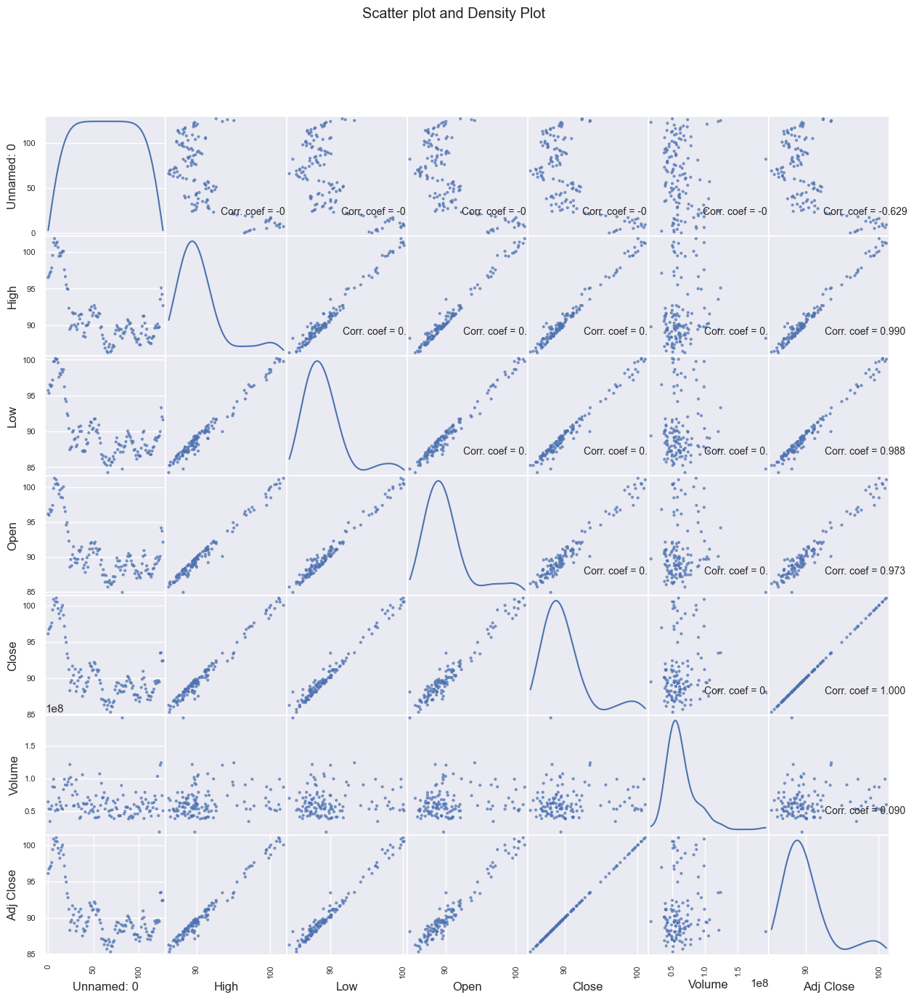

In [291]:
ScatterMatrix(amzn_stock, 15, 10)


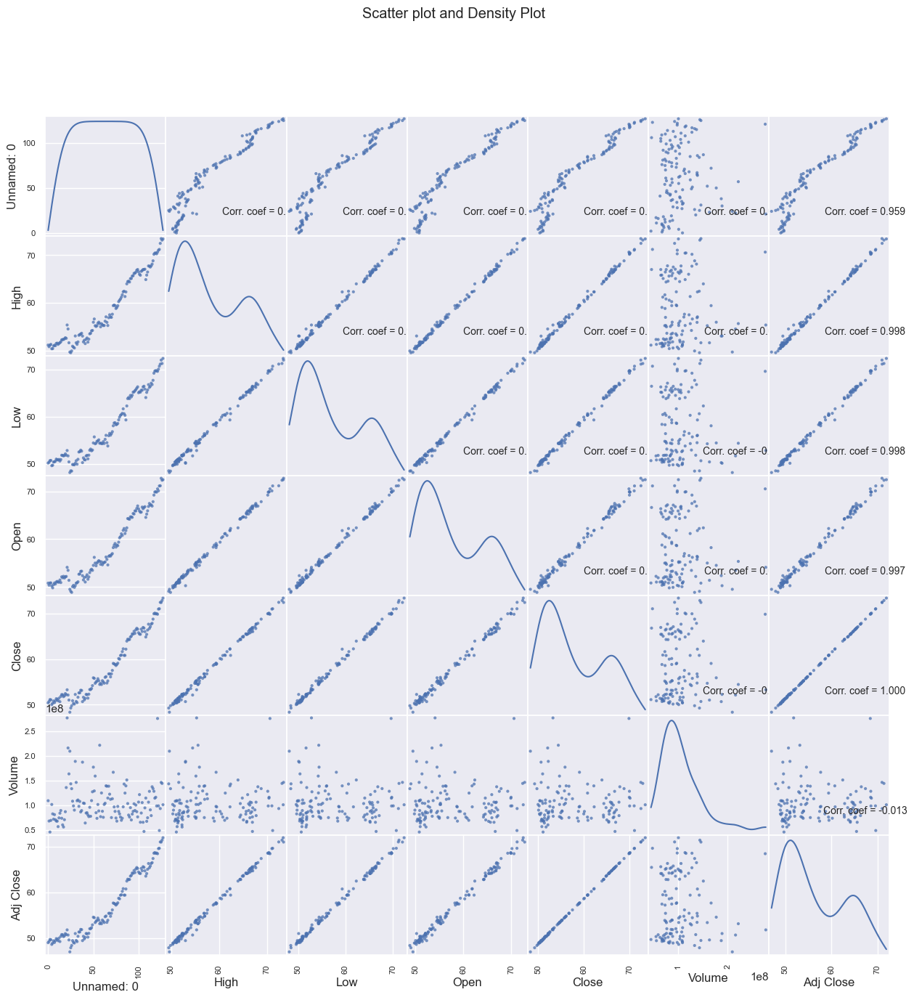

In [292]:
ScatterMatrix(apple_stock, 15, 10)

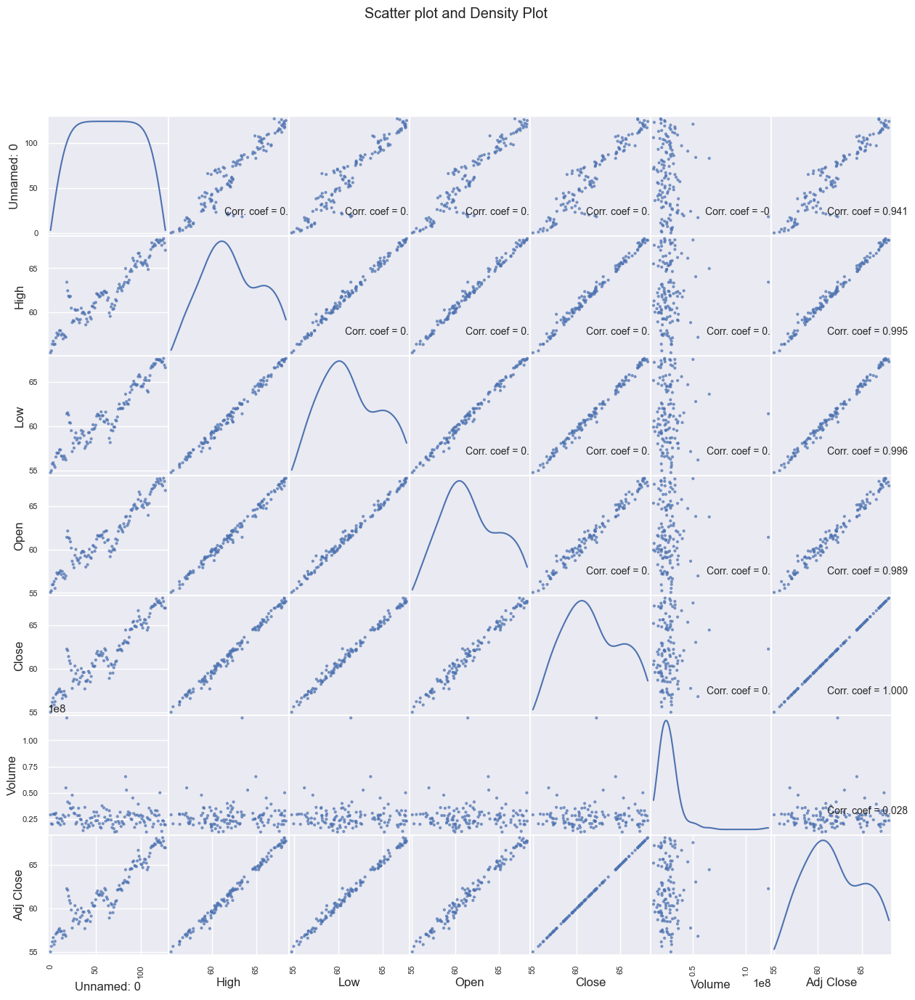

In [293]:
ScatterMatrix(google_stock, 15, 10)

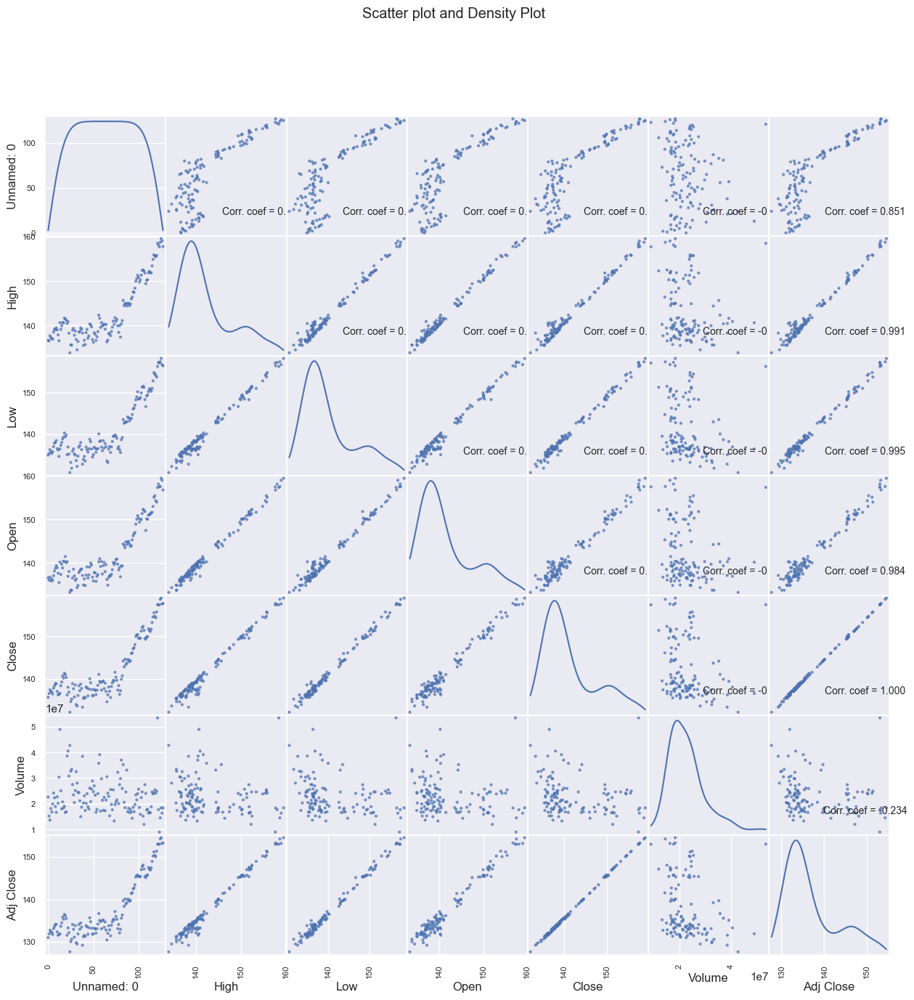

In [294]:
ScatterMatrix(microsoft_stock, 15, 10)

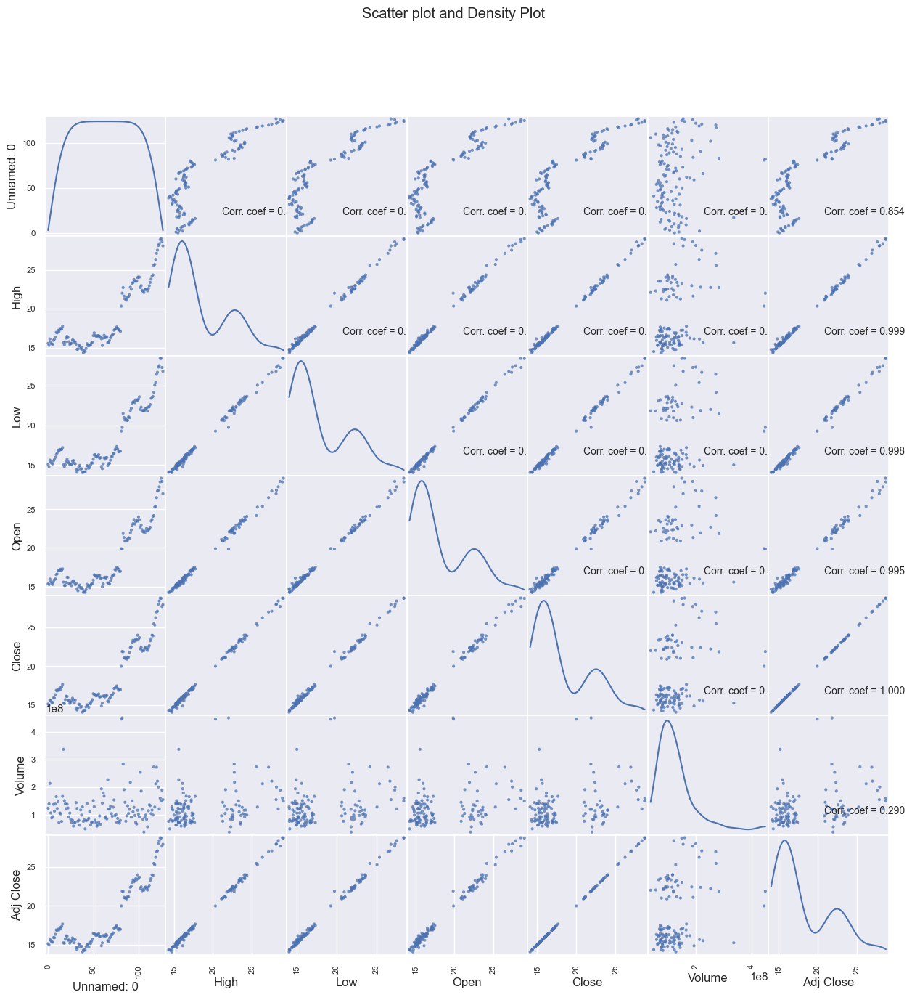

In [295]:
ScatterMatrix(tesla_stock, 15, 10)

From the Stocks Correlation Scatter Matrix we can observe that for all the stocks the the correlation coefficient for of volume with respect to Adjacent close or open is low.From this we can tell that they don't have a direct relation between them. However in the next step we will check if the Stock open or Adjacent price is also independent of tweet volume of particular stock.



9) On Tweets of each company, we try to find a date with max volume of tweets and try to find if the day with maximum tweets has any major impact on the stock price.

In [296]:
amzn_tweet.rename(columns={'post_date': 'Date'}, inplace=True)
amzn_tweet['Date'] = pd.to_datetime(amzn_tweet['Date']).dt.date
amzn_tweet.groupby(["Date"]).count().sort_values("tweet_id").groupby(level=0).tail()



,Unnamed: 0,tweet_id,writer,body,comment_num,retweet_num,like_num,ticker_symbol,vader_score,vader_sentiment,day,month
Date,,,,,,,,,,,,
2019-07-15,36,36,36,36,36,36,36,36,36,36,36,36
2019-12-10,37,37,37,37,37,37,37,37,37,37,37,37
2019-10-22,79,79,79,79,79,79,79,79,79,79,79,79
2019-12-25,79,79,78,79,79,79,79,79,79,79,79,79
2019-10-06,93,93,92,93,93,93,93,93,93,93,93,93
...,...,...,...,...,...,...,...,...,...,...,...,...
2019-12-27,952,952,945,952,952,952,952,952,952,952,952,952
2019-07-25,956,956,949,956,956,956,956,956,956,956,956,956
2019-12-26,1296,1296,1289,1296,1296,1296,1296,1296,1296,1296,1296,1296


In [298]:
import pandas_datareader as web
import datetime as dt

start = dt.datetime(2019,10,20)
end = dt.datetime(2019,10,30)

a_stock = web.DataReader('AMZN', 'yahoo', start, end)

a_stock = a_stock.reset_index()


Text(0.5, 1.0, 'Amazon_stock price when the volume of tweets were maximum')

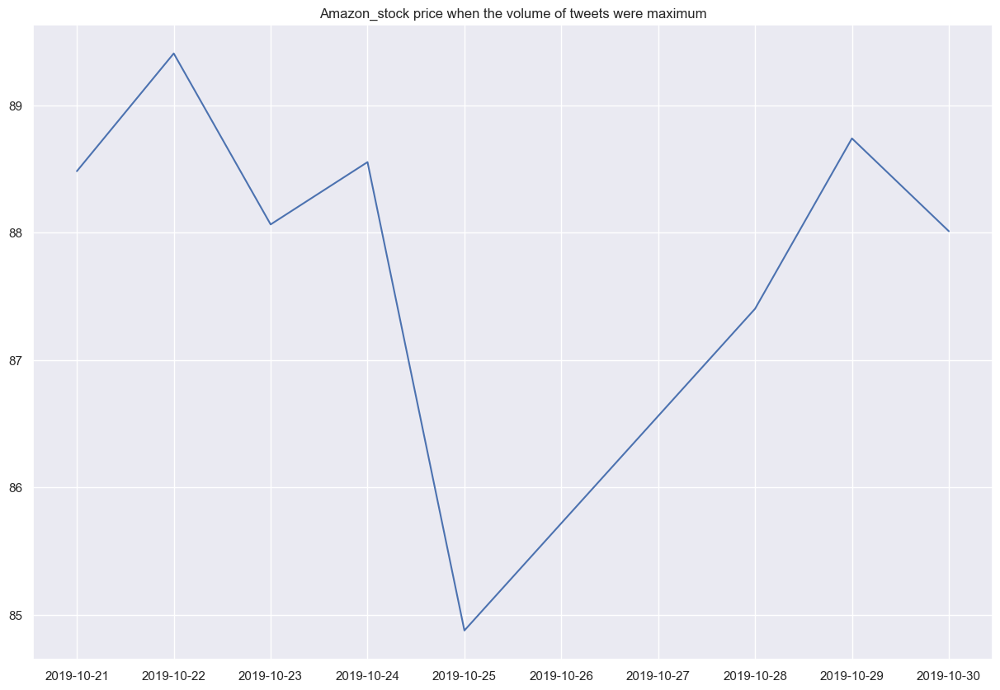

In [299]:
plt.figure(figsize=(15,10))
df=a_stock
plt.plot(a_stock['Date'],a_stock['Open'])
plt.title('Amazon_stock price when the volume of tweets were maximum')


In [301]:
import pandas_datareader as web
import datetime as dt

start = dt.datetime(2019,11,18)
end = dt.datetime(2019,11,27)

ap_stock = web.DataReader('AAPL', 'yahoo', start, end)

ap_stock = ap_stock.reset_index()


     

Text(0.5, 1.0, 'Apple_stock price when the volume of tweets were maximum')

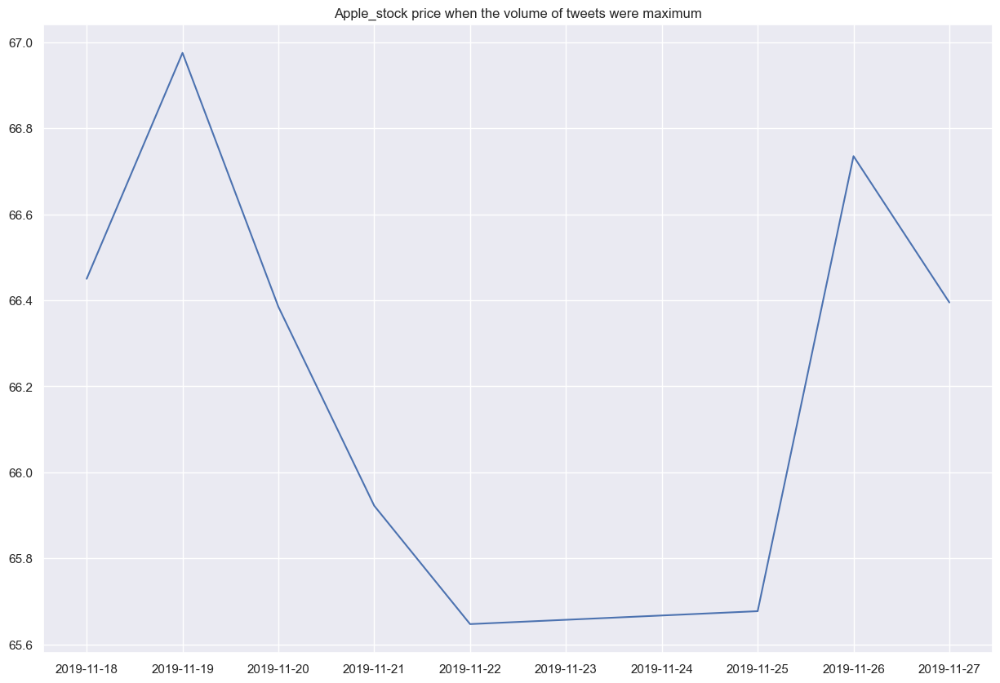

In [302]:
plt.figure(figsize=(15,10))
df=ap_stock
plt.plot(ap_stock['Date'],ap_stock['Open'])
plt.title('Apple_stock price when the volume of tweets were maximum')



Text(0.5, 1.0, 'Google_stock price when the volume of tweets were maximum')

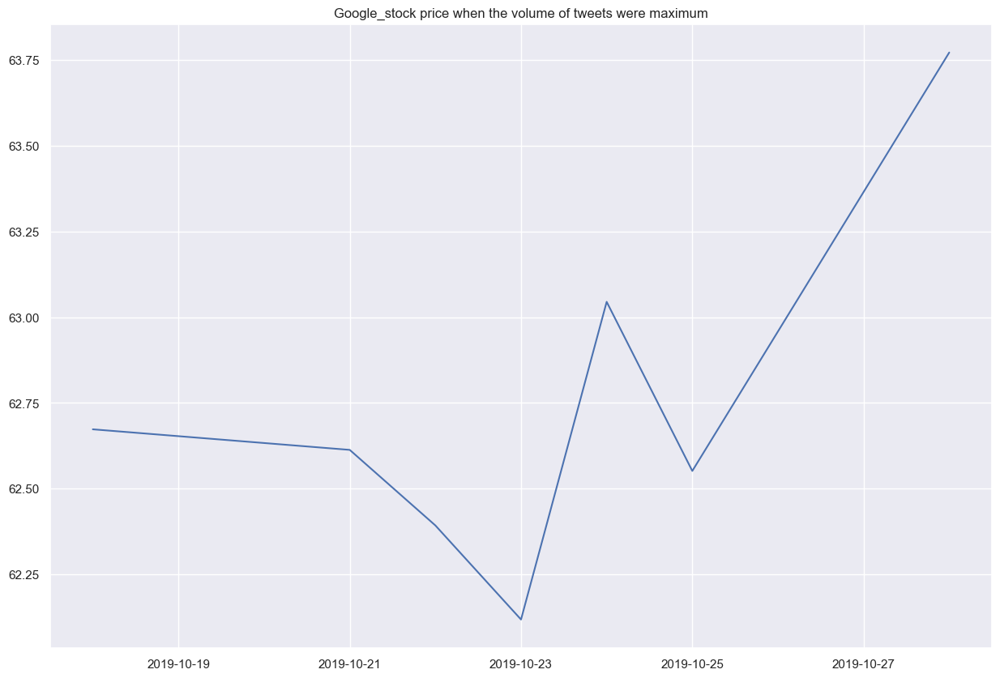

In [304]:
start = dt.datetime(2019,10,18)
end = dt.datetime(2019,10,28)

g_stock = web.DataReader('GOOG', 'yahoo', start, end)

g_stock = g_stock.reset_index()

plt.figure(figsize=(15,10))
df=g_stock
plt.plot(g_stock['Date'],g_stock['Open'])
plt.title('Google_stock price when the volume of tweets were maximum')


In [306]:
start = dt.datetime(2019,10,23)
end = dt.datetime(2019,11,2)

m_stock = web.DataReader('MSFT', 'yahoo', start, end)

m_stock = m_stock.reset_index()

Text(0.5, 1.0, 'Microsoft_stock price when the volume of tweets were maximum')

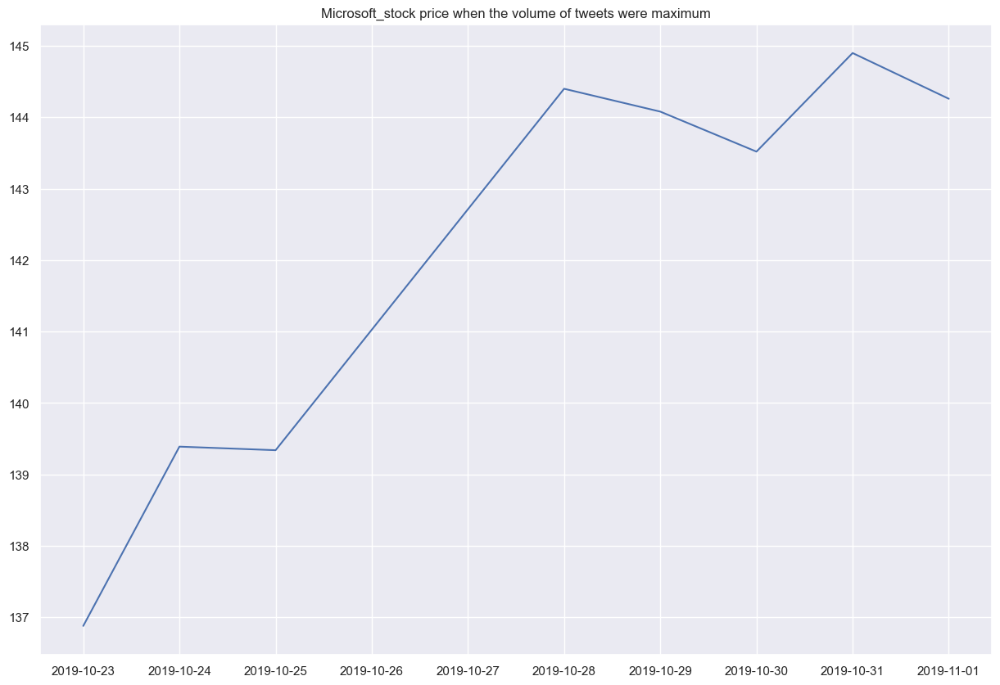

In [307]:
plt.figure(figsize=(15,10))
df=m_stock
plt.plot(m_stock['Date'],m_stock['Open'])
plt.title('Microsoft_stock price when the volume of tweets were maximum')


In [308]:
tesla_tweet.rename(columns={'post_date': 'Date'}, inplace=True)
tesla_tweet['Date'] = pd.to_datetime(tesla_tweet['Date']).dt.date
tesla_tweet.groupby(["Date"]).count().sort_values("tweet_id").groupby(level=0).tail()


,Unnamed: 0,tweet_id,writer,body,comment_num,retweet_num,like_num,ticker_symbol,vader_score,vader_sentiment,day,month
Date,,,,,,,,,,,,
2019-12-11,46,46,46,46,46,46,46,46,46,46,46,46
2019-11-22,78,78,78,78,78,78,78,78,78,78,78,78
2019-10-19,90,90,88,90,90,90,90,90,90,90,90,90
2019-10-29,101,101,60,101,101,101,101,101,101,101,101,101
2019-07-21,124,124,123,124,124,124,124,124,124,124,124,124
...,...,...,...,...,...,...,...,...,...,...,...,...
2019-09-13,1077,1077,1071,1077,1077,1077,1077,1077,1077,1077,1077,1077
2019-09-11,1377,1377,1368,1377,1377,1377,1377,1377,1377,1377,1377,1377
2019-10-30,1512,1512,1507,1512,1512,1512,1512,1512,1512,1512,1512,1512


In [309]:
start = dt.datetime(2019,7,25)
end = dt.datetime(2019,8,5)

t_stock = web.DataReader('TSLA', 'yahoo', start, end)

t_stock = t_stock.reset_index()



Text(0.5, 1.0, 'tesla_stock price when the volume of tweets were maximum')

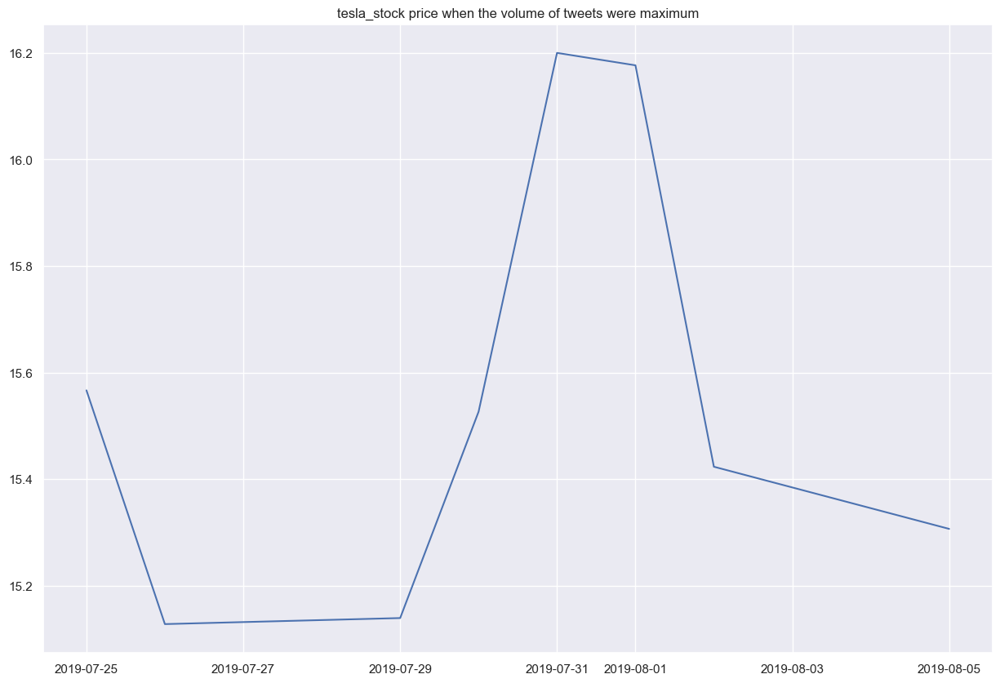

In [310]:
plt.figure(figsize=(15,10))
df=t_stock
plt.plot(t_stock['Date'],t_stock['Open'])
plt.title('tesla_stock price when the volume of tweets were maximum')



According to our graphs we can tell that Amazon and Google have a valid impact on the stock. As there is a drastic change in stock between its neighbor days.

Below we compute Correlation and Covariance matrices for all stocks

In [311]:
amzn_stock.corr()

,Unnamed: 0,High,Low,Open,Close,Volume,Adj Close
Unnamed: 0,1.000000,-0.641317,-0.613133,-0.639990,-0.628559,-0.131702,-0.628559
High,-0.641317,1.000000,0.987981,0.989077,0.989996,0.136068,0.989996
Low,-0.613133,0.987981,1.000000,0.988489,0.987965,0.020199,0.987965
Open,-0.639990,0.989077,0.988489,1.000000,0.973371,0.072747,0.973371
Close,-0.628559,0.989996,0.987965,0.973371,1.000000,0.090418,1.000000
Volume,-0.131702,0.136068,0.020199,0.072747,0.090418,1.000000,0.090418
Adj Close,-0.628559,0.989996,0.987965,0.973371,1.000000,0.090418,1.000000


In [312]:
amzn_stock.cov()


,Unnamed: 0,High,Low,Open,Close,Volume,Adj Close
Unnamed: 0,1.376000e+03,-9.406552e+01,-8.892892e+01,-9.335301e+01,-9.226253e+01,-1.108348e+08,-9.226253e+01
High,-9.406552e+01,1.563497e+01,1.527482e+01,1.537888e+01,1.549002e+01,1.220612e+07,1.549002e+01
Low,-8.892892e+01,1.527482e+01,1.528827e+01,1.519838e+01,1.528589e+01,1.791762e+06,1.528589e+01
Open,-9.335301e+01,1.537888e+01,1.519838e+01,1.546295e+01,1.514588e+01,6.489867e+06,1.514588e+01
Close,-9.226253e+01,1.549002e+01,1.528589e+01,1.514588e+01,1.565814e+01,8.117055e+06,1.565814e+01
Volume,-1.108348e+08,1.220612e+07,1.791762e+06,6.489867e+06,8.117055e+06,5.146939e+14,8.117055e+06
Adj Close,-9.226253e+01,1.549002e+01,1.528589e+01,1.514588e+01,1.565814e+01,8.117055e+06,1.565814e+01


In [313]:
apple_stock.corr()


,Unnamed: 0,High,Low,Open,Close,Volume,Adj Close
Unnamed: 0,1.000000,0.958341,0.955752,0.958401,0.957642,0.033514,0.959302
High,0.958341,1.000000,0.997487,0.998524,0.998020,0.025118,0.998023
Low,0.955752,0.997487,1.000000,0.997956,0.998199,-0.025688,0.998191
Open,0.958401,0.998524,0.997956,1.000000,0.996492,0.006059,0.996517
Close,0.957642,0.998020,0.998199,0.996492,1.000000,-0.012883,0.999954
Volume,0.033514,0.025118,-0.025688,0.006059,-0.012883,1.000000,-0.012804
Adj Close,0.959302,0.998023,0.998191,0.996517,0.999954,-0.012804,1.000000


In [314]:

apple_stock.cov()


,Unnamed: 0,High,Low,Open,Close,Volume,Adj Close
Unnamed: 0,1.376000e+03,2.484891e+02,2.474594e+02,2.474799e+02,2.509444e+02,5.015487e+07,2.498440e+02
High,2.484891e+02,4.886033e+01,4.866702e+01,4.858700e+01,4.928138e+01,7.083267e+06,4.898047e+01
Low,2.474594e+02,4.866702e+01,4.871907e+01,4.848914e+01,4.921890e+01,-7.233550e+06,4.891787e+01
Open,2.474799e+02,4.858700e+01,4.848914e+01,4.845817e+01,4.900299e+01,1.701748e+06,4.870491e+01
Close,2.509444e+02,4.928138e+01,4.921890e+01,4.900299e+01,4.990345e+01,-3.671609e+06,4.959635e+01
Volume,5.015487e+07,7.083267e+06,-7.233550e+06,1.701748e+06,-3.671609e+06,1.627613e+15,-3.626914e+06
Adj Close,2.498440e+02,4.898047e+01,4.891787e+01,4.870491e+01,4.959635e+01,-3.626914e+06,4.929567e+01


In [315]:
google_stock.corr()

,Unnamed: 0,High,Low,Open,Close,Volume,Adj Close
Unnamed: 0,1.000000,0.939748,0.943351,0.944014,0.941451,-0.112838,0.941451
High,0.939748,1.000000,0.994957,0.994512,0.995084,0.062506,0.995084
Low,0.943351,0.994957,1.000000,0.995017,0.995693,0.007356,0.995693
Open,0.944014,0.994512,0.995017,1.000000,0.988741,0.019325,0.988741
Close,0.941451,0.995084,0.995693,0.988741,1.000000,0.028186,1.000000
Volume,-0.112838,0.062506,0.007356,0.019325,0.028186,1.000000,0.028186
Adj Close,0.941451,0.995084,0.995693,0.988741,1.000000,0.028186,1.000000


In [316]:
google_stock.cov()


,Unnamed: 0,High,Low,Open,Close,Volume,Adj Close
Unnamed: 0,1.376000e+03,1.210773e+02,123.908357,122.883439,1.218684e+02,-4.972516e+07,1.218684e+02
High,1.210773e+02,1.206381e+01,12.236702,12.121547,1.206108e+01,2.579160e+06,1.206108e+01
Low,1.239084e+02,1.223670e+01,12.538217,12.363858,1.230347e+01,3.094185e+05,1.230347e+01
Open,1.228834e+02,1.212155e+01,12.363858,12.314347,1.210800e+01,8.056283e+05,1.210800e+01
Close,1.218684e+02,1.206108e+01,12.303467,12.107999,1.217779e+01,1.168511e+06,1.217779e+01
Volume,-4.972516e+07,2.579160e+06,309418.528950,805628.310429,1.168511e+06,1.411323e+14,1.168511e+06
Adj Close,1.218684e+02,1.206108e+01,12.303467,12.107999,1.217779e+01,1.168511e+06,1.217779e+01


In [317]:
microsoft_stock.corr()

,Unnamed: 0,High,Low,Open,Close,Volume,Adj Close
Unnamed: 0,1.000000,0.842994,0.839439,0.841284,0.839728,-0.156691,0.850990
High,0.842994,1.000000,0.991860,0.994944,0.990908,-0.167629,0.991012
Low,0.839439,0.991860,1.000000,0.989807,0.995033,-0.244059,0.994917
Open,0.841284,0.994944,0.989807,1.000000,0.983483,-0.186005,0.984116
Close,0.839728,0.990908,0.995033,0.983483,1.000000,-0.234970,0.999577
Volume,-0.156691,-0.167629,-0.244059,-0.186005,-0.234970,1.000000,-0.234181
Adj Close,0.850990,0.991012,0.994917,0.984116,0.999577,-0.234181,1.000000


In [318]:
microsoft_stock.cov()


,Unnamed: 0,High,Low,Open,Close,Volume,Adj Close
Unnamed: 0,1.376000e+03,2.092567e+02,2.186612e+02,2.109720e+02,2.155864e+02,-4.223850e+07,2.197075e+02
High,2.092567e+02,4.478078e+01,4.660898e+01,4.501088e+01,4.589364e+01,-8.151695e+06,4.615681e+01
Low,2.186612e+02,4.660898e+01,4.931132e+01,4.698906e+01,4.835977e+01,-1.245441e+07,4.862631e+01
Open,2.109720e+02,4.501088e+01,4.698906e+01,4.570316e+01,4.601645e+01,-9.138003e+06,4.630525e+01
Close,2.155864e+02,4.589364e+01,4.835977e+01,4.601645e+01,4.790123e+01,-1.181787e+07,4.815047e+01
Volume,-4.223850e+07,-8.151695e+06,-1.245441e+07,-9.138003e+06,-1.181787e+07,5.280903e+13,-1.184450e+07
Adj Close,2.197075e+02,4.615681e+01,4.862631e+01,4.630525e+01,4.815047e+01,-1.184450e+07,4.844201e+01


In [319]:
tesla_stock.corr()

,Unnamed: 0,High,Low,Open,Close,Volume,Adj Close
Unnamed: 0,1.000000,0.855879,0.854022,0.854030,0.854052,0.175141,0.854052
High,0.855879,1.000000,0.997817,0.997537,0.998680,0.301424,0.998680
Low,0.854022,0.997817,1.000000,0.998317,0.997653,0.257379,0.997653
Open,0.854030,0.997537,0.998317,1.000000,0.995146,0.269224,0.995146
Close,0.854052,0.998680,0.997653,0.995146,1.000000,0.290277,1.000000
Volume,0.175141,0.301424,0.257379,0.269224,0.290277,1.000000,0.290277
Adj Close,0.854052,0.998680,0.997653,0.995146,1.000000,0.290277,1.000000


In [320]:
tesla_stock.cov()

,Unnamed: 0,High,Low,Open,Close,Volume,Adj Close
Unnamed: 0,1.376000e+03,1.291700e+02,1.257145e+02,1.265079e+02,1.279903e+02,4.292370e+08,1.279903e+02
High,1.291700e+02,1.655316e+01,1.611011e+01,1.620707e+01,1.641535e+01,8.102497e+07,1.641535e+01
Low,1.257145e+02,1.611011e+01,1.574760e+01,1.582017e+01,1.599449e+01,6.748086e+07,1.599449e+01
Open,1.265079e+02,1.620707e+01,1.582017e+01,1.594668e+01,1.605482e+01,7.103131e+07,1.605482e+01
Close,1.279903e+02,1.641535e+01,1.599449e+01,1.605482e+01,1.632177e+01,7.748115e+07,1.632177e+01
Volume,4.292370e+08,8.102497e+07,6.748086e+07,7.103131e+07,7.748115e+07,4.365169e+15,7.748115e+07
Adj Close,1.279903e+02,1.641535e+01,1.599449e+01,1.605482e+01,1.632177e+01,7.748115e+07,1.632177e+01


# Machine Learning Models Implementation

1) CLUSTERING: K-means

In [441]:
tweets

,Unnamed: 0,tweet_id,writer,Date,body,comment_num,retweet_num,like_num,ticker_symbol
0,3935144,1145483574717497344,muckdog,2019-07-01,Had an interesting conversation with friends y...,0,1,0,AMZN
1,3935153,1145485860021792768,EliteOptions2,2019-07-01,$NVDA - Trade Idea - July 5th 170C - bid/ask: ...,2,2,14,AMZN
2,3935162,1145487616004874241,EliteOptions2,2019-07-01,$BABA - Trade Idea - July 5th 172.50C - bid/as...,1,3,18,AMZN
3,3935169,1145488552710430720,EliteOptions2,2019-07-01,Two Day Risk-Free Trial Join us tonight (9PM E...,1,1,1,AMZN
4,3935178,1145489717045207041,ExactOptionPick,2019-07-01,ACTIVE TRADERS Try one of these FREE trading g...,0,0,0,AMZN
...,...,...,...,...,...,...,...,...,...
162824,4333758,1211794905347088384,MrR17941987,2019-12-30,"Dumb question, is this enough people to run a ...",0,1,7,TSLA
162825,4333769,1211797923475836929,_TeslaTom,2019-12-30,Thanks Mate!Haha that’d be $TSLA style growth,0,0,2,TSLA
162826,4333773,1211798847543865345,maythefroth,2019-12-30,$TSLA: Tesla has a deadly unintended accelerat...,0,0,0,TSLA
162827,4333776,1211798922466865153,ExactOptionPick,2019-12-30,See how many winning picks you get in 7 days (...,0,0,2,TSLA


In [442]:
from vaderSentiment.vaderSentiment import SentimentIntensityAnalyzer
vanderSentimentAnalyzer = SentimentIntensityAnalyzer()
def getVanderScore(tweet):    
    vs = vanderSentimentAnalyzer.polarity_scores(tweet)
    score = vs['compound']
    return score

def getVanderSentiment(score):    
    if (score >= 0.05): 
        return "Positive"
    
    elif (score < 0.05 and score > -0.05):
        return "Neutral"
    
    elif (score <= -0.05):    
        return "Negative"
    
    return score

In [456]:
tweets['vander_score'] = tweets['body'].apply(lambda tweet: getVanderScore(tweet))
tweets['vander_sentiment'] = tweets['vander_score'].apply(lambda score: getVanderSentiment(score))

In [457]:
tweets = tweets.loc[:, ~tweets.columns.str.contains('^Unnamed')]
tweets

,tweet_id,writer,Date,body,comment_num,retweet_num,like_num,ticker_symbol,vander_score,vander_sentiment
0,1145483574717497344,muckdog,2019-07-01,Had an interesting conversation with friends y...,0,1,0,AMZN,0.7579,Positive
1,1145485860021792768,EliteOptions2,2019-07-01,$NVDA - Trade Idea - July 5th 170C - bid/ask: ...,2,2,14,AMZN,0.0000,Neutral
2,1145487616004874241,EliteOptions2,2019-07-01,$BABA - Trade Idea - July 5th 172.50C - bid/as...,1,3,18,AMZN,-0.2023,Negative
3,1145488552710430720,EliteOptions2,2019-07-01,Two Day Risk-Free Trial Join us tonight (9PM E...,1,1,1,AMZN,0.2960,Positive
4,1145489717045207041,ExactOptionPick,2019-07-01,ACTIVE TRADERS Try one of these FREE trading g...,0,0,0,AMZN,0.8159,Positive
...,...,...,...,...,...,...,...,...,...,...
162824,1211794905347088384,MrR17941987,2019-12-30,"Dumb question, is this enough people to run a ...",0,1,7,TSLA,-0.5106,Negative
162825,1211797923475836929,_TeslaTom,2019-12-30,Thanks Mate!Haha that’d be $TSLA style growth,0,0,2,TSLA,0.6996,Positive
162826,1211798847543865345,maythefroth,2019-12-30,$TSLA: Tesla has a deadly unintended accelerat...,0,0,0,TSLA,-0.4019,Negative
162827,1211798922466865153,ExactOptionPick,2019-12-30,See how many winning picks you get in 7 days (...,0,0,2,TSLA,0.7717,Positive


In [458]:
df2 = tweets[['body','vander_score','ticker_symbol']]
df2.head(30)
df2.tail(30)

,body,vander_score,ticker_symbol
162799,"P&L for 12/30 $1,800.00 Join us for Daily Powe...",0.6124,TSLA
162800,Track trending assets in 1 watchlist $ETH $TSL...,0.1779,TSLA
162801,Day recap: Was Friday the top? Lots of nice ra...,0.3818,TSLA
162802,So funny. $ 45 M raised and facility with Heal...,0.7089,TSLA
162803,China state funding comes in January. If they...,0.4019,TSLA
162804,$TSLA finally had a real red day - bad deliver...,-0.5200,TSLA
162805,THIS DAY IN $TSLAQ HISTORY:One year ago anothe...,-0.6476,TSLA
162806,This sounds bullish! $tsla $tslaq,0.0000,TSLA
162807,We just passed 500 followers earlier this week...,0.7110,TSLA
162808,How many more $tsla crashes does the @NHTSAgov...,0.0000,TSLA


In [459]:
from sklearn.feature_extraction.text import TfidfVectorizer, CountVectorizer

tfidf_v = CountVectorizer(analyzer='word',ngram_range=(1,1),stop_words='english',min_df = 0.0001)
tfidf_v.fit(df2['body'])
d_m = tfidf_v.transform(df2["body"])


In [460]:
from sklearn.cluster import KMeans
n_clusters = 5
kmc= KMeans(n_clusters)
kmc.fit(d_m)
c = kmc.labels_.tolist()

In [461]:
t = {'tweet': df2["body"].tolist(), 'Cluster': c,'Symbol': df2["ticker_symbol"].tolist()}
frame = pd.DataFrame(t)
frame.reset_index()

,index,tweet,Cluster,Symbol
0,0,Had an interesting conversation with friends y...,3,AMZN
1,1,$NVDA - Trade Idea - July 5th 170C - bid/ask: ...,0,AMZN
2,2,$BABA - Trade Idea - July 5th 172.50C - bid/as...,0,AMZN
3,3,Two Day Risk-Free Trial Join us tonight (9PM E...,0,AMZN
4,4,ACTIVE TRADERS Try one of these FREE trading g...,0,AMZN
...,...,...,...,...
398635,398635,"Dumb question, is this enough people to run a ...",4,TSLA
398636,398636,Thanks Mate!Haha that’d be $TSLA style growth,4,TSLA
398637,398637,$TSLA: Tesla has a deadly unintended accelerat...,4,TSLA
398638,398638,See how many winning picks you get in 7 days (...,0,TSLA


In [462]:
frame['Symbol'].mask(frame['Symbol']=='GOOGL','GOOG',inplace=True)

In [463]:
frame['Cluster'].value_counts()

3    152908
4    140322
1     52227
0     50343
2      2840
Name: Cluster, dtype: int64

In [464]:
frame[frame['Cluster'] == 0].head(20)

,tweet,Cluster,Symbol
1,$NVDA - Trade Idea - July 5th 170C - bid/ask: ...,0,AMZN
2,$BABA - Trade Idea - July 5th 172.50C - bid/as...,0,AMZN
3,Two Day Risk-Free Trial Join us tonight (9PM E...,0,AMZN
4,ACTIVE TRADERS Try one of these FREE trading g...,0,AMZN
5,[WATCH] Thoughts On The Market To Help You Mak...,0,AMZN
8,Market traders give Revolution Swing from #TRI...,0,AMZN
11,ACTIVE TRADERS Try one of these FREE trading g...,0,AMZN
14,RT US Stocks OVERVALUED by 30% $QQQ $MSFT GOOG...,0,AMZN
19,$TPII projects $70M sales increase. We could s...,0,AMZN
22,ACTIVE TRADERS Try one of these FREE trading g...,0,AMZN


In [465]:
frame[frame['Cluster'] == 1].head(20)

,tweet,Cluster,Symbol
23,Get a jump on the week ahead with the latest L...,1,AMZN
41,"$AMZN - Alexa, Remind Me to Shop for Deals on ...",1,AMZN
50,http://Amazon.com $AMZN Technical Update https...,1,AMZN
51,http://Amazon.com $AMZN Technical Update http:...,1,AMZN
55,$SURG - INSIDE LOOK AT SURGE OPERATIONShttps:/...,1,AMZN
57,$SURG - INSIDE LOOK AT SURGE OPERATIONShttps:/...,1,AMZN
58,$SURG - INSIDE LOOK AT SURGE OPERATIONShttps:/...,1,AMZN
59,$SURG - INSIDE LOOK AT SURGE OPERATIONShttps:/...,1,AMZN
61,https://finance.yahoo.com/news/guess-just-beca...,1,AMZN
62,RT stock_family: https://finance.yahoo.com/new...,1,AMZN


In [466]:
frame[frame['Cluster'] == 2].head(20)

,tweet,Cluster,Symbol
195,To join my real-time private Options alerts DM...,2,AMZN
526,To join my real-time private Options alerts DM...,2,AMZN
638,To join my real-time private Options alerts DM...,2,AMZN
951,To join my real-time private Options alerts DM...,2,AMZN
952,To join my real-time private Options alerts DM...,2,AMZN
960,To join my real-time private Options alerts DM...,2,AMZN
967,To join my real-time private Options alerts DM...,2,AMZN
1088,One member made $598.00 on 2 $nflx calls. To j...,2,AMZN
1324,One member made $230.00 on 10 $roku calls. His...,2,AMZN
1860,To join my real-time private Options alerts DM...,2,AMZN


In [467]:
frame[frame['Cluster'] == 3].head(20)

,tweet,Cluster,Symbol
0,Had an interesting conversation with friends y...,3,AMZN
6,$AMZN- position,3,AMZN
7,"$ES $ES_F $SPX $3,000 or else the 4th of July ...",3,AMZN
9,$AMZN eat a dick shorts,3,AMZN
10,Here's Netflix's Next $1 Billion Opportunity @...,3,AMZN
12,#GamePlan for Monday*watch futures indicators*...,3,AMZN
13,Did $AMZN have to compete in an over 100-year ...,3,AMZN
15,"@JeffBezos - Dude, your customer service depar...",3,AMZN
16,My hubby started watching my YouTube video cli...,3,AMZN
17,"With past performance like this, how can you n...",3,AMZN


In [470]:
frame[frame['Cluster'] == 4].tail(20)

,tweet,Cluster,Symbol
398617,This sounds bullish! $tsla $tslaq,4,TSLA
398618,We just passed 500 followers earlier this week...,4,TSLA
398619,How many more $tsla crashes does the @NHTSAgov...,4,TSLA
398620,"Musk private jets it to Boca Chica, because he...",4,TSLA
398621,Check his blog. He's long $TSLA as of June.,4,TSLA
398622,Take a good guess as to who is firmly on Trump...,4,TSLA
398623,1/ A statistically significant number of Sudde...,4,TSLA
398624,3/ The family of the dead and disabled back se...,4,TSLA
398625,"5/ $tsla depends on raising cash to burn, eith...",4,TSLA
398626,6/ This lack of transparency and reliance on p...,4,TSLA


<AxesSubplot: xlabel='Cluster', ylabel='count'>

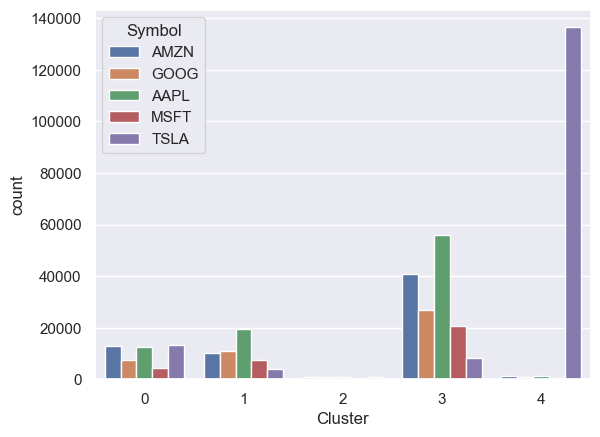

In [469]:
sns.countplot(data=frame,x='Cluster', hue='Symbol')

We have done clustering of tweets based on vader score using k-means.From the count plot we can say that tesla tweets are more in 4th cluster than in the first 3.As we all know that the clustering works well when clusters are of almost same size and it can't handle outliers.So we couldnot get any insights from clustering of tweets using kmeans.

2) Below we will be using regression models to train and test using sentiment score of the tweets on each day to predict the stock prices. 
We have split the data into 82% of training data and 18% of test data. We split the data linearly instead of randomly as the volatity of the stock price is low. If test data is split randomly, the prediction would be easier

Below are the regression models used:
1- Support Vector Regression
2- Random Forest Regression
3- Linear Regression
4- Ridge Regression
5- XGboost Regression

In [336]:
import matplotlib.pyplot as plt
import seaborn as sns; sns.set()
from matplotlib.colors import ListedColormap
from sklearn.metrics import confusion_matrix
import pandas as pd
import numpy as np
from sklearn import datasets, linear_model
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
from sklearn.metrics import classification_report
from sklearn import svm
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.svm import SVR
from sklearn import metrics
from sklearn.metrics import confusion_matrix

Dropping columns which are not required for ML modeling

In [343]:
def drop_columns(df):
    df = df.loc[:, ~df.columns.str.contains('^Unnamed')]
    df = df.drop(columns=['tweet_id','writer','body','comment_num','retweet_num','like_num','ticker_symbol','tidy_tweet'],axis=1)
    return df

In [345]:
tesla = drop_columns(tesla)
amazon = drop_columns(amazon)
microsoft = drop_columns(microsoft)
apple = drop_columns(apple)
google = drop_columns(google)

Using Support Vector Regression to predict Tesla stock prices

In [346]:
tesla_x = tesla.iloc[:, 1:5].values
tesla_y = tesla.iloc[:, 5].values

x_train, x_test, y_train, y_test = train_test_split(tesla_x, tesla_y, test_size=0.180,  shuffle= False)


scale = StandardScaler()
x_train = scale.fit_transform(x_train)
x_test = scale.transform(x_test)

model = SVR(kernel='rbf')
model.fit(x_train, y_train)
predict = model.predict(x_test)

In [347]:
print("Mean Absolute Error:", round(metrics.mean_absolute_error(y_test, predict), 4))
print("Mean Squared Error:", round(metrics.mean_squared_error(y_test, predict), 4))
print("Root Mean Squared Error:", round(np.sqrt(metrics.mean_squared_error(y_test, predict)), 4))
print("(R^2) Score:", round(metrics.r2_score(y_test, predict), 4))
print(f'Train Score : {model.score(x_train, y_train) * 100:.2f}% and Test Score : {model.score(x_test, y_test) * 100:.2f}% using Linear Regressor.')
errors = abs(predict - y_test)
mape = 100 * (errors / y_test)
accuracy = 100 - np.mean(mape)
print('Accuracy:', round(accuracy, 2), '%.') 

Mean Absolute Error: 1.275
Mean Squared Error: 2.6209
Root Mean Squared Error: 1.6189
(R^2) Score: 0.0022
Train Score : 2.99% and Test Score : 0.22% using Linear Regressor.
Accuracy: 98.57 %.


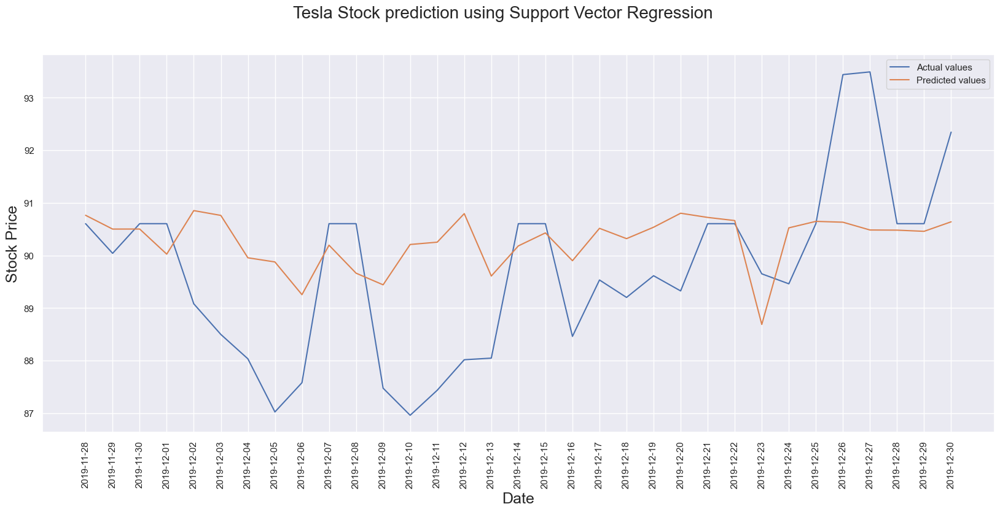

In [348]:
plt.figure(figsize=(20, 8))
plt.plot(tesla['Date'].tail(33), y_test, label = "Actual values")
plt.plot(tesla['Date'].tail(33), predict, label = "Predicted values")
plt.suptitle('Tesla Stock prediction using Support Vector Regression', fontsize=20)
plt.xlabel('Date', fontsize=18)
plt.ylabel('Stock Price', fontsize=18)
plt.xticks(rotation = 90)
plt.legend()
plt.show()


Using Support Vector Regression to predict Amazon stock prices

In [368]:
amazon_x = amazon.iloc[:, 1:5].values
amazon_y = amazon.iloc[:, 5].values

x_train, x_test, y_train, y_test = train_test_split(amazon_x, amazon_y, test_size=0.180,  shuffle= False)


scale = StandardScaler()
x_train = scale.fit_transform(x_train)
x_test = scale.transform(x_test)

model = SVR(kernel='rbf')
model.fit(x_train, y_train)
predict = model.predict(x_test)

In [369]:
print("Mean Absolute Error:", round(metrics.mean_absolute_error(y_test, predict), 4))
print("Mean Squared Error:", round(metrics.mean_squared_error(y_test, predict), 4))
print("Root Mean Squared Error:", round(np.sqrt(metrics.mean_squared_error(y_test, predict)), 4))
print("(R^2) Score:", round(metrics.r2_score(y_test, predict), 4))
print(f'Train Score : {model.score(x_train, y_train) * 100:.2f}% and Test Score : {model.score(x_test, y_test) * 100:.2f}% using Linear Regressor.')
errors = abs(predict - y_test)
mape = 100 * (errors / y_test)
accuracy = 100 - np.mean(mape)
print('Accuracy:', round(accuracy, 2), '%.') 

Mean Absolute Error: 4.9189
Mean Squared Error: 37.0343
Root Mean Squared Error: 6.0856
(R^2) Score: -1.8674
Train Score : 6.45% and Test Score : -186.74% using Linear Regressor.
Accuracy: 80.19 %.


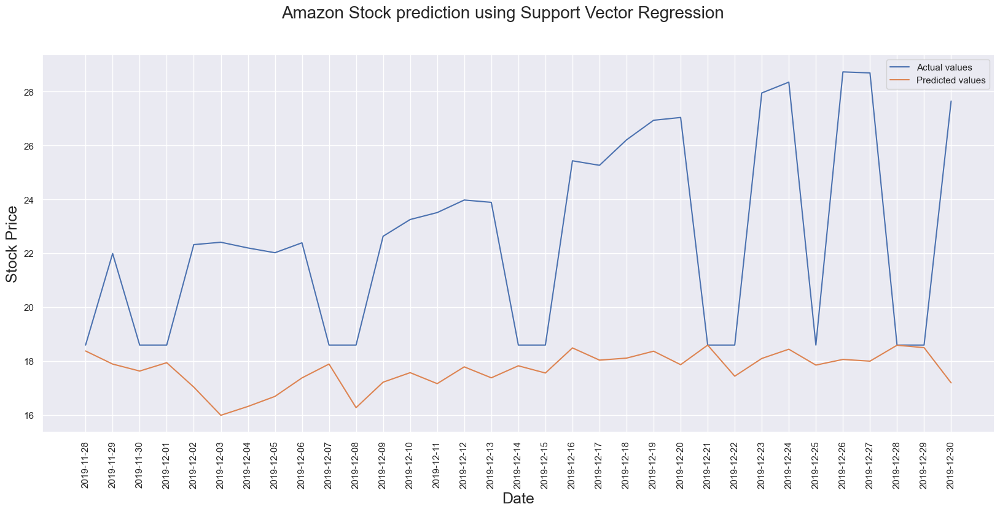

In [370]:
plt.figure(figsize=(20, 8))
plt.plot(tesla['Date'].tail(33), y_test, label = "Actual values")
plt.plot(tesla['Date'].tail(33), predict, label = "Predicted values")
plt.suptitle('Amazon Stock prediction using Support Vector Regression', fontsize=20)
plt.xlabel('Date', fontsize=18)
plt.ylabel('Stock Price', fontsize=18)
plt.xticks(rotation = 90)
plt.legend()
plt.show()

Using Support Vector Regression to predict Apple stock prices

In [371]:
apple_x = apple.iloc[:, 1:5].values
apple_y = apple.iloc[:, 5].values

x_train, x_test, y_train, y_test = train_test_split(apple_x, apple_y, test_size=0.180,  shuffle= False)


scale = StandardScaler()
x_train = scale.fit_transform(x_train)
x_test = scale.transform(x_test)

model = SVR(kernel='rbf')
model.fit(x_train, y_train)
predict = model.predict(x_test)

In [372]:
print("Mean Absolute Error:", round(metrics.mean_absolute_error(y_test, predict), 4))
print("Mean Squared Error:", round(metrics.mean_squared_error(y_test, predict), 4))
print("Root Mean Squared Error:", round(np.sqrt(metrics.mean_squared_error(y_test, predict)), 4))
print("(R^2) Score:", round(metrics.r2_score(y_test, predict), 4))
print(f'Train Score : {model.score(x_train, y_train) * 100:.2f}% and Test Score : {model.score(x_test, y_test) * 100:.2f}% using Linear Regressor.')
errors = abs(predict - y_test)
mape = 100 * (errors / y_test)
accuracy = 100 - np.mean(mape)
print('Accuracy:', round(accuracy, 2), '%.') 

Mean Absolute Error: 8.2618
Mean Squared Error: 104.5045
Root Mean Squared Error: 10.2227
(R^2) Score: -2.5266
Train Score : 8.15% and Test Score : -252.66% using Linear Regressor.
Accuracy: 87.98 %.


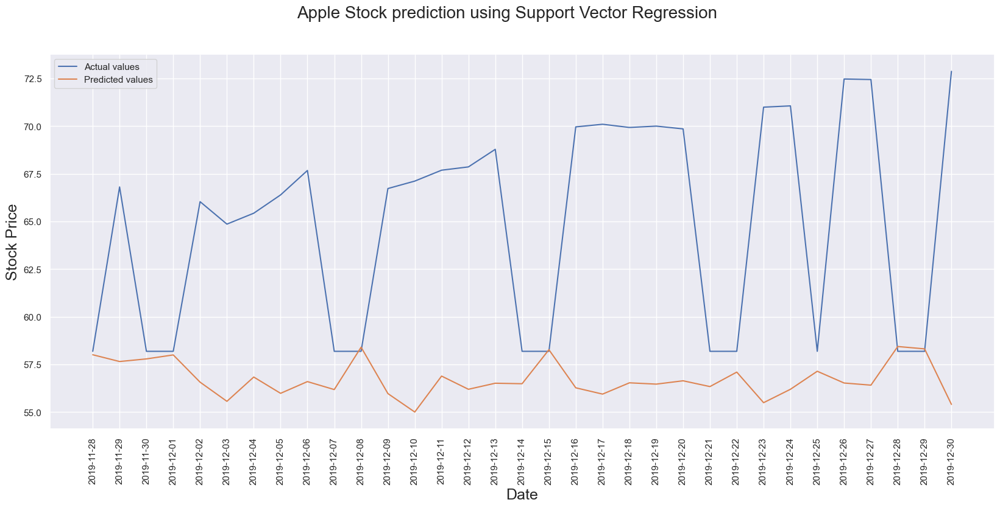

In [373]:
plt.figure(figsize=(20, 8))
plt.plot(tesla['Date'].tail(33), y_test, label = "Actual values")
plt.plot(tesla['Date'].tail(33), predict, label = "Predicted values")
plt.suptitle('Apple Stock prediction using Support Vector Regression', fontsize=20)
plt.xlabel('Date', fontsize=18)
plt.ylabel('Stock Price', fontsize=18)
plt.xticks(rotation = 90)
plt.legend()
plt.show()

Using Support Vector Regression to predict Google stock prices

In [374]:
google_x = google.iloc[:, 1:5].values
google_y = google.iloc[:, 5].values

x_train, x_test, y_train, y_test = train_test_split(google_x, google_y, test_size=0.180,  shuffle= False)


scale = StandardScaler()
x_train = scale.fit_transform(x_train)
x_test = scale.transform(x_test)

model = SVR(kernel='rbf')
model.fit(x_train, y_train)
predict = model.predict(x_test)

In [375]:
print("Mean Absolute Error:", round(metrics.mean_absolute_error(y_test, predict), 4))
print("Mean Squared Error:", round(metrics.mean_squared_error(y_test, predict), 4))
print("Root Mean Squared Error:", round(np.sqrt(metrics.mean_squared_error(y_test, predict)), 4))
print("(R^2) Score:", round(metrics.r2_score(y_test, predict), 4))
print(f'Train Score : {model.score(x_train, y_train) * 100:.2f}% and Test Score : {model.score(x_test, y_test) * 100:.2f}% using Linear Regressor.')
errors = abs(predict - y_test)
mape = 100 * (errors / y_test)
accuracy = 100 - np.mean(mape)
print('Accuracy:', round(accuracy, 2), '%.') 

Mean Absolute Error: 2.9632
Mean Squared Error: 14.4297
Root Mean Squared Error: 3.7986
(R^2) Score: -1.1267
Train Score : 28.99% and Test Score : -112.67% using Linear Regressor.
Accuracy: 95.58 %.


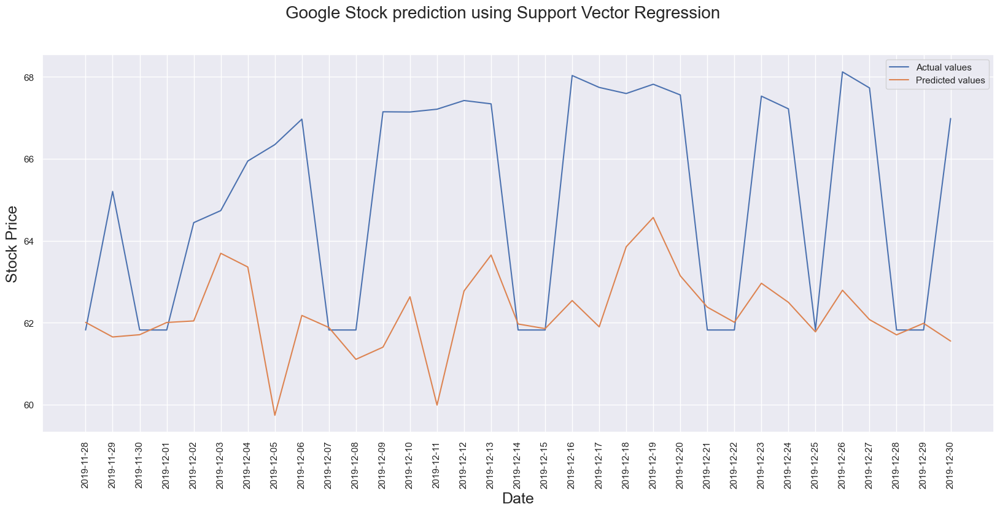

In [376]:
plt.figure(figsize=(20, 8))
plt.plot(tesla['Date'].tail(33), y_test, label = "Actual values")
plt.plot(tesla['Date'].tail(33), predict, label = "Predicted values")
plt.suptitle('Google Stock prediction using Support Vector Regression', fontsize=20)
plt.xlabel('Date', fontsize=18)
plt.ylabel('Stock Price', fontsize=18)
plt.xticks(rotation = 90)
plt.legend()
plt.show()

Using Support Vector Regression to predict Microsoft stock prices

In [377]:
microsoft_x = microsoft.iloc[:, 1:5].values
microsoft_y = microsoft.iloc[:, 5].values

x_train, x_test, y_train, y_test = train_test_split(microsoft_x, microsoft_y, test_size=0.180,  shuffle= False)


scale = StandardScaler()
x_train = scale.fit_transform(x_train)
x_test = scale.transform(x_test)

model = SVR(kernel='rbf')
model.fit(x_train, y_train)
predict = model.predict(x_test)

In [378]:
print("Mean Absolute Error:", round(metrics.mean_absolute_error(y_test, predict), 4))
print("Mean Squared Error:", round(metrics.mean_squared_error(y_test, predict), 4))
print("Root Mean Squared Error:", round(np.sqrt(metrics.mean_squared_error(y_test, predict)), 4))
print("(R^2) Score:", round(metrics.r2_score(y_test, predict), 4))
print(f'Train Score : {model.score(x_train, y_train) * 100:.2f}% and Test Score : {model.score(x_test, y_test) * 100:.2f}% using Linear Regressor.')
errors = abs(predict - y_test)
mape = 100 * (errors / y_test)
accuracy = 100 - np.mean(mape)
print('Accuracy:', round(accuracy, 2), '%.') 

Mean Absolute Error: 9.7597
Mean Squared Error: 145.5901
Root Mean Squared Error: 12.0661
(R^2) Score: -2.7827
Train Score : 3.98% and Test Score : -278.27% using Linear Regressor.
Accuracy: 93.66 %.


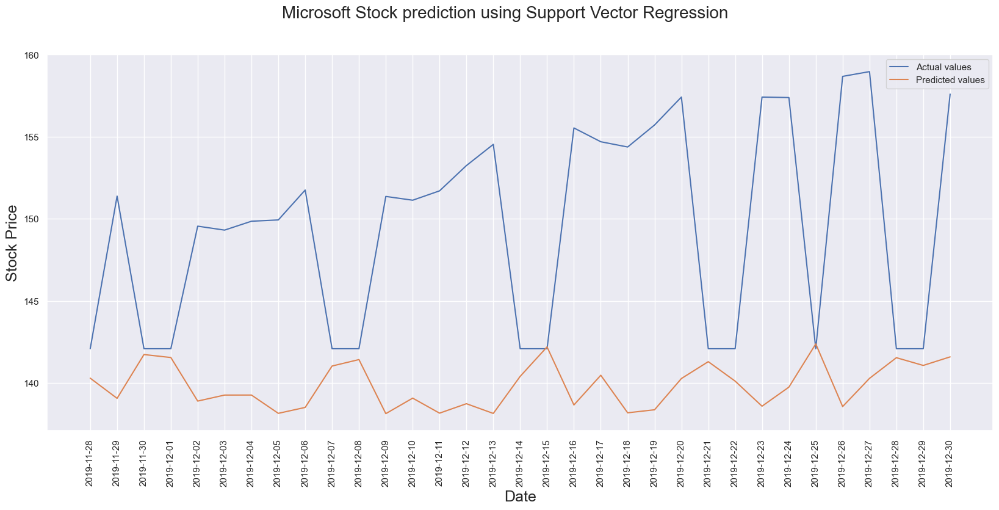

In [379]:
plt.figure(figsize=(20, 8))
plt.plot(tesla['Date'].tail(33), y_test, label = "Actual values")
plt.plot(tesla['Date'].tail(33), predict, label = "Predicted values")
plt.suptitle('Microsoft Stock prediction using Support Vector Regression', fontsize=20)
plt.xlabel('Date', fontsize=18)
plt.ylabel('Stock Price', fontsize=18)
plt.xticks(rotation = 90)
plt.legend()
plt.show()

Using Random forest regression to predict the stock prices

In [380]:
from sklearn.ensemble import RandomForestRegressor

In [381]:
tesla.head()

,Date,compound,neg,neu,pos,Prices
0,2019-07-01,1.0000,0.046,0.799,0.154,96.109497
1,2019-07-02,1.0000,0.048,0.775,0.177,96.715500
2,2019-07-03,1.0000,0.052,0.798,0.150,96.949997
3,2019-07-04,0.9999,0.037,0.788,0.175,90.603933
4,2019-07-05,0.9997,0.048,0.805,0.147,97.145500


Using Random forest to predict Tesla stock prices

In [382]:
tesla_x = tesla.iloc[:, 1:5].values
tesla_y = tesla.iloc[:, 5].values

x_train, x_test, y_train, y_test = train_test_split(tesla_x, tesla_y, test_size=0.180,  shuffle= False)


scale = StandardScaler()
x_train = scale.fit_transform(x_train)
x_test = scale.transform(x_test)

model = RandomForestRegressor(n_estimators=300, random_state=12, min_samples_split=2, min_samples_leaf=1, max_depth=10, bootstrap=True)
model.fit(x_train, y_train)
predict = model.predict(x_test)

In [383]:
print("Mean Absolute Error:", round(metrics.mean_absolute_error(y_test, predict), 4))
print("Mean Squared Error:", round(metrics.mean_squared_error(y_test, predict), 4))
print("Root Mean Squared Error:", round(np.sqrt(metrics.mean_squared_error(y_test, predict)), 4))
print("(R^2) Score:", round(metrics.r2_score(y_test, predict), 4))
print(f'Train Score : {model.score(x_train, y_train) * 100:.2f}% and Test Score : {model.score(x_test, y_test) * 100:.2f}% using Random Tree Regressor.')
errors = abs(predict - y_test)
mape = 100 * (errors / y_test)
accuracy = 100 - np.mean(mape)
print('Accuracy:', round(accuracy, 2), '%.') 

Mean Absolute Error: 2.3439
Mean Squared Error: 9.1825
Root Mean Squared Error: 3.0303
(R^2) Score: -2.4959
Train Score : 83.83% and Test Score : -249.59% using Random Tree Regressor.
Accuracy: 97.37 %.


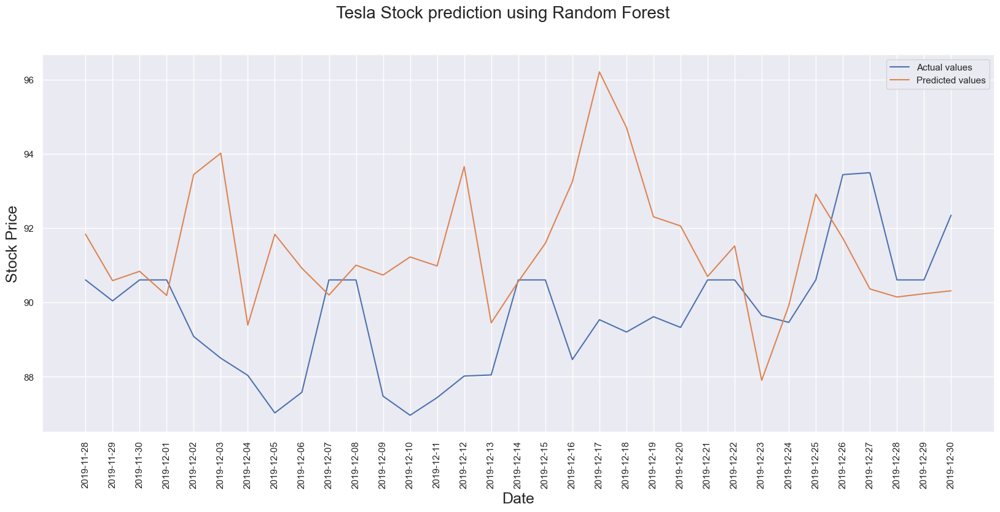

In [384]:
plt.figure(figsize=(20, 8))
plt.plot(tesla['Date'].tail(33), y_test, label = "Actual values")
plt.plot(tesla['Date'].tail(33), predict, label = "Predicted values")
plt.suptitle('Tesla Stock prediction using Random Forest', fontsize=20)
plt.xlabel('Date', fontsize=18)
plt.ylabel('Stock Price', fontsize=18)
plt.xticks(rotation = 90)
plt.legend()
plt.show()

Using Random forest to predict Amazon stock prices

In [385]:
amazon_x = amazon.iloc[:, 1:5].values
amazon_y = amazon.iloc[:, 5].values

x_train, x_test, y_train, y_test = train_test_split(amazon_x, amazon_y, test_size=0.180,  shuffle= False)


scale = StandardScaler()
x_train = scale.fit_transform(x_train)
x_test = scale.transform(x_test)

model = RandomForestRegressor(n_estimators=300, random_state=12, min_samples_split=2, min_samples_leaf=1, max_depth=10, bootstrap=True)
model.fit(x_train, y_train)
predict = model.predict(x_test)

print("Mean Absolute Error:", round(metrics.mean_absolute_error(y_test, predict), 4))
print("Mean Squared Error:", round(metrics.mean_squared_error(y_test, predict), 4))
print("Root Mean Squared Error:", round(np.sqrt(metrics.mean_squared_error(y_test, predict)), 4))
print("(R^2) Score:", round(metrics.r2_score(y_test, predict), 4))
print(f'Train Score : {model.score(x_train, y_train) * 100:.2f}% and Test Score : {model.score(x_test, y_test) * 100:.2f}% using Random Tree Regressor.')
errors = abs(predict - y_test)
mape = 100 * (errors / y_test)
accuracy = 100 - np.mean(mape)
print('Accuracy:', round(accuracy, 2), '%.') 

Mean Absolute Error: 4.3594
Mean Squared Error: 31.0208
Root Mean Squared Error: 5.5696
(R^2) Score: -1.4018
Train Score : 82.01% and Test Score : -140.18% using Random Tree Regressor.
Accuracy: 82.61 %.


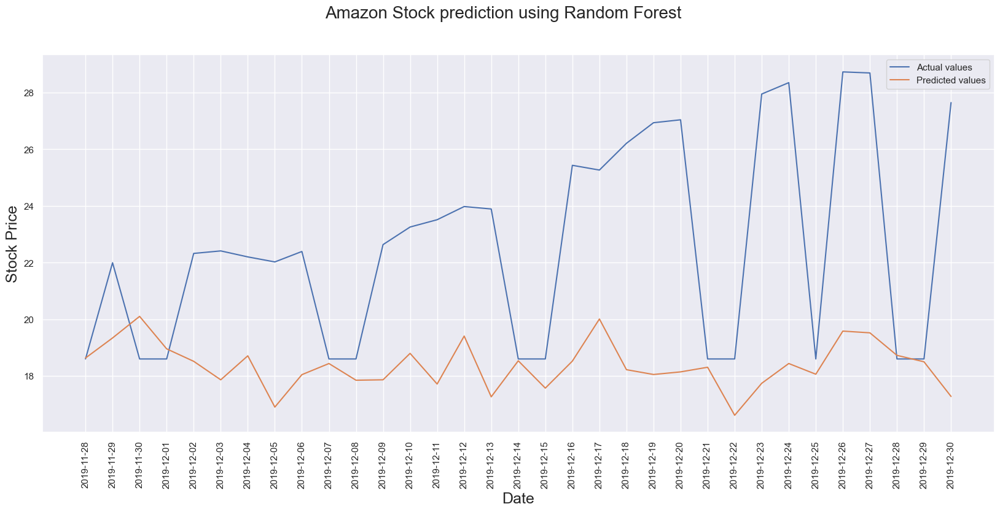

In [386]:
plt.figure(figsize=(20, 8))
plt.plot(amazon['Date'].tail(33), y_test, label = "Actual values")
plt.plot(amazon['Date'].tail(33), predict, label = "Predicted values")
plt.suptitle('Amazon Stock prediction using Random Forest', fontsize=20)
plt.xlabel('Date', fontsize=18)
plt.ylabel('Stock Price', fontsize=18)
plt.xticks(rotation = 90)
plt.legend()
plt.show()

Using Random forest to predict Apple stock prices

In [387]:
apple_x = apple.iloc[:, 1:5].values
apple_y = apple.iloc[:, 5].values

x_train, x_test, y_train, y_test = train_test_split(apple_x, apple_y, test_size=0.180,  shuffle= False)


scale = StandardScaler()
x_train = scale.fit_transform(x_train)
x_test = scale.transform(x_test)

model = RandomForestRegressor(n_estimators=300, random_state=12, min_samples_split=2, min_samples_leaf=1, max_depth=10, bootstrap=True)
model.fit(x_train, y_train)
predict = model.predict(x_test)

print("Mean Absolute Error:", round(metrics.mean_absolute_error(y_test, predict), 4))
print("Mean Squared Error:", round(metrics.mean_squared_error(y_test, predict), 4))
print("Root Mean Squared Error:", round(np.sqrt(metrics.mean_squared_error(y_test, predict)), 4))
print("(R^2) Score:", round(metrics.r2_score(y_test, predict), 4))
print(f'Train Score : {model.score(x_train, y_train) * 100:.2f}% and Test Score : {model.score(x_test, y_test) * 100:.2f}% using Random Tree Regressor.')
errors = abs(predict - y_test)
mape = 100 * (errors / y_test)
accuracy = 100 - np.mean(mape)
print('Accuracy:', round(accuracy, 2), '%.') 

Mean Absolute Error: 8.4649
Mean Squared Error: 106.5783
Root Mean Squared Error: 10.3237
(R^2) Score: -2.5966
Train Score : 74.52% and Test Score : -259.66% using Random Tree Regressor.
Accuracy: 87.62 %.


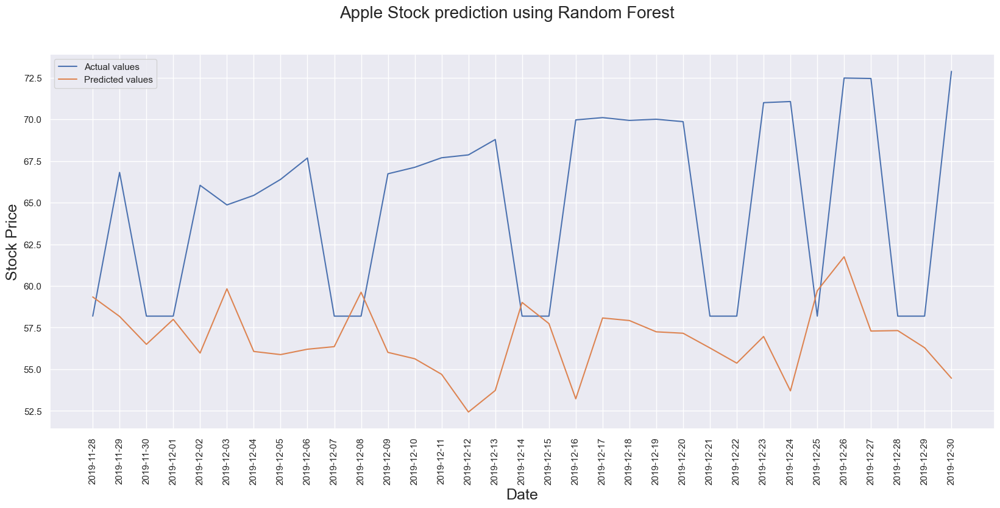

In [388]:
plt.figure(figsize=(20, 8))
plt.plot(apple['Date'].tail(33), y_test, label = "Actual values")
plt.plot(apple['Date'].tail(33), predict, label = "Predicted values")
plt.suptitle('Apple Stock prediction using Random Forest', fontsize=20)
plt.xlabel('Date', fontsize=18)
plt.ylabel('Stock Price', fontsize=18)
plt.xticks(rotation = 90)
plt.legend()
plt.show()

Using Random forest to predict Google stock prices

In [389]:
google_x = google.iloc[:, 1:5].values
google_y = google.iloc[:, 5].values

x_train, x_test, y_train, y_test = train_test_split(google_x, google_y, test_size=0.180,  shuffle= False)


scale = StandardScaler()
x_train = scale.fit_transform(x_train)
x_test = scale.transform(x_test)

model = RandomForestRegressor(n_estimators=300, random_state=12, min_samples_split=2, min_samples_leaf=1, max_depth=10, bootstrap=True)
model.fit(x_train, y_train)
predict = model.predict(x_test)

print("Mean Absolute Error:", round(metrics.mean_absolute_error(y_test, predict), 4))
print("Mean Squared Error:", round(metrics.mean_squared_error(y_test, predict), 4))
print("Root Mean Squared Error:", round(np.sqrt(metrics.mean_squared_error(y_test, predict)), 4))
print("(R^2) Score:", round(metrics.r2_score(y_test, predict), 4))
print(f'Train Score : {model.score(x_train, y_train) * 100:.2f}% and Test Score : {model.score(x_test, y_test) * 100:.2f}% using Random Tree Regressor.')
errors = abs(predict - y_test)
mape = 100 * (errors / y_test)
accuracy = 100 - np.mean(mape)
print('Accuracy:', round(accuracy, 2), '%.') 

Mean Absolute Error: 3.157
Mean Squared Error: 15.7886
Root Mean Squared Error: 3.9735
(R^2) Score: -1.327
Train Score : 85.56% and Test Score : -132.70% using Random Tree Regressor.
Accuracy: 95.26 %.


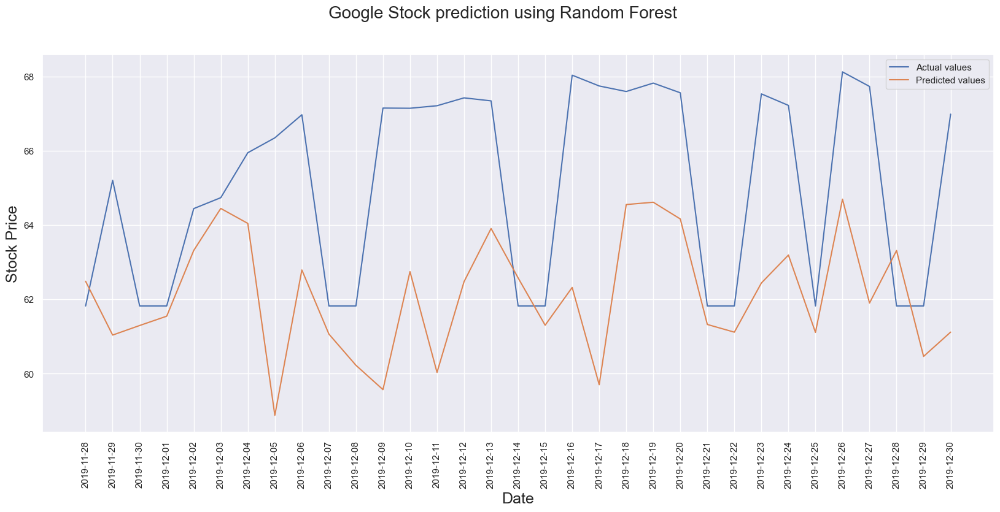

In [390]:
plt.figure(figsize=(20, 8))
plt.plot(google['Date'].tail(33), y_test, label = "Actual values")
plt.plot(google['Date'].tail(33), predict, label = "Predicted values")
plt.suptitle('Google Stock prediction using Random Forest', fontsize=20)
plt.xlabel('Date', fontsize=18)
plt.ylabel('Stock Price', fontsize=18)
plt.xticks(rotation = 90)
plt.legend()
plt.show()

Using Random forest to predict Microsoft stock prices

In [391]:
microsoft_x = microsoft.iloc[:, 1:5].values
microsoft_y = microsoft.iloc[:, 5].values

x_train, x_test, y_train, y_test = train_test_split(microsoft_x, microsoft_y, test_size=0.180,  shuffle= False)


scale = StandardScaler()
x_train = scale.fit_transform(x_train)
x_test = scale.transform(x_test)

model = RandomForestRegressor(n_estimators=300, random_state=12, min_samples_split=2, min_samples_leaf=1, max_depth=10, bootstrap=True)
model.fit(x_train, y_train)
predict = model.predict(x_test)

print("Mean Absolute Error:", round(metrics.mean_absolute_error(y_test, predict), 4))
print("Mean Squared Error:", round(metrics.mean_squared_error(y_test, predict), 4))
print("Root Mean Squared Error:", round(np.sqrt(metrics.mean_squared_error(y_test, predict)), 4))
print("(R^2) Score:", round(metrics.r2_score(y_test, predict), 4))
print(f'Train Score : {model.score(x_train, y_train) * 100:.2f}% and Test Score : {model.score(x_test, y_test) * 100:.2f}% using Random Tree Regressor.')
errors = abs(predict - y_test)
mape = 100 * (errors / y_test)
accuracy = 100 - np.mean(mape)
print('Accuracy:', round(accuracy, 2), '%.') 

Mean Absolute Error: 8.5365
Mean Squared Error: 118.2779
Root Mean Squared Error: 10.8756
(R^2) Score: -2.0731
Train Score : 84.35% and Test Score : -207.31% using Random Tree Regressor.
Accuracy: 94.46 %.


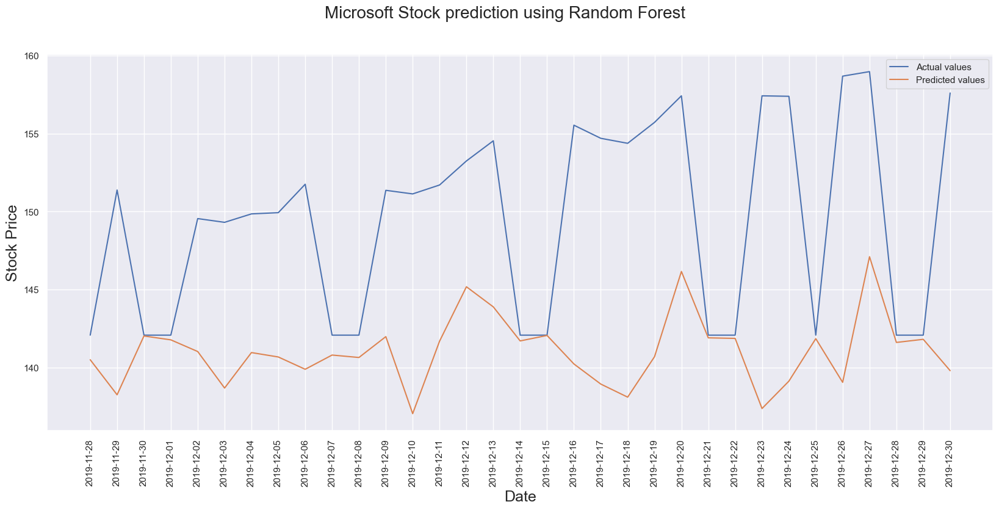

In [392]:
plt.figure(figsize=(20, 8))
plt.plot(microsoft['Date'].tail(33), y_test, label = "Actual values")
plt.plot(microsoft['Date'].tail(33), predict, label = "Predicted values")
plt.suptitle('Microsoft Stock prediction using Random Forest', fontsize=20)
plt.xlabel('Date', fontsize=18)
plt.ylabel('Stock Price', fontsize=18)
plt.xticks(rotation = 90)
plt.legend()
plt.show()

Using Linear Regression to predict stock prices

In [394]:
from sklearn.linear_model import LinearRegression

In [395]:
tesla_x = tesla.iloc[:, 1:5].values
tesla_y = tesla.iloc[:, 5].values

x_train, x_test, y_train, y_test = train_test_split(tesla_x, tesla_y, test_size=0.180,  shuffle= False)
scale = StandardScaler()
x_train = scale.fit_transform(x_train)
x_test = scale.transform(x_test)

model = LinearRegression()
model.fit(x_train, y_train)
predict = model.predict(x_test)


In [396]:
print("Mean Absolute Error:", round(metrics.mean_absolute_error(y_test, predict), 4))
print("Mean Squared Error:", round(metrics.mean_squared_error(y_test, predict), 4))
print("Root Mean Squared Error:", round(np.sqrt(metrics.mean_squared_error(y_test, predict)), 4))
print("(R^2) Score:", round(metrics.r2_score(y_test, predict), 4))
print(f'Train Score : {model.score(x_train, y_train) * 100:.2f}% and Test Score : {model.score(x_test, y_test) * 100:.2f}% using Linear Regressor.')
errors = abs(predict - y_test)
mape = 100 * (errors / y_test)
accuracy = 100 - np.mean(mape)
print('Accuracy:', round(accuracy, 2), '%.') 

Mean Absolute Error: 1.869
Mean Squared Error: 5.8384
Root Mean Squared Error: 2.4163
(R^2) Score: -1.2228
Train Score : 9.70% and Test Score : -122.28% using Linear Regressor.
Accuracy: 97.9 %.


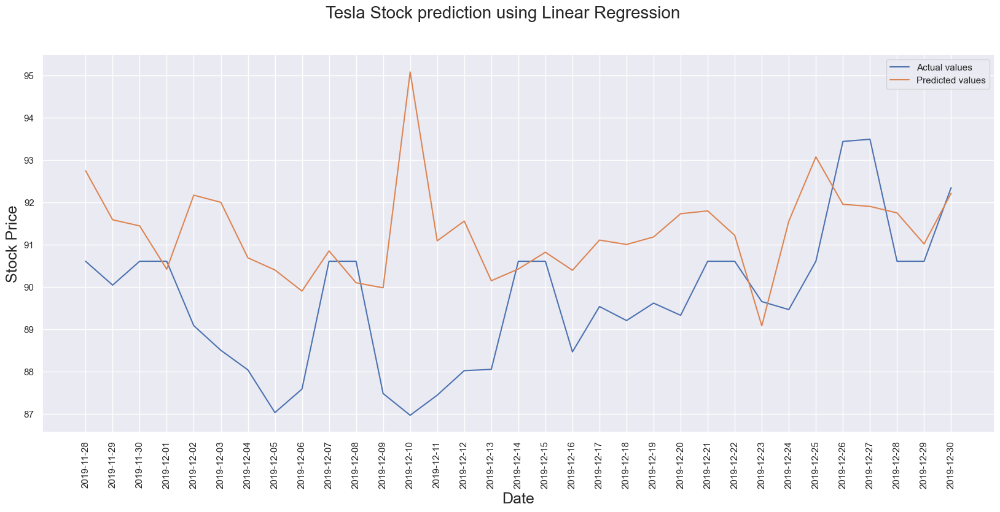

In [397]:
plt.figure(figsize=(20, 8))
plt.plot(tesla['Date'].tail(33), y_test, label = "Actual values")
plt.plot(tesla['Date'].tail(33), predict, label = "Predicted values")
plt.suptitle('Tesla Stock prediction using Linear Regression', fontsize=20)
plt.xlabel('Date', fontsize=18)
plt.ylabel('Stock Price', fontsize=18)
plt.xticks(rotation = 90)
plt.legend()
plt.show()

Using Linear Regression to predict Amazon stock prices

In [398]:
amazon_x = amazon.iloc[:, 1:5].values
amazon_y = amazon.iloc[:, 5].values

x_train, x_test, y_train, y_test = train_test_split(amazon_x, amazon_y, test_size=0.180,  shuffle= False)


scale = StandardScaler()
x_train = scale.fit_transform(x_train)
x_test = scale.transform(x_test)

model = LinearRegression()
model.fit(x_train, y_train)
predict = model.predict(x_test)

In [399]:
print("Mean Absolute Error:", round(metrics.mean_absolute_error(y_test, predict), 4))
print("Mean Squared Error:", round(metrics.mean_squared_error(y_test, predict), 4))
print("Root Mean Squared Error:", round(np.sqrt(metrics.mean_squared_error(y_test, predict)), 4))
print("(R^2) Score:", round(metrics.r2_score(y_test, predict), 4))
print(f'Train Score : {model.score(x_train, y_train) * 100:.2f}% and Test Score : {model.score(x_test, y_test) * 100:.2f}% using Linear Regressor.')
errors = abs(predict - y_test)
mape = 100 * (errors / y_test)
accuracy = 100 - np.mean(mape)
print('Accuracy:', round(accuracy, 2), '%.') 

Mean Absolute Error: 4.4906
Mean Squared Error: 31.4664
Root Mean Squared Error: 5.6095
(R^2) Score: -1.4363
Train Score : 9.31% and Test Score : -143.63% using Linear Regressor.
Accuracy: 81.96 %.


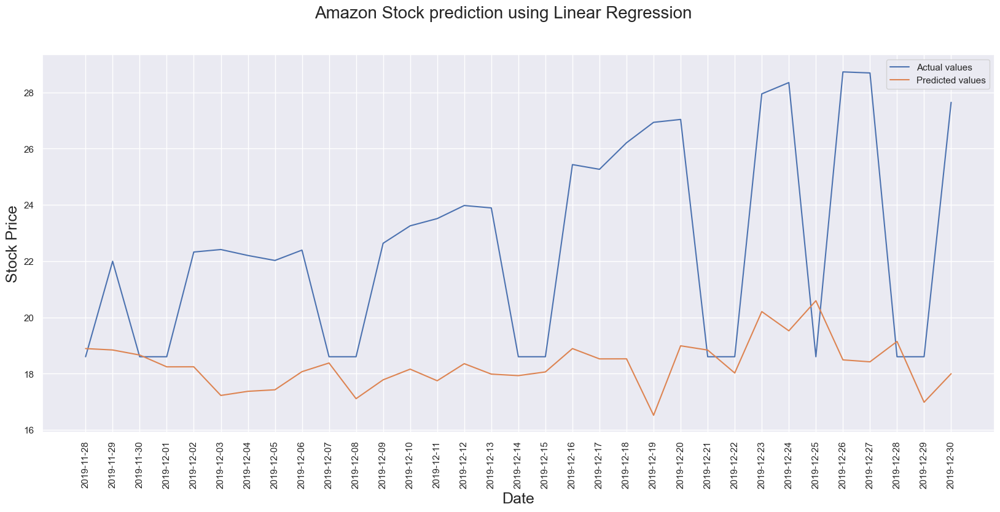

In [400]:
plt.figure(figsize=(20, 8))
plt.plot(tesla['Date'].tail(33), y_test, label = "Actual values")
plt.plot(tesla['Date'].tail(33), predict, label = "Predicted values")
plt.suptitle('Amazon Stock prediction using Linear Regression', fontsize=20)
plt.xlabel('Date', fontsize=18)
plt.ylabel('Stock Price', fontsize=18)
plt.xticks(rotation = 90)
plt.legend()
plt.show()

Using Linear Regression to predict Apple stock prices

In [401]:
apple_x = apple.iloc[:, 1:5].values
apple_y = apple.iloc[:, 5].values

x_train, x_test, y_train, y_test = train_test_split(apple_x, apple_y, test_size=0.180,  shuffle= False)


scale = StandardScaler()
x_train = scale.fit_transform(x_train)
x_test = scale.transform(x_test)

model = LinearRegression()
model.fit(x_train, y_train)
predict = model.predict(x_test)

In [402]:
print("Mean Absolute Error:", round(metrics.mean_absolute_error(y_test, predict), 4))
print("Mean Squared Error:", round(metrics.mean_squared_error(y_test, predict), 4))
print("Root Mean Squared Error:", round(np.sqrt(metrics.mean_squared_error(y_test, predict)), 4))
print("(R^2) Score:", round(metrics.r2_score(y_test, predict), 4))
print(f'Train Score : {model.score(x_train, y_train) * 100:.2f}% and Test Score : {model.score(x_test, y_test) * 100:.2f}% using Linear Regressor.')
errors = abs(predict - y_test)
mape = 100 * (errors / y_test)
accuracy = 100 - np.mean(mape)
print('Accuracy:', round(accuracy, 2), '%.') 

Mean Absolute Error: 7.8733
Mean Squared Error: 97.3954
Root Mean Squared Error: 9.8689
(R^2) Score: -2.2867
Train Score : 2.80% and Test Score : -228.67% using Linear Regressor.
Accuracy: 88.54 %.


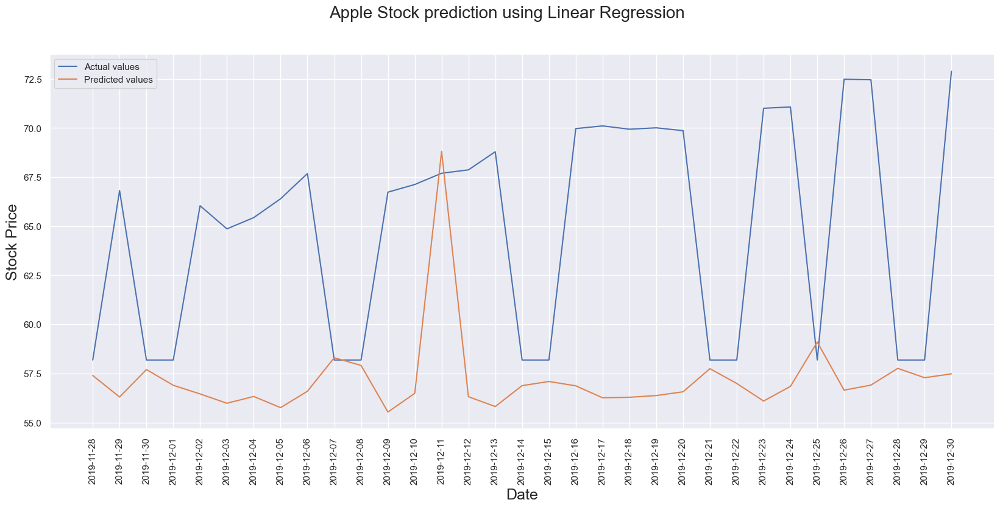

In [403]:
plt.figure(figsize=(20, 8))
plt.plot(tesla['Date'].tail(33), y_test, label = "Actual values")
plt.plot(tesla['Date'].tail(33), predict, label = "Predicted values")
plt.suptitle('Apple Stock prediction using Linear Regression', fontsize=20)
plt.xlabel('Date', fontsize=18)
plt.ylabel('Stock Price', fontsize=18)
plt.xticks(rotation = 90)
plt.legend()
plt.show()

Using Linear Regression to predict Google stock prices

In [404]:
google_x = google.iloc[:, 1:5].values
google_y = google.iloc[:, 5].values

x_train, x_test, y_train, y_test = train_test_split(google_x, google_y, test_size=0.180,  shuffle= False)


scale = StandardScaler()
x_train = scale.fit_transform(x_train)
x_test = scale.transform(x_test)

model = LinearRegression()
model.fit(x_train, y_train)
predict = model.predict(x_test)

In [405]:
print("Mean Absolute Error:", round(metrics.mean_absolute_error(y_test, predict), 4))
print("Mean Squared Error:", round(metrics.mean_squared_error(y_test, predict), 4))
print("Root Mean Squared Error:", round(np.sqrt(metrics.mean_squared_error(y_test, predict)), 4))
print("(R^2) Score:", round(metrics.r2_score(y_test, predict), 4))
print(f'Train Score : {model.score(x_train, y_train) * 100:.2f}% and Test Score : {model.score(x_test, y_test) * 100:.2f}% using Linear Regressor.')
errors = abs(predict - y_test)
mape = 100 * (errors / y_test)
accuracy = 100 - np.mean(mape)
print('Accuracy:', round(accuracy, 2), '%.') 

Mean Absolute Error: 3.7604
Mean Squared Error: 20.4883
Root Mean Squared Error: 4.5264
(R^2) Score: -2.0197
Train Score : 5.75% and Test Score : -201.97% using Linear Regressor.
Accuracy: 94.37 %.


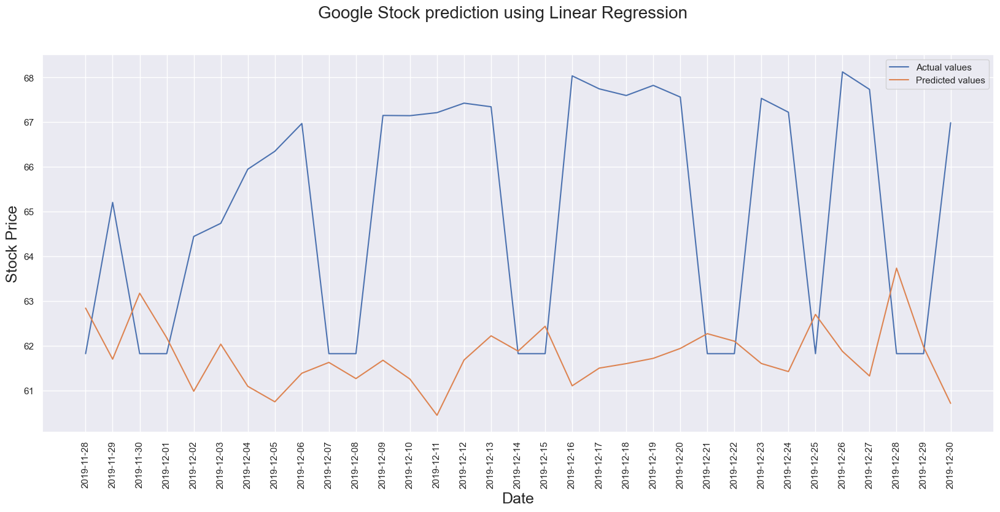

In [406]:
plt.figure(figsize=(20, 8))
plt.plot(tesla['Date'].tail(33), y_test, label = "Actual values")
plt.plot(tesla['Date'].tail(33), predict, label = "Predicted values")
plt.suptitle('Google Stock prediction using Linear Regression', fontsize=20)
plt.xlabel('Date', fontsize=18)
plt.ylabel('Stock Price', fontsize=18)
plt.xticks(rotation = 90)
plt.legend()
plt.show()

Using Linear Regression to predict Microsoft stock prices

In [407]:
microsoft_x = microsoft.iloc[:, 1:5].values
microsoft_y = microsoft.iloc[:, 5].values

x_train, x_test, y_train, y_test = train_test_split(microsoft_x, microsoft_y, test_size=0.180,  shuffle= False)


scale = StandardScaler()
x_train = scale.fit_transform(x_train)
x_test = scale.transform(x_test)

model = LinearRegression()
model.fit(x_train, y_train)
predict = model.predict(x_test)

In [408]:
print("Mean Absolute Error:", round(metrics.mean_absolute_error(y_test, predict), 4))
print("Mean Squared Error:", round(metrics.mean_squared_error(y_test, predict), 4))
print("Root Mean Squared Error:", round(np.sqrt(metrics.mean_squared_error(y_test, predict)), 4))
print("(R^2) Score:", round(metrics.r2_score(y_test, predict), 4))
print(f'Train Score : {model.score(x_train, y_train) * 100:.2f}% and Test Score : {model.score(x_test, y_test) * 100:.2f}% using Linear Regressor.')
errors = abs(predict - y_test)
mape = 100 * (errors / y_test)
accuracy = 100 - np.mean(mape)
print('Accuracy:', round(accuracy, 2), '%.') 

Mean Absolute Error: 9.2388
Mean Squared Error: 127.9554
Root Mean Squared Error: 11.3117
(R^2) Score: -2.3245
Train Score : 5.27% and Test Score : -232.45% using Linear Regressor.
Accuracy: 93.99 %.


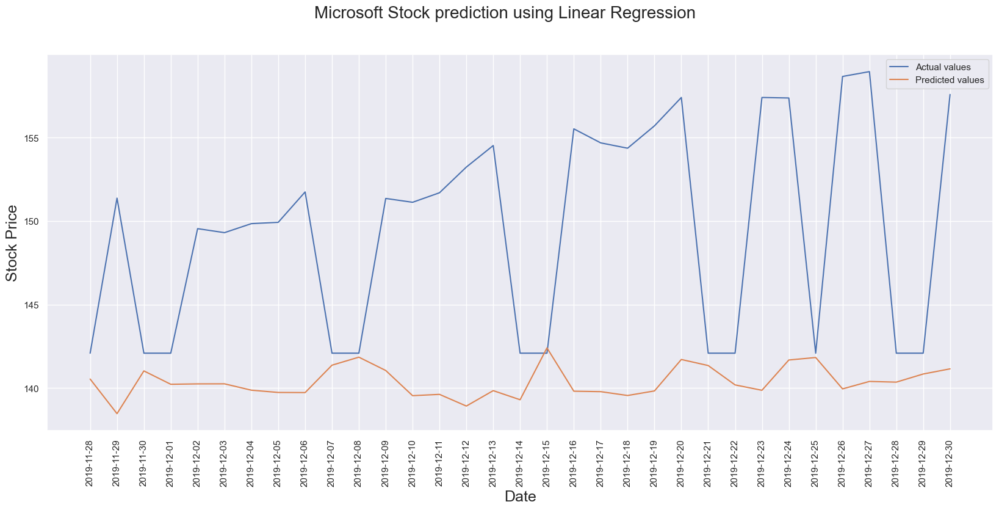

In [409]:
plt.figure(figsize=(20, 8))
plt.plot(tesla['Date'].tail(33), y_test, label = "Actual values")
plt.plot(tesla['Date'].tail(33), predict, label = "Predicted values")
plt.suptitle('Microsoft Stock prediction using Linear Regression', fontsize=20)
plt.xlabel('Date', fontsize=18)
plt.ylabel('Stock Price', fontsize=18)
plt.xticks(rotation = 90)
plt.legend()
plt.show()

Using Ridge regression model, we predict the stock prices

In [350]:
from sklearn.linear_model import Ridge
from sklearn.pipeline import make_pipeline

Using Ridge Regression to predict Tesla stock prices

In [351]:
tesla_x = tesla.iloc[:, 1:5].values
tesla_y = tesla.iloc[:, 5].values

x_train, x_test, y_train, y_test = train_test_split(tesla_x, tesla_y, test_size=0.180,  shuffle= False)


pipeline = make_pipeline(StandardScaler(), Ridge(alpha=1.0))
pipeline.fit(x_train, y_train)

predict = pipeline.predict(x_test)

In [352]:
print("Mean Absolute Error:", round(metrics.mean_absolute_error(y_test, predict), 4))
print("Mean Squared Error:", round(metrics.mean_squared_error(y_test, predict), 4))
print("Root Mean Squared Error:", round(np.sqrt(metrics.mean_squared_error(y_test, predict)), 4))
print("(R^2) Score:", round(metrics.r2_score(y_test, predict), 4))
print(f'Train Score : {pipeline.score(x_train, y_train) * 100:.2f}% and Test Score : {pipeline.score(x_test, y_test) * 100:.2f}% using Linear Regressor.')
errors = abs(predict - y_test)
mape = 100 * (errors / y_test)
accuracy = 100 - np.mean(mape)
print('Accuracy:', round(accuracy, 2), '%.') 

Mean Absolute Error: 1.8603
Mean Squared Error: 5.8233
Root Mean Squared Error: 2.4131
(R^2) Score: -1.217
Train Score : 9.65% and Test Score : -121.70% using Linear Regressor.
Accuracy: 97.9 %.


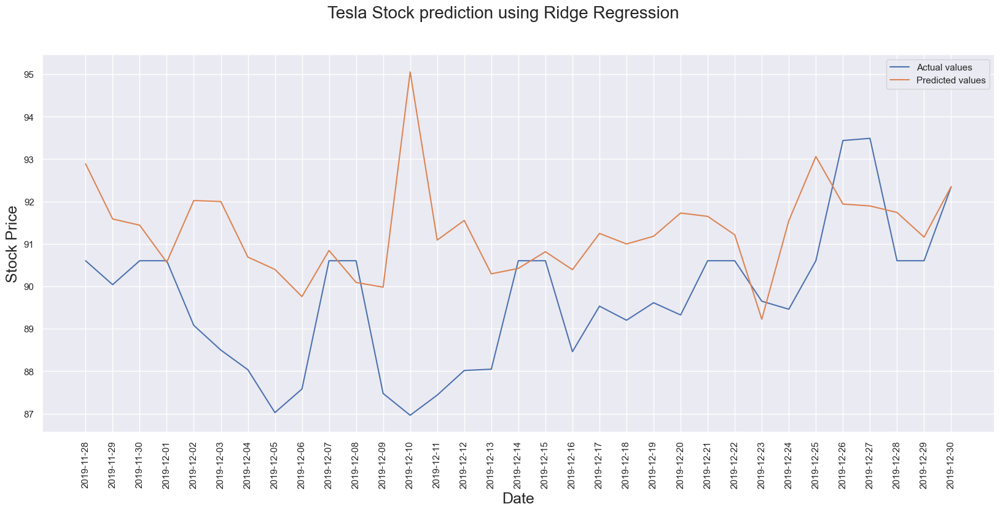

In [353]:
plt.figure(figsize=(20, 8))
plt.plot(tesla['Date'].tail(33), y_test, label = "Actual values")
plt.plot(tesla['Date'].tail(33), predict, label = "Predicted values")
plt.suptitle('Tesla Stock prediction using Ridge Regression', fontsize=20)
plt.xlabel('Date', fontsize=18)
plt.ylabel('Stock Price', fontsize=18)
plt.xticks(rotation = 90)
plt.legend()
plt.show()

Using Ridge Regression to predict Amazon stock prices

In [354]:
amazon_x = amazon.iloc[:, 1:5].values
amazon_y = amazon.iloc[:, 5].values

x_train, x_test, y_train, y_test = train_test_split(amazon_x, amazon_y, test_size=0.180,  shuffle= False)


pipeline = make_pipeline(StandardScaler(), Ridge(alpha=1.0))
pipeline.fit(x_train, y_train)

predict = pipeline.predict(x_test)

In [355]:
print("Mean Absolute Error:", round(metrics.mean_absolute_error(y_test, predict), 4))
print("Mean Squared Error:", round(metrics.mean_squared_error(y_test, predict), 4))
print("Root Mean Squared Error:", round(np.sqrt(metrics.mean_squared_error(y_test, predict)), 4))
print("(R^2) Score:", round(metrics.r2_score(y_test, predict), 4))
print(f'Train Score : {pipeline.score(x_train, y_train) * 100:.2f}% and Test Score : {pipeline.score(x_test, y_test) * 100:.2f}% using Linear Regressor.')
errors = abs(predict - y_test)
mape = 100 * (errors / y_test)
accuracy = 100 - np.mean(mape)
print('Accuracy:', round(accuracy, 2), '%.') 

Mean Absolute Error: 4.4891
Mean Squared Error: 31.4225
Root Mean Squared Error: 5.6056
(R^2) Score: -1.4329
Train Score : 9.29% and Test Score : -143.29% using Linear Regressor.
Accuracy: 81.96 %.


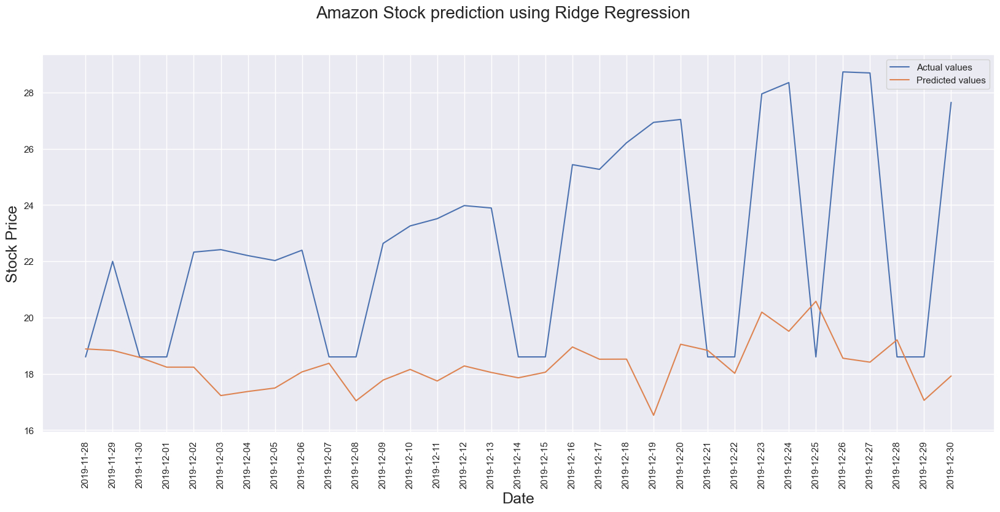

In [356]:
plt.figure(figsize=(20, 8))
plt.plot(tesla['Date'].tail(33), y_test, label = "Actual values")
plt.plot(tesla['Date'].tail(33), predict, label = "Predicted values")
plt.suptitle('Amazon Stock prediction using Ridge Regression', fontsize=20)
plt.xlabel('Date', fontsize=18)
plt.ylabel('Stock Price', fontsize=18)
plt.xticks(rotation = 90)
plt.legend()
plt.show()

Using Ridge Regression to predict Apple stock prices

In [357]:
apple_x = apple.iloc[:, 1:5].values
apple_y = apple.iloc[:, 5].values

x_train, x_test, y_train, y_test = train_test_split(apple_x, apple_y, test_size=0.180,  shuffle= False)


pipeline = make_pipeline(StandardScaler(), Ridge(alpha=1.0))
pipeline.fit(x_train, y_train)

predict = pipeline.predict(x_test)

In [358]:
print("Mean Absolute Error:", round(metrics.mean_absolute_error(y_test, predict), 4))
print("Mean Squared Error:", round(metrics.mean_squared_error(y_test, predict), 4))
print("Root Mean Squared Error:", round(np.sqrt(metrics.mean_squared_error(y_test, predict)), 4))
print("(R^2) Score:", round(metrics.r2_score(y_test, predict), 4))
print(f'Train Score : {pipeline.score(x_train, y_train) * 100:.2f}% and Test Score : {pipeline.score(x_test, y_test) * 100:.2f}% using Linear Regressor.')
errors = abs(predict - y_test)
mape = 100 * (errors / y_test)
accuracy = 100 - np.mean(mape)
print('Accuracy:', round(accuracy, 2), '%.') 

Mean Absolute Error: 7.907
Mean Squared Error: 97.0822
Root Mean Squared Error: 9.853
(R^2) Score: -2.2761
Train Score : 2.52% and Test Score : -227.61% using Linear Regressor.
Accuracy: 88.49 %.


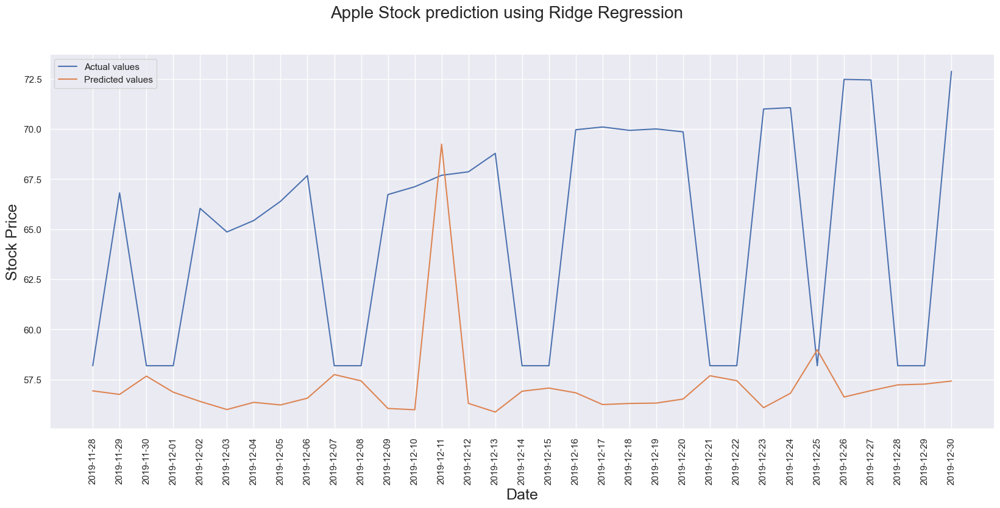

In [359]:
plt.figure(figsize=(20, 8))
plt.plot(tesla['Date'].tail(33), y_test, label = "Actual values")
plt.plot(tesla['Date'].tail(33), predict, label = "Predicted values")
plt.suptitle('Apple Stock prediction using Ridge Regression', fontsize=20)
plt.xlabel('Date', fontsize=18)
plt.ylabel('Stock Price', fontsize=18)
plt.xticks(rotation = 90)
plt.legend()
plt.show()

Using Ridge Regression to predict Google stock prices

In [360]:
google_x = google.iloc[:, 1:5].values
google_y = google.iloc[:, 5].values

x_train, x_test, y_train, y_test = train_test_split(google_x, google_y, test_size=0.180,  shuffle= False)

pipeline = make_pipeline(StandardScaler(), Ridge(alpha=1.0))
pipeline.fit(x_train, y_train)

predict = pipeline.predict(x_test)

In [361]:
print("Mean Absolute Error:", round(metrics.mean_absolute_error(y_test, predict), 4))
print("Mean Squared Error:", round(metrics.mean_squared_error(y_test, predict), 4))
print("Root Mean Squared Error:", round(np.sqrt(metrics.mean_squared_error(y_test, predict)), 4))
print("(R^2) Score:", round(metrics.r2_score(y_test, predict), 4))
print(f'Train Score : {pipeline.score(x_train, y_train) * 100:.2f}% and Test Score : {pipeline.score(x_test, y_test) * 100:.2f}% using Linear Regressor.')
errors = abs(predict - y_test)
mape = 100 * (errors / y_test)
accuracy = 100 - np.mean(mape)
print('Accuracy:', round(accuracy, 2), '%.') 

Mean Absolute Error: 3.7468
Mean Squared Error: 20.3688
Root Mean Squared Error: 4.5132
(R^2) Score: -2.0021
Train Score : 5.57% and Test Score : -200.21% using Linear Regressor.
Accuracy: 94.39 %.


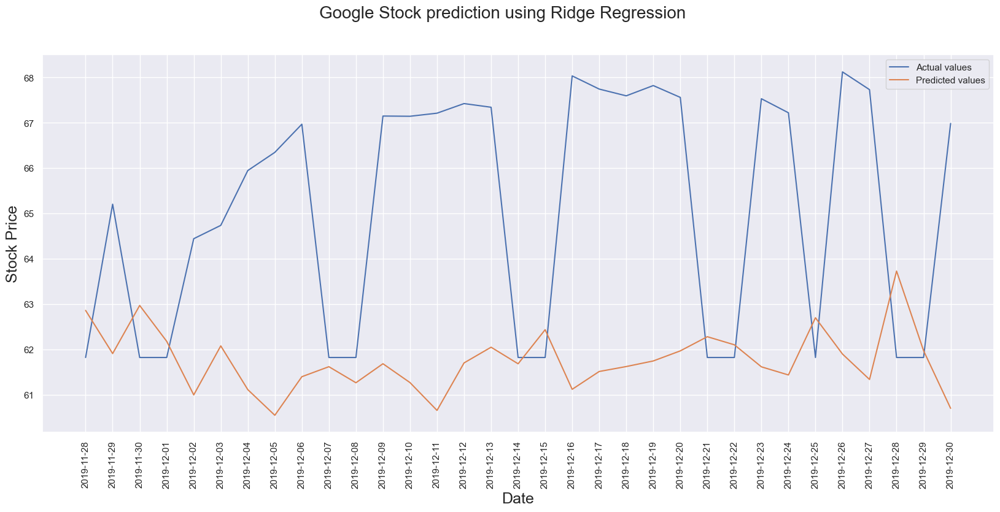

In [362]:
plt.figure(figsize=(20, 8))
plt.plot(tesla['Date'].tail(33), y_test, label = "Actual values")
plt.plot(tesla['Date'].tail(33), predict, label = "Predicted values")
plt.suptitle('Google Stock prediction using Ridge Regression', fontsize=20)
plt.xlabel('Date', fontsize=18)
plt.ylabel('Stock Price', fontsize=18)
plt.xticks(rotation = 90)
plt.legend()
plt.show()

Using Ridge Regression to predict Microsoft stock prices

In [365]:
microsoft_x = microsoft.iloc[:, 1:5].values
microsoft_y = microsoft.iloc[:, 5].values

x_train, x_test, y_train, y_test = train_test_split(microsoft_x, microsoft_y, test_size=0.180,  shuffle= False)

pipeline = make_pipeline(StandardScaler(), Ridge(alpha=1.0))
pipeline.fit(x_train, y_train)

predict = pipeline.predict(x_test)

In [366]:
print("Mean Absolute Error:", round(metrics.mean_absolute_error(y_test, predict), 4))
print("Mean Squared Error:", round(metrics.mean_squared_error(y_test, predict), 4))
print("Root Mean Squared Error:", round(np.sqrt(metrics.mean_squared_error(y_test, predict)), 4))
print("(R^2) Score:", round(metrics.r2_score(y_test, predict), 4))
print(f'Train Score : {pipeline.score(x_train, y_train) * 100:.2f}% and Test Score : {pipeline.score(x_test, y_test) * 100:.2f}% using Linear Regressor.')
errors = abs(predict - y_test)
mape = 100 * (errors / y_test)
accuracy = 100 - np.mean(mape)
print('Accuracy:', round(accuracy, 2), '%.') 

Mean Absolute Error: 9.2648
Mean Squared Error: 128.5459
Root Mean Squared Error: 11.3378
(R^2) Score: -2.3399
Train Score : 2.59% and Test Score : -233.99% using Linear Regressor.
Accuracy: 93.98 %.


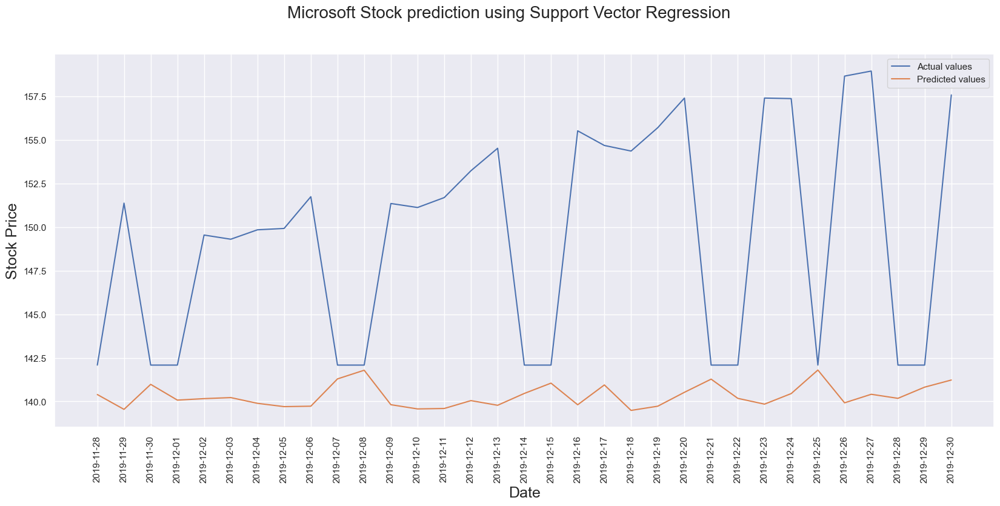

In [367]:
plt.figure(figsize=(20, 8))
plt.plot(tesla['Date'].tail(33), y_test, label = "Actual values")
plt.plot(tesla['Date'].tail(33), predict, label = "Predicted values")
plt.suptitle('Microsoft Stock prediction using Support Vector Regression', fontsize=20)
plt.xlabel('Date', fontsize=18)
plt.ylabel('Stock Price', fontsize=18)
plt.xticks(rotation = 90)
plt.legend()
plt.show()

XGBRegressor

In [411]:
from xgboost import XGBRegressor

Using XGBRegressor to predict Tesla stock prices

In [412]:
tesla_x = tesla.iloc[:, 1:5].values
tesla_y = tesla.iloc[:, 5].values

x_train, x_test, y_train, y_test = train_test_split(tesla_x, tesla_y, test_size=0.180,  shuffle= False)


pipeline = make_pipeline(StandardScaler(), XGBRegressor(alpha=1.0))
pipeline.fit(x_train, y_train)

predict = pipeline.predict(x_test)

In [413]:
print("Mean Absolute Error:", round(metrics.mean_absolute_error(y_test, predict), 4))
print("Mean Squared Error:", round(metrics.mean_squared_error(y_test, predict), 4))
print("Root Mean Squared Error:", round(np.sqrt(metrics.mean_squared_error(y_test, predict)), 4))
print("(R^2) Score:", round(metrics.r2_score(y_test, predict), 4))
print(f'Train Score : {pipeline.score(x_train, y_train) * 100:.2f}% and Test Score : {pipeline.score(x_test, y_test) * 100:.2f}% using xgboost Regressor.')
errors = abs(predict - y_test)
mape = 100 * (errors / y_test)
accuracy = 100 - np.mean(mape)
print('Accuracy:', round(accuracy, 2), '%.') 

Mean Absolute Error: 3.1331
Mean Squared Error: 18.6873
Root Mean Squared Error: 4.3229
(R^2) Score: -6.1146
Train Score : 99.20% and Test Score : -611.46% using xgboost Regressor.
Accuracy: 96.49 %.


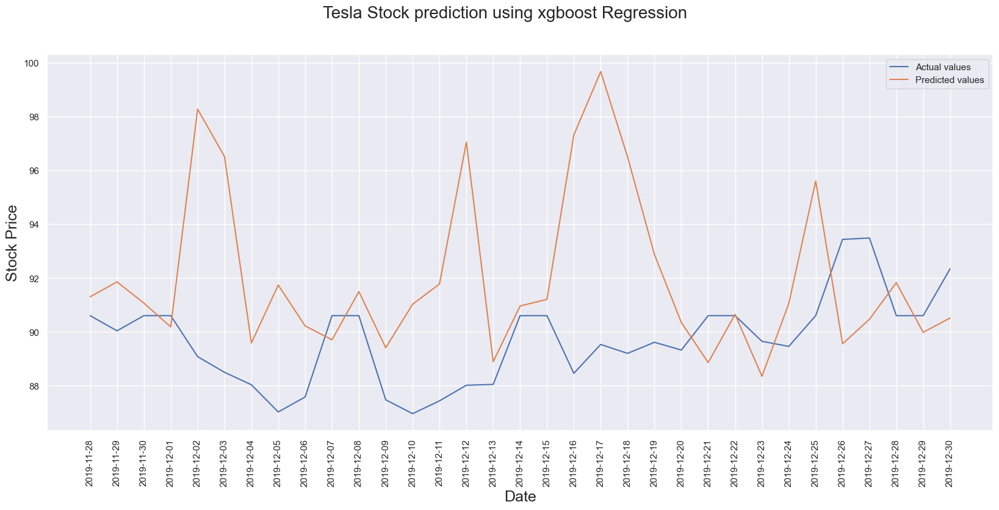

In [414]:
plt.figure(figsize=(20, 8))
plt.plot(tesla['Date'].tail(33), y_test, label = "Actual values")
plt.plot(tesla['Date'].tail(33), predict, label = "Predicted values")
plt.suptitle('Tesla Stock prediction using xgboost Regression', fontsize=20)
plt.xlabel('Date', fontsize=18)
plt.ylabel('Stock Price', fontsize=18)
plt.xticks(rotation = 90)
plt.legend()
plt.show()

Using XGBRegressor to predict Amazon stock prices

In [ ]:
amazon_x = amazon.iloc[:, 1:5].values
amazon_y = amazon.iloc[:, 5].values

x_train, x_test, y_train, y_test = train_test_split(amazon_x, amazon_y, test_size=0.180,  shuffle= False)


pipeline = make_pipeline(StandardScaler(), XGBRegressor(alpha=1.0))
pipeline.fit(x_train, y_train)

predict = pipeline.predict(x_test)

In [416]:
print("Mean Absolute Error:", round(metrics.mean_absolute_error(y_test, predict), 4))
print("Mean Squared Error:", round(metrics.mean_squared_error(y_test, predict), 4))
print("Root Mean Squared Error:", round(np.sqrt(metrics.mean_squared_error(y_test, predict)), 4))
print("(R^2) Score:", round(metrics.r2_score(y_test, predict), 4))
print(f'Train Score : {pipeline.score(x_train, y_train) * 100:.2f}% and Test Score : {pipeline.score(x_test, y_test) * 100:.2f}% using xgboost Regressor.')
errors = abs(predict - y_test)
mape = 100 * (errors / y_test)
accuracy = 100 - np.mean(mape)
print('Accuracy:', round(accuracy, 2), '%.') 

Mean Absolute Error: 3.1331
Mean Squared Error: 18.6873
Root Mean Squared Error: 4.3229
(R^2) Score: -6.1146
Train Score : 99.20% and Test Score : -611.46% using xgboost Regressor.
Accuracy: 96.49 %.


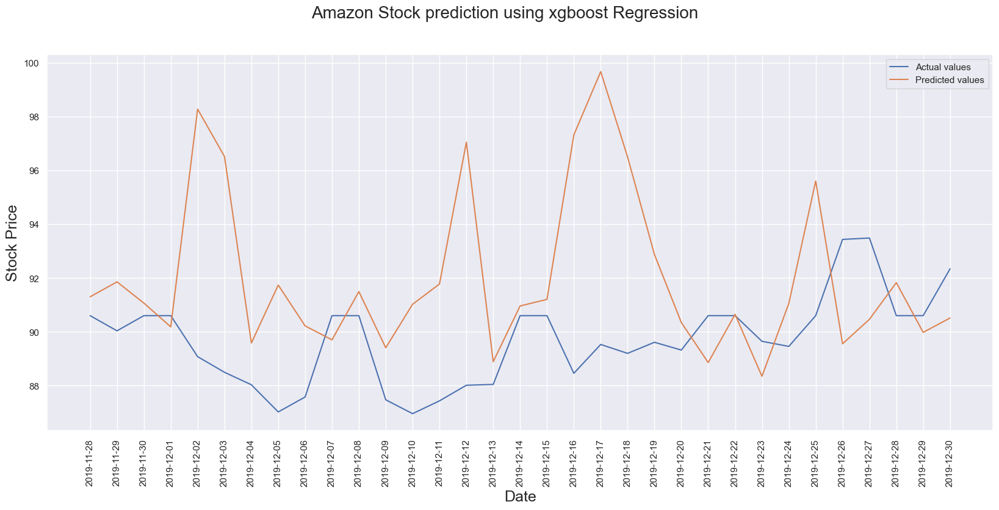

In [417]:
plt.figure(figsize=(20, 8))
plt.plot(tesla['Date'].tail(33), y_test, label = "Actual values")
plt.plot(tesla['Date'].tail(33), predict, label = "Predicted values")
plt.suptitle('Amazon Stock prediction using xgboost Regression', fontsize=20)
plt.xlabel('Date', fontsize=18)
plt.ylabel('Stock Price', fontsize=18)
plt.xticks(rotation = 90)
plt.legend()
plt.show()

Using XGBRegressor to predict Apple stock prices

In [419]:
apple_x = apple.iloc[:, 1:5].values
apple_y = apple.iloc[:, 5].values

x_train, x_test, y_train, y_test = train_test_split(apple_x, apple_y, test_size=0.180,  shuffle= False)


pipeline = make_pipeline(StandardScaler(), XGBRegressor(alpha=1.0))
pipeline.fit(x_train, y_train)

predict = pipeline.predict(x_test)

In [420]:
print("Mean Absolute Error:", round(metrics.mean_absolute_error(y_test, predict), 4))
print("Mean Squared Error:", round(metrics.mean_squared_error(y_test, predict), 4))
print("Root Mean Squared Error:", round(np.sqrt(metrics.mean_squared_error(y_test, predict)), 4))
print("(R^2) Score:", round(metrics.r2_score(y_test, predict), 4))
print(f'Train Score : {pipeline.score(x_train, y_train) * 100:.2f}% and Test Score : {pipeline.score(x_test, y_test) * 100:.2f}% using Xgboost Regressor.')
errors = abs(predict - y_test)
mape = 100 * (errors / y_test)
accuracy = 100 - np.mean(mape)
print('Accuracy:', round(accuracy, 2), '%.') 

Mean Absolute Error: 8.8616
Mean Squared Error: 119.1743
Root Mean Squared Error: 10.9167
(R^2) Score: -3.0216
Train Score : 92.83% and Test Score : -302.16% using Xgboost Regressor.
Accuracy: 87.02 %.


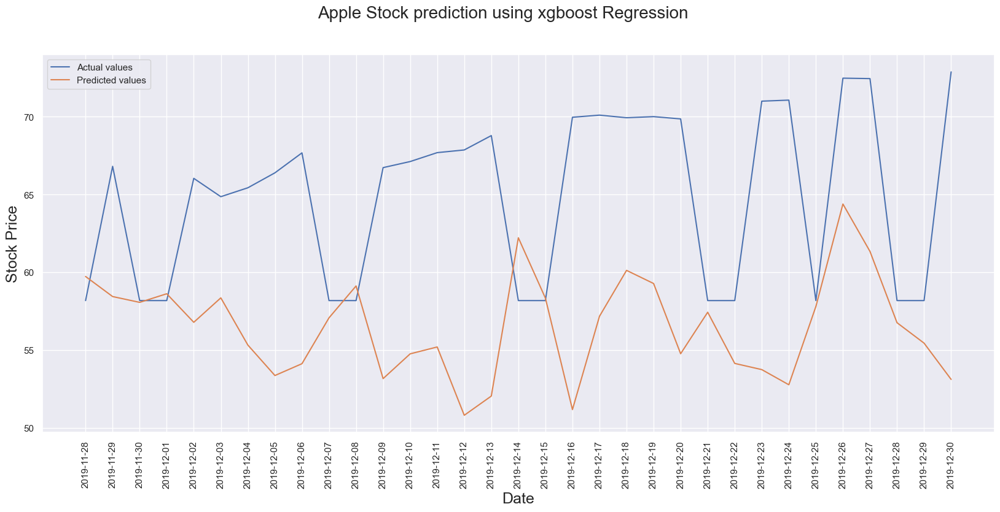

In [421]:
plt.figure(figsize=(20, 8))
plt.plot(tesla['Date'].tail(33), y_test, label = "Actual values")
plt.plot(tesla['Date'].tail(33), predict, label = "Predicted values")
plt.suptitle('Apple Stock prediction using xgboost Regression', fontsize=20)
plt.xlabel('Date', fontsize=18)
plt.ylabel('Stock Price', fontsize=18)
plt.xticks(rotation = 90)
plt.legend()
plt.show()

Using XGBRegressor to predict Google stock prices

In [422]:
google_x = google.iloc[:, 1:5].values
google_y = google.iloc[:, 5].values

x_train, x_test, y_train, y_test = train_test_split(google_x, google_y, test_size=0.180,  shuffle= False)

pipeline = make_pipeline(StandardScaler(), XGBRegressor(alpha=1.0))
pipeline.fit(x_train, y_train)

predict = pipeline.predict(x_test)

In [423]:
print("Mean Absolute Error:", round(metrics.mean_absolute_error(y_test, predict), 4))
print("Mean Squared Error:", round(metrics.mean_squared_error(y_test, predict), 4))
print("Root Mean Squared Error:", round(np.sqrt(metrics.mean_squared_error(y_test, predict)), 4))
print("(R^2) Score:", round(metrics.r2_score(y_test, predict), 4))
print(f'Train Score : {pipeline.score(x_train, y_train) * 100:.2f}% and Test Score : {pipeline.score(x_test, y_test) * 100:.2f}% using xgboost Regressor.')
errors = abs(predict - y_test)
mape = 100 * (errors / y_test)
accuracy = 100 - np.mean(mape)
print('Accuracy:', round(accuracy, 2), '%.') 

Mean Absolute Error: 2.9043
Mean Squared Error: 14.9644
Root Mean Squared Error: 3.8684
(R^2) Score: -1.2056
Train Score : 97.92% and Test Score : -120.56% using xgboost Regressor.
Accuracy: 95.66 %.


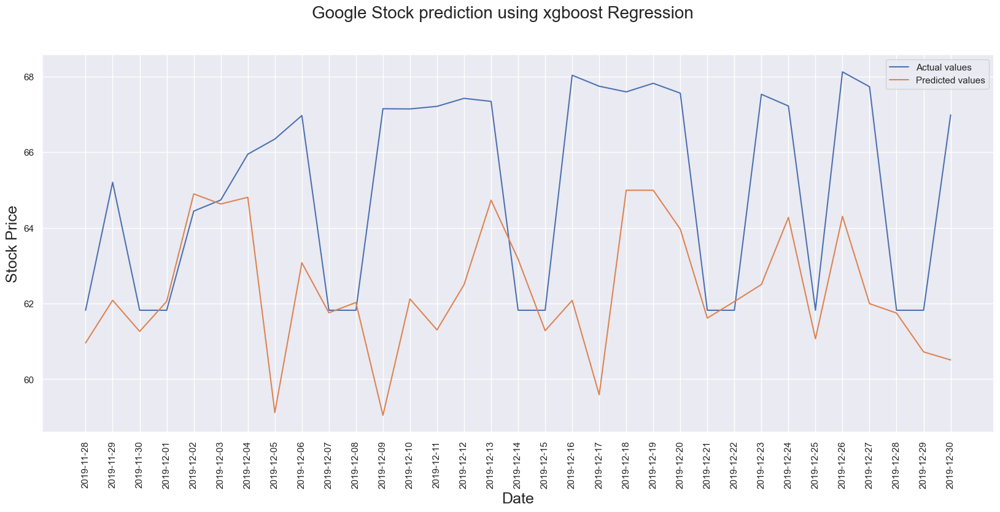

In [424]:
plt.figure(figsize=(20, 8))
plt.plot(tesla['Date'].tail(33), y_test, label = "Actual values")
plt.plot(tesla['Date'].tail(33), predict, label = "Predicted values")
plt.suptitle('Google Stock prediction using xgboost Regression', fontsize=20)
plt.xlabel('Date', fontsize=18)
plt.ylabel('Stock Price', fontsize=18)
plt.xticks(rotation = 90)
plt.legend()
plt.show()

Using XGBRegressor to predict Microsoft stock prices

In [425]:
microsoft_x = microsoft.iloc[:, 1:5].values
microsoft_y = microsoft.iloc[:, 5].values

x_train, x_test, y_train, y_test = train_test_split(microsoft_x, microsoft_y, test_size=0.180,  shuffle= False)

pipeline = make_pipeline(StandardScaler(), XGBRegressor(alpha=1.0))
pipeline.fit(x_train, y_train)

predict = pipeline.predict(x_test)

In [426]:
print("Mean Absolute Error:", round(metrics.mean_absolute_error(y_test, predict), 4))
print("Mean Squared Error:", round(metrics.mean_squared_error(y_test, predict), 4))
print("Root Mean Squared Error:", round(np.sqrt(metrics.mean_squared_error(y_test, predict)), 4))
print("(R^2) Score:", round(metrics.r2_score(y_test, predict), 4))
print(f'Train Score : {pipeline.score(x_train, y_train) * 100:.2f}% and Test Score : {pipeline.score(x_test, y_test) * 100:.2f}% using Linear Regressor.')
errors = abs(predict - y_test)
mape = 100 * (errors / y_test)
accuracy = 100 - np.mean(mape)
print('Accuracy:', round(accuracy, 2), '%.') 

Mean Absolute Error: 9.1249
Mean Squared Error: 129.8847
Root Mean Squared Error: 11.3967
(R^2) Score: -2.3747
Train Score : 99.25% and Test Score : -237.47% using Linear Regressor.
Accuracy: 94.06 %.


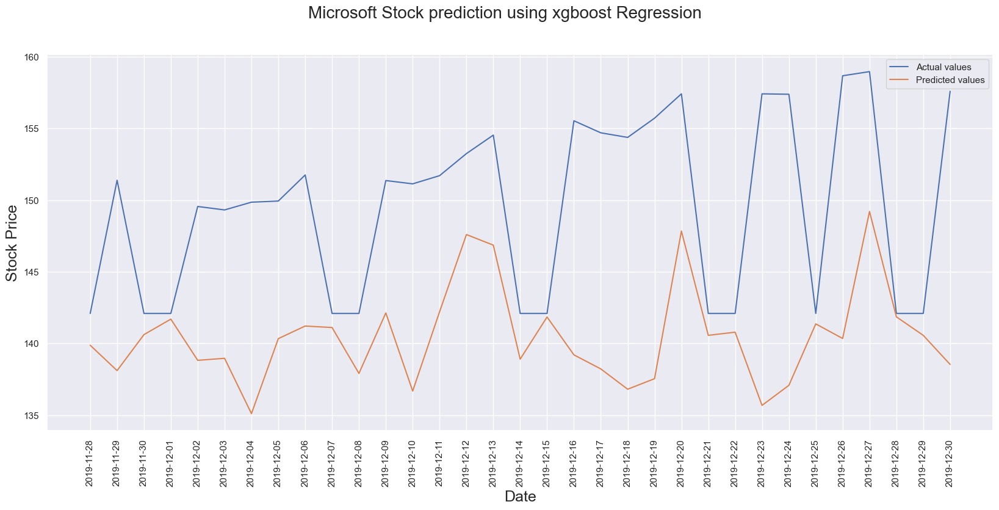

In [427]:
plt.figure(figsize=(20, 8))
plt.plot(tesla['Date'].tail(33), y_test, label = "Actual values")
plt.plot(tesla['Date'].tail(33), predict, label = "Predicted values")
plt.suptitle('Microsoft Stock prediction using xgboost Regression', fontsize=20)
plt.xlabel('Date', fontsize=18)
plt.ylabel('Stock Price', fontsize=18)
plt.xticks(rotation = 90)
plt.legend()
plt.show()

Even though all the regression models have very high accuracy, R^2 values are in negative. Negative R^2 means the fitting of the regression model is worse than the mean value. Since the volatily of the stock prices is less, regression models were able to predict with high accuracy but with very less precision. Hence, stock price can't be influenced by the sentiment of the twitter. 

# N Machine Learning Models , N Visualizations and N additional work

In our project, we have 9-10 visualizations in EDA, 2 Machine learning models and Sentimental Analysis.

# Results
Our hypothesis is that Social media especially Twitter has influence on stock market prices, but the data has proven otherwise. This could also be true or because of the data we had which were the top 5 stocks which barely have any volatilty.
<br>
 $\;\;\;\;\;\;$From the EDA, we have analysed that there is no correaltion between stock price and (volume of tweets, engagement index and sentiment score). 
<br>
 $\;\;\;\;\;\;$ In Machine learning We used k-means to cluster tweets based on the vader score.Clustering only functions effectively when the clusters are around the same size and cannot tolerate outliers. Because of this, employing kmeans to cluster tweets did not provide any useful information.
<br>
 $\;\;\;\;\;\;$   From the regression models we have observed that R2 values are negative even though every regression model has a very high level of accuracy. The regression model's fit is worse than the mean value if the R2 value is negative. Regression models were able to forecast stock prices with high accuracy but very little precision since stock prices are not as volatile. The sentiment expressed on Twitter cannot, therefore, affect stock price.


# References

Dataset: https://www.kaggle.com/datasets/omermetinn/tweets-about-the-top-companies-from-2015-to-2020
<br>
https://neptune.ai/blog/sentiment-analysis-python-textblob-vs-vader-vs-flair
<br>
https://stackabuse.com/random-forest-algorithm-with-python-and-scikit-learn/
<br>
https://machinelearningmastery.com/ridge-regression-with-python/
<br>
https://stackabuse.com/random-forest-algorithm-with-python-and-scikit-learn/
